# test7 otsu 2 classes white background

In [1]:
import keras
import tensorflow as tf
from keras import layers
from keras import ops

import os
import numpy as np
from glob import glob
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt

# For data preprocessing
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io

# Creating Dataset

In [43]:
CLASSES = [
    'фон',
    'яблоко',
    'цветок'
]

colormap = [
    [0, 0, 0],
    [212, 6, 99],
    [121, 133, 255]
]


IMAGE_SIZE = 512
BATCH_SIZE = 4
NUM_CLASSES = len(CLASSES)
DATA_DIR = "C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white"
NUM_TRAIN_IMAGES = 2334
NUM_VAL_IMAGES = 666
NUM_TEST_IMAGES = 333

train_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[:NUM_TRAIN_IMAGES]
train_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[:NUM_TRAIN_IMAGES]
val_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
val_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
test_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
test_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]


def read_image(image_path, mask=False):
    image = tf_io.read_file(image_path)
    if mask:
        image = tf_image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf_image.decode_png(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    return image


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list):
    dataset = tf_data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset


train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>


# Building the DeepLabV3+ model

In [3]:

def convolution_block(
    block_input,
    num_filters=256,
    kernel_size=3,
    dilation_rate=1,
    use_bias=False,
):
    x = layers.Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer=keras.initializers.HeNormal(),
    )(block_input)
    x = layers.BatchNormalization()(x)
    return ops.nn.relu(x)


def DilatedSpatialPyramidPooling(dspp_input):
    dims = dspp_input.shape
    x = layers.AveragePooling2D(pool_size=(dims[-3], dims[-2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)
    out_pool = layers.UpSampling2D(
        size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]),
        interpolation="bilinear",
    )(x)

    out_1 = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6 = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)
    return output


In [4]:

def DeeplabV3Plus(image_size, num_classes):
    model_input = keras.Input(shape=(image_size, image_size, 3))
    preprocessed = keras.applications.resnet50.preprocess_input(model_input)
    resnet50 = keras.applications.ResNet50(
        weights="imagenet", include_top=False, input_tensor=preprocessed
    )
    x = resnet50.get_layer("conv4_block6_2_relu").output
    x = DilatedSpatialPyramidPooling(x)

    input_a = layers.UpSampling2D(
        size=(image_size // 4 // x.shape[1], image_size // 4 // x.shape[2]),
        interpolation="bilinear",
    )(x)
    input_b = resnet50.get_layer("conv2_block3_2_relu").output
    input_b = convolution_block(input_b, num_filters=48, kernel_size=1)

    x = layers.Concatenate(axis=-1)([input_a, input_b])
    x = convolution_block(x)
    x = convolution_block(x)
    x = layers.UpSampling2D(
        size=(image_size // x.shape[1], image_size // x.shape[2]),
        interpolation="bilinear",
    )(x)
    model_output = layers.Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)
    return keras.Model(inputs=model_input, outputs=model_output)


model = DeeplabV3Plus(image_size=IMAGE_SIZE, num_classes=NUM_CLASSES)
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape              ┃     Param # ┃ Connected to                   ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)      │ (None, 512, 512, 3)       │           0 │ -                              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item (GetItem)            │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item_1 (GetItem)          │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item_2 (GetItem)          │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ stack (Stack)                 │ (None, 512, 512, 3)       │           0 │ get_item[0][0],                │
│                               │                           │             │ get_item_1[0][0],              │
│                               │                           │             │ get_item_2[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ add (Add)                     │ (None, 512, 512, 3)       │           0 │ stack[0][0]                    │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_pad (ZeroPadding2D)     │ (None, 518, 518, 3)       │           0 │ add[0][0]                      │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_conv (Conv2D)           │ (None, 256, 256, 64)      │       9,472 │ conv1_pad[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_bn (BatchNormalization) │ (None, 256, 256, 64)      │         256 │ conv1_conv[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_relu (Activation)       │ (None, 256, 256, 64)      │           0 │ conv1_bn[0][0]                 │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ pool1_pad (ZeroPadding2D)     │ (None, 258, 258, 64)      │           0 │ conv1_relu[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ pool1_pool (MaxPooling2D)     │ (None, 128, 128, 64)      │           0 │ pool1_pad[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_conv (Conv2D)  │ (None, 128, 128, 64)      │       4,160 │ pool1_pool[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_bn             │ (None, 128, 128, 64)      │         256 │ conv2_block1_1_conv[0][0]      │
│ (BatchNormalization)          │                           │             │                                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_relu           │ (None, 128, 128, 64)      │           0 │ conv2_block1_1_bn[0][0]        │
│ (Activation)                  │                           │             │                                │
├───────────────────────────────┼───────────────────────────┼─────────────┼─

 Total params: 11,852,867 (45.22 MB)

 Trainable params: 11,820,131 (45.09 MB)

 Non-trainable params: 32,736 (127.88 KB)

# Training

In [5]:
class UpdatedIoU(tf.keras.metrics.IoU):
  def __init__(self,
               y_true=None,
               y_pred=None,
               num_classes=None,
               target_class_ids=None,
               name=None,
               dtype=None):
    super(UpdatedIoU, self).__init__(num_classes = num_classes, target_class_ids=target_class_ids, name=name, dtype=dtype)

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_pred = tf.math.argmax(y_pred, axis=-1)
    return super().update_state(y_true, y_pred, sample_weight)

In [6]:
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss=loss,
    metrics=["accuracy", 
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0, 1, 2], name='MIoU'),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0], name=CLASSES[0]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[1], name=CLASSES[1]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[2], name=CLASSES[2]),
            ],
)

history = model.fit(train_dataset, validation_data=val_dataset, epochs=5)

Epoch 1/5
350/350 ━━━━━━━━━━━━━━━━━━━━ 4248s 12s/step - MIoU: 0.7348 - accuracy: 0.9276 - loss: 0.1987 - фон: 0.9608 - цветок: 0.7321 - яблоко: 0.5115 - val_MIoU: 0.6538 - val_accuracy: 0.9119 - val_loss: 0.3587 - val_фон: 0.9595 - val_цветок: 0.6073 - val_яблоко: 0.3946
Epoch 2/5
350/350 ━━━━━━━━━━━━━━━━━━━━ 4202s 12s/step - MIoU: 0.9072 - accuracy: 0.9817 - loss: 0.0510 - фон: 0.9950 - цветок: 0.9057 - яблоко: 0.8210 - val_MIoU: 0.3713 - val_accuracy: 0.8024 - val_loss: 1.6974 - val_фон: 0.8265 - val_цветок: 0.2095 - val_яблоко: 0.0778
Epoch 3/5
350/350 ━━━━━━━━━━━━━━━━━━━━ 4217s 12s/step - MIoU: 0.9271 - accuracy: 0.9858 - loss: 0.0393 - фон: 0.9957 - цветок: 0.9265 - яблоко: 0.8590 - val_MIoU: 0.3032 - val_accuracy: 0.4405 - val_loss: 1.4158 - val_фон: 0.2702 - val_цветок: 0.5019 - val_яблоко: 0.1375
Epoch 4/5
350/350 ━━━━━━━━━━━━━━━━━━━━ 4325s 12s/step - MIoU: 0.9559 - accuracy: 0.9913 - loss: 0.0227 - фон: 0.9966 - цветок: 0.9551 - яблоко: 0.9159 - val_MIoU: 0.9556 - val_accuracy

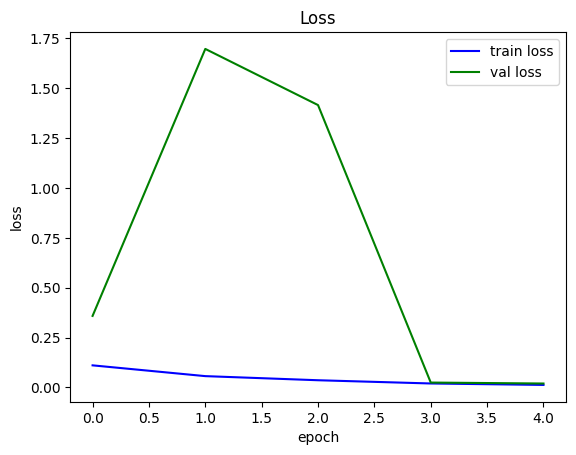

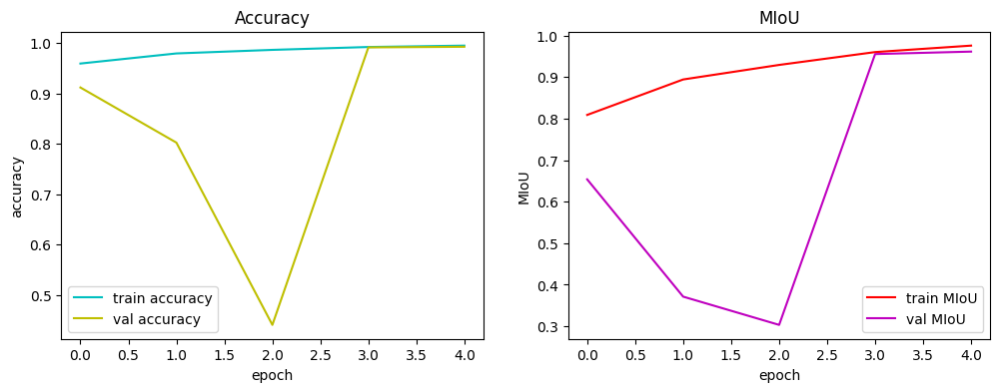

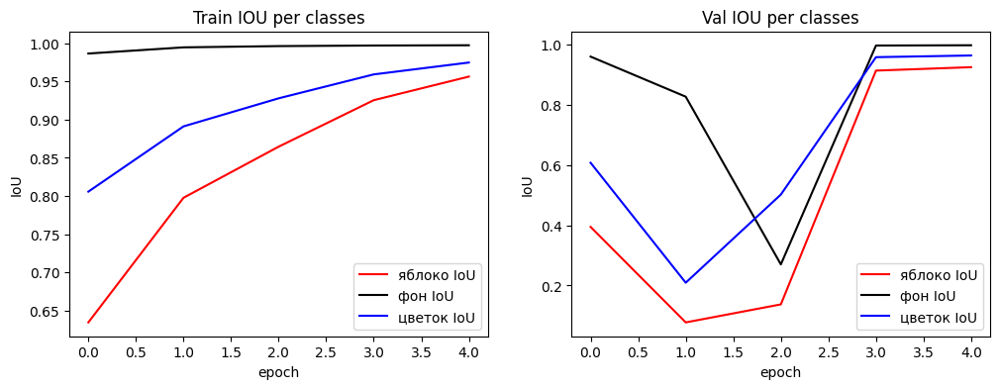

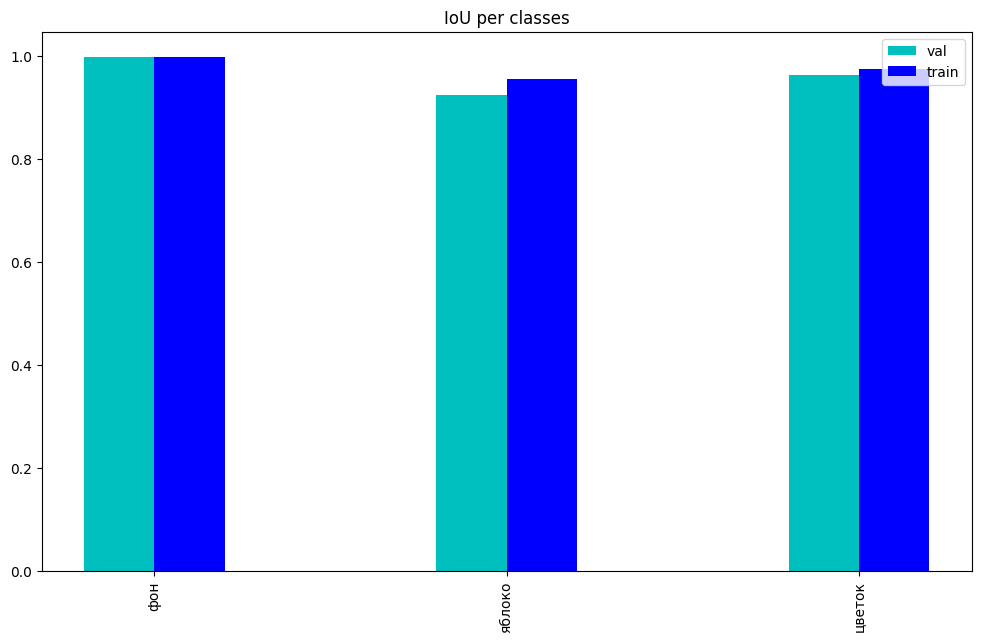

In [30]:
plt.plot(history.history["loss"], label = 'train loss', color = 'b')
plt.plot(history.history["val_loss"], label = 'val loss', color = 'g')
plt.title("Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.legend()
plt.show()


fig, axs = plt.subplots(1, 2, figsize=(12, 4))
axs[0].plot(history.history["accuracy"], label = 'train accuracy', color = 'c')
axs[0].plot(history.history["val_accuracy"], label = 'val accuracy', color = 'y')
axs[0].set_title("Accuracy")
axs[0].set_ylabel("accuracy")
axs[0].set_xlabel("epoch")
axs[0].legend()
axs[1].plot(history.history["MIoU"], label = 'train MIoU', color = 'r')
axs[1].plot(history.history["val_MIoU"], label = 'val MIoU', color = 'm')
axs[1].set_title("MIoU")
axs[1].set_ylabel("MIoU")
axs[1].set_xlabel("epoch")
axs[1].legend()
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(12, 4))
axs[0].plot(history.history["яблоко"], label = 'яблоко IoU', color = 'r')
axs[0].plot(history.history["фон"], label = 'фон IoU', color = 'black')
axs[0].plot(history.history["цветок"], label = 'цветок IoU', color = 'b')
axs[0].set_title("Train IOU per classes")
axs[0].set_ylabel("IoU")
axs[0].set_xlabel("epoch")
axs[0].legend()
axs[1].plot(history.history["val_яблоко"], label = 'яблоко IoU', color = 'r')
axs[1].plot(history.history["val_фон"], label = 'фон IoU', color = 'black')
axs[1].plot(history.history["val_цветок"], label = 'цветок IoU', color = 'b')
axs[1].set_title("Val IOU per classes")
axs[1].set_ylabel("IoU")
axs[1].set_xlabel("epoch")
axs[1].legend()
plt.show()

# print(history.history["яблоко"][4])

train_values = [history.history["фон"][4], history.history["яблоко"][4], history.history["цветок"][4]]
val_values = [history.history["val_фон"][4], history.history["val_яблоко"][4], history.history["val_цветок"][4]]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (12, 7))
plt.title('IoU per classes')
plt.bar(x_axis-0.1, val_values, width=0.2, color='c', label='val')
plt.bar(x_axis+0.1, train_values, width=0.2, color='b', label='train')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.legend()
plt.show()

# Inference using Colormap Overlay



In [31]:
def infer(model, image_tensor):
    predictions = model.predict(np.expand_dims((image_tensor), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    return predictions


def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)

    # print(mask[250])

    
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l][0]
        g[idx] = colormap[l][1]
        b[idx] = colormap[l][2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb


def get_overlay(image, colored_mask):
    image = keras.utils.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay


def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            axes[i].imshow(keras.utils.array_to_img(display_list[i]))
        else:
            axes[i].imshow(display_list[i])
    plt.show()


def _predictions(images_list, colormap, mod, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(CLASSES))

        name = image_file.split("\\")[2]
        if mod == "train":
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/train_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/train_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/train_pred/{name}"
        elif  mod == "val":
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/val_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/val_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/val_pred/{name}"
        else: 
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/test_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/test_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/test_pred/{name}"
        pred_map = cv2.cvtColor(prediction_colormap, cv2.COLOR_BGR2RGB)
        cv2.imwrite(path, pred_map)
            

def plot_predictions(images_list, colormap, mod, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(CLASSES))

        # name = image_file.split("\\")[2]
        # if mod == "train":
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/train_pred/{name}"
        # elif  mod == "val":
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/val_pred/{name}"
        # else: 
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_white/test_pred/{name}"
        # pred_map = cv2.cvtColor(prediction_colormap, cv2.COLOR_BGR2RGB)
        # cv2.imwrite(path, pred_map)
            
        overlay = get_overlay(image_tensor, prediction_colormap)
        plot_samples_matplotlib(
            [image_tensor, overlay, prediction_colormap], figsize=(18, 14)
        )

## Inference on Train Images

In [34]:
# _predictions(train_images, colormap, "train", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


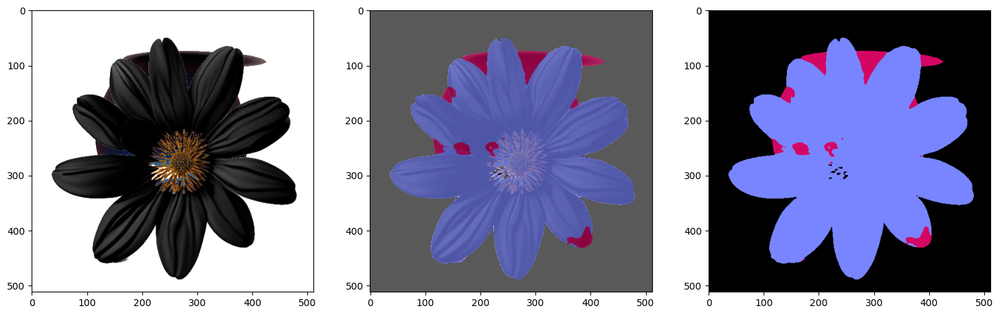

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


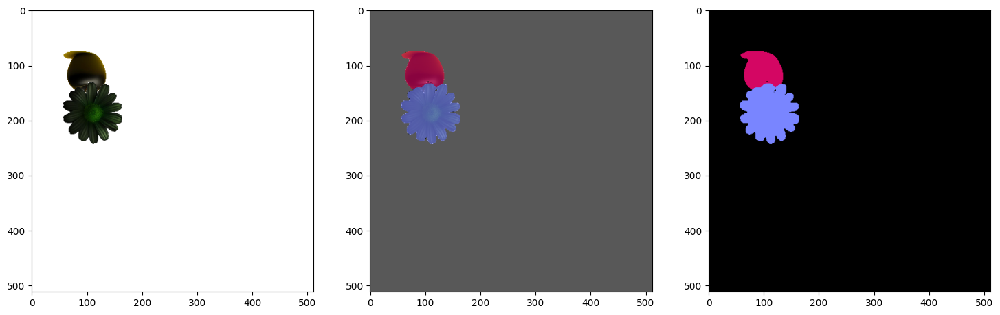

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


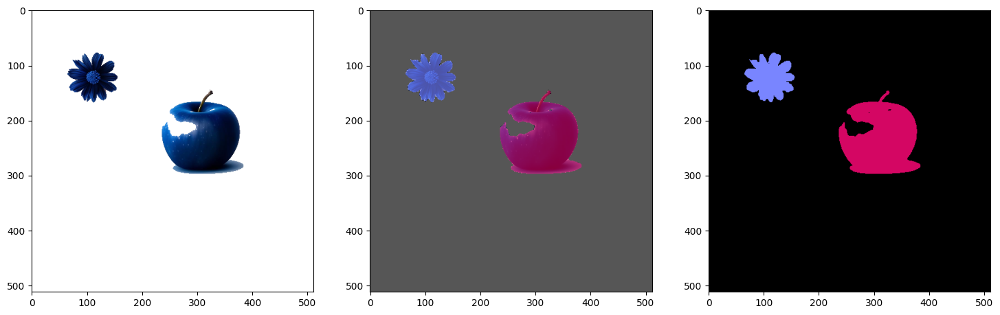

In [35]:
plot_predictions(train_images[:3], colormap, "train", model=model)

## Inference on Validation Images

In [36]:
# _predictions(val_images, colormap, "val", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


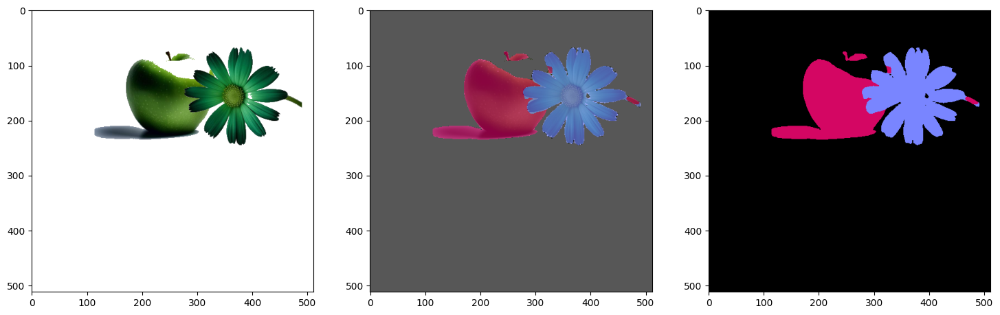

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


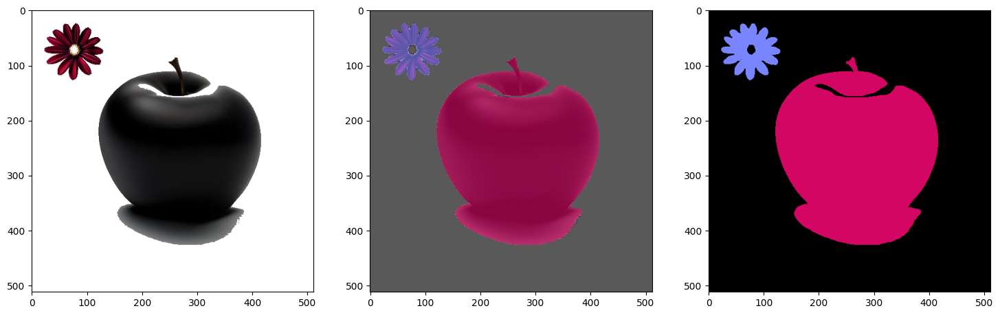

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


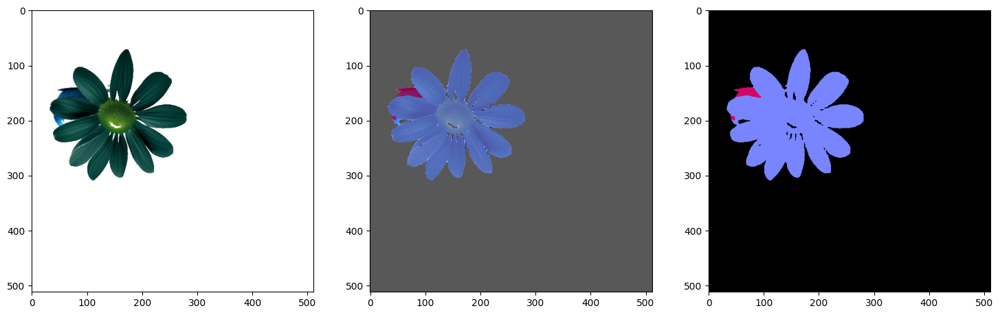

In [37]:
plot_predictions(val_images[:3], colormap, "val", model=model)

## Inference on Testing Images

In [46]:
_predictions(test_images, colormap, "test", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


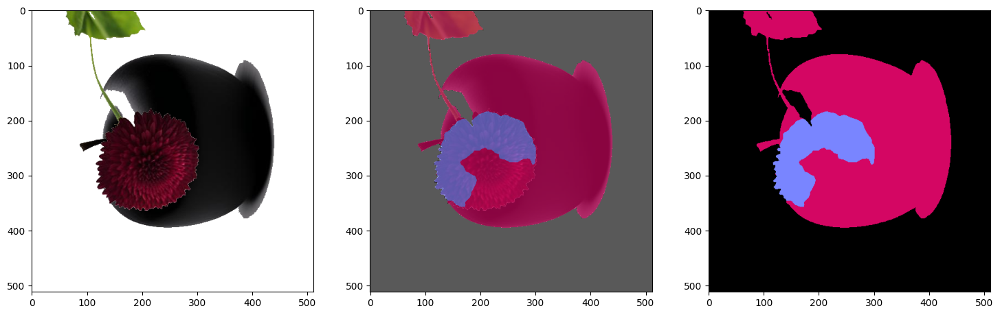

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


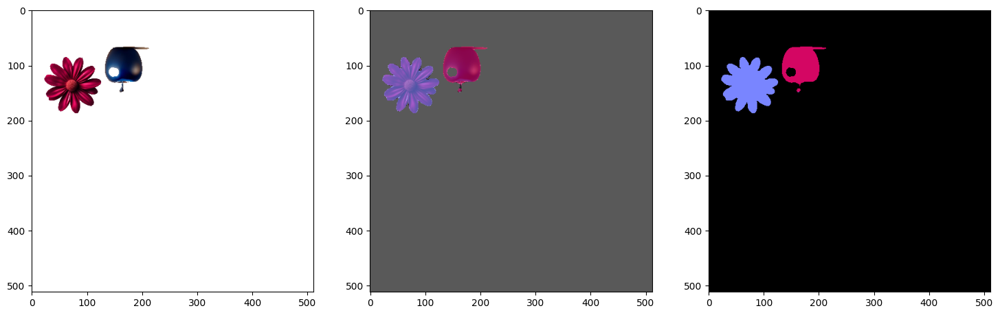

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


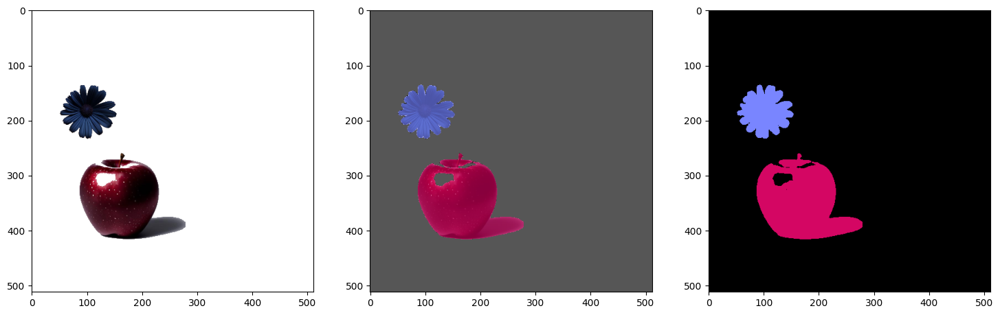

In [47]:
plot_predictions(test_images[10:13], colormap, "test", model=model)

# IOU for test

In [48]:
test_pred = sorted(glob(os.path.join(DATA_DIR, "test_pred/*")))
mask_color = sorted(glob(os.path.join(DATA_DIR, "mask_color/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]

333
333


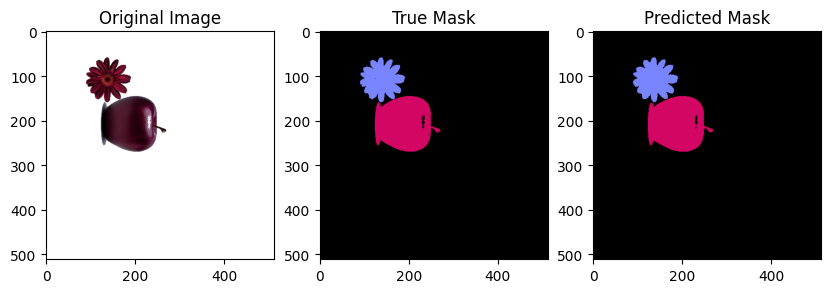

image0 IOU_apple: 0.987610091058367
image0 IOU_flower: 0.9809172052939366
image0 IOU_back: 0.9988620011462452


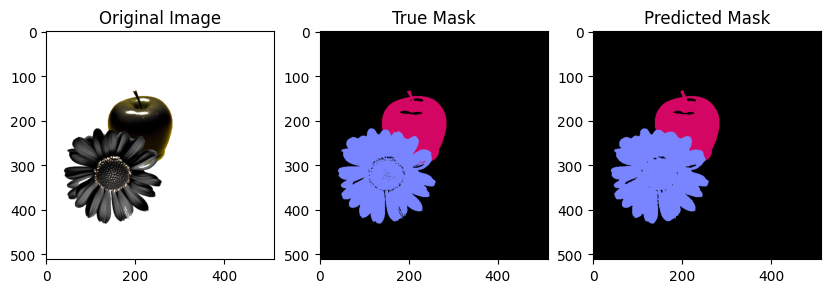

image1 IOU_apple: 0.9745578653428483
image1 IOU_flower: 0.9727194439318447
image1 IOU_back: 0.9964130874086049


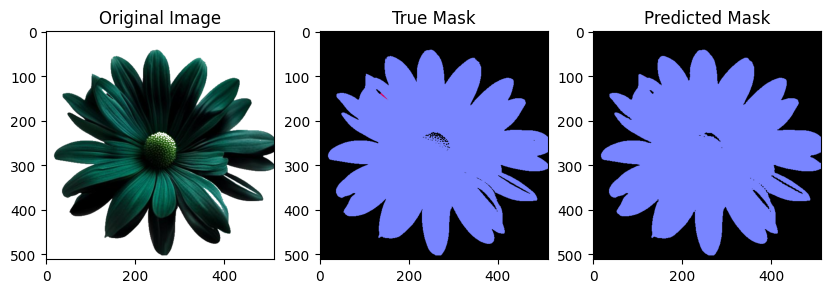

image2 IOU_apple: 1
image2 IOU_flower: 0.9937101945167273
image2 IOU_back: 0.9933710668464526


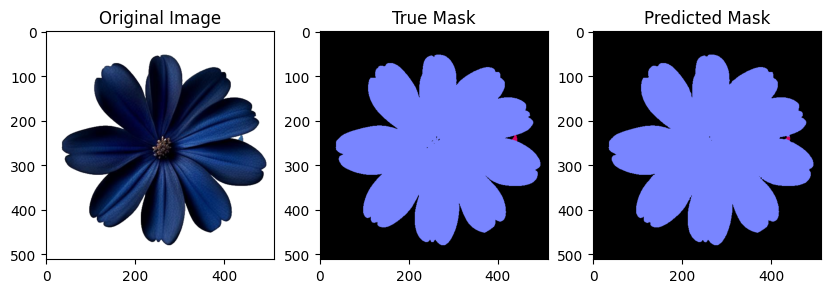

image3 IOU_apple: 0.59
image3 IOU_flower: 0.9972650262202502
image3 IOU_back: 0.9977607466104205


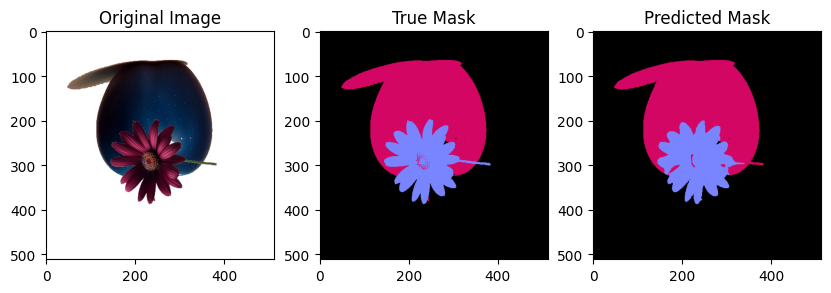

image4 IOU_apple: 0.9584356182203478
image4 IOU_flower: 0.906092599767532
image4 IOU_back: 0.9986423584173778


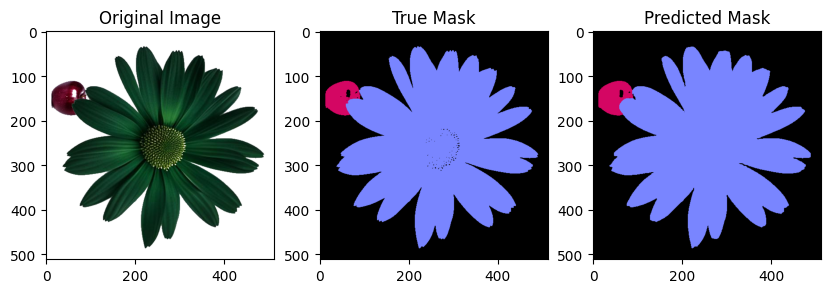

image5 IOU_apple: 0.9682812884189821
image5 IOU_flower: 0.9939439366966772
image5 IOU_back: 0.9948959032907992


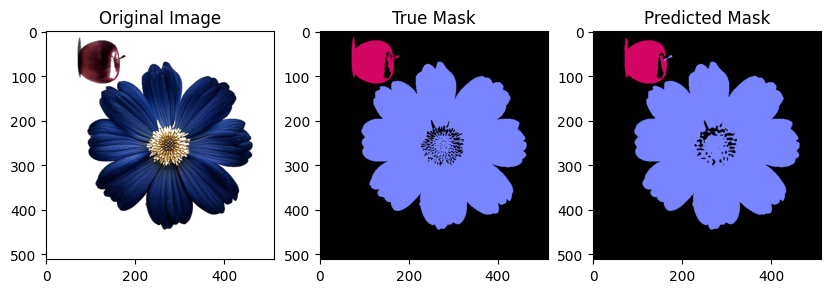

image6 IOU_apple: 0.9644047460338622
image6 IOU_flower: 0.9784804567413263
image6 IOU_back: 0.986874376899882


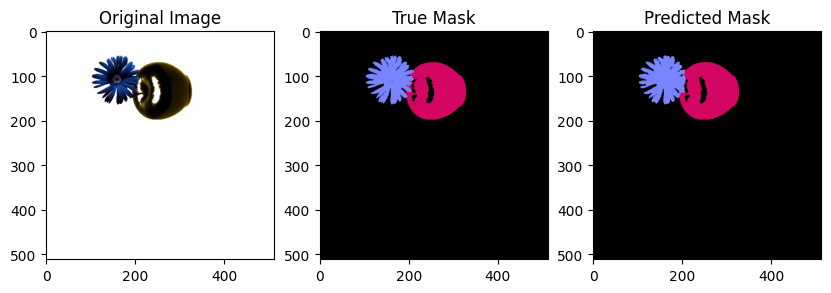

image7 IOU_apple: 0.9726332537788385
image7 IOU_flower: 0.9339212847176517
image7 IOU_back: 0.9979558867165607


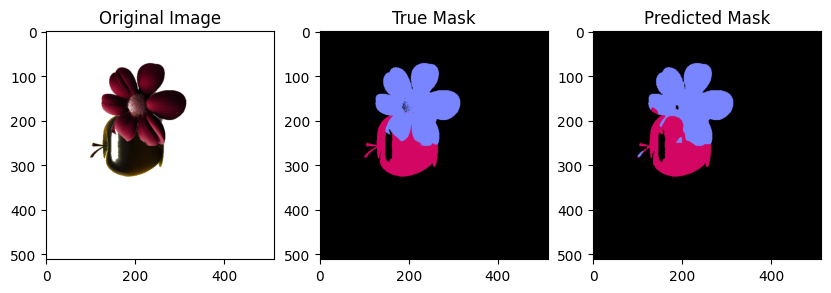

image8 IOU_apple: 0.7766216875304829
image8 IOU_flower: 0.8787264067736814
image8 IOU_back: 0.9982617386958694


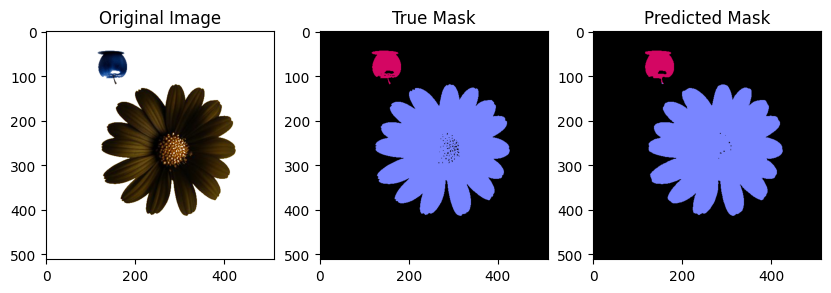

image9 IOU_apple: 0.9646302250803859
image9 IOU_flower: 0.9905392309840185
image9 IOU_back: 0.9965496572323718


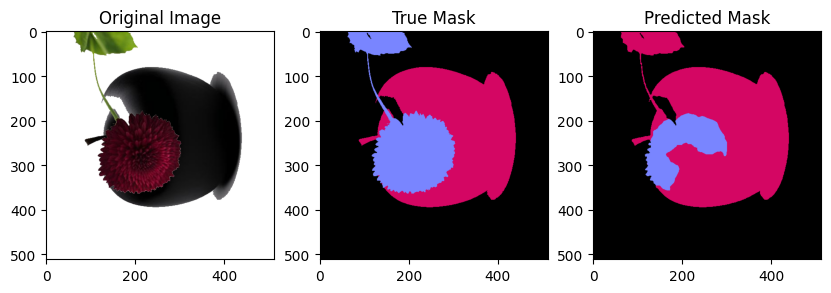

image10 IOU_apple: 0.7660500978786305
image10 IOU_flower: 0.47015923179773916
image10 IOU_back: 0.9978118289269232


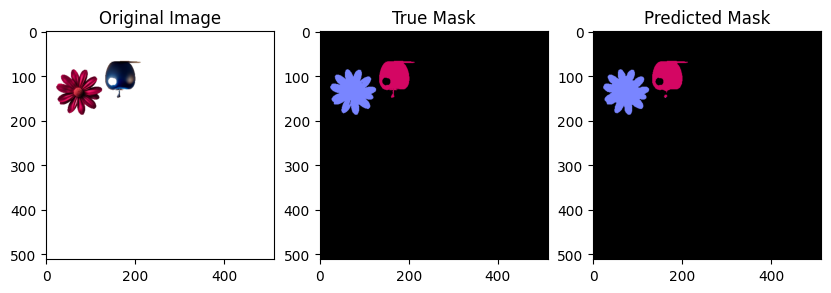

image11 IOU_apple: 0.9768968233132056
image11 IOU_flower: 0.9799969692377632
image11 IOU_back: 0.9991347661288722


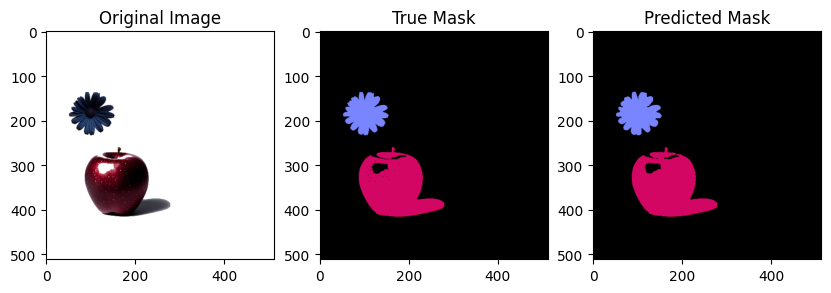

image12 IOU_apple: 0.9892279090113736
image12 IOU_flower: 0.9743195448254651
image12 IOU_back: 0.9984687674840251


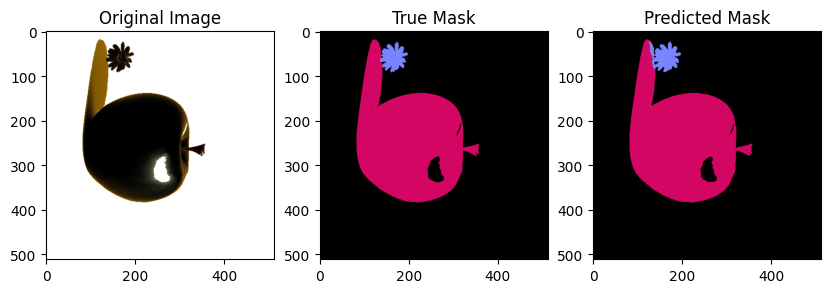

image13 IOU_apple: 0.9884357427092869
image13 IOU_flower: 0.8435923309788093
image13 IOU_back: 0.9980812466082642


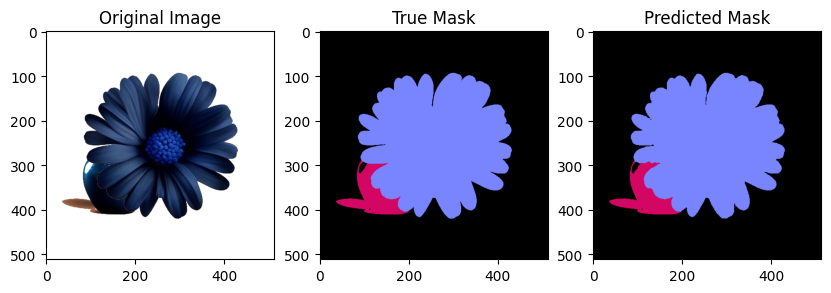

image14 IOU_apple: 0.9599039954821403
image14 IOU_flower: 0.9936253617790369
image14 IOU_back: 0.9978131636041365


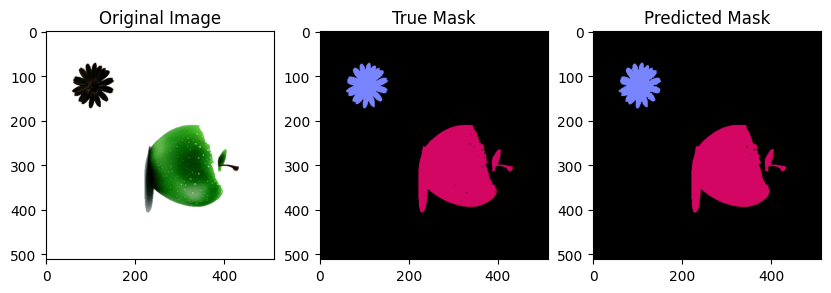

image15 IOU_apple: 0.9904162211397568
image15 IOU_flower: 0.9704627502461437
image15 IOU_back: 0.9981749062585146


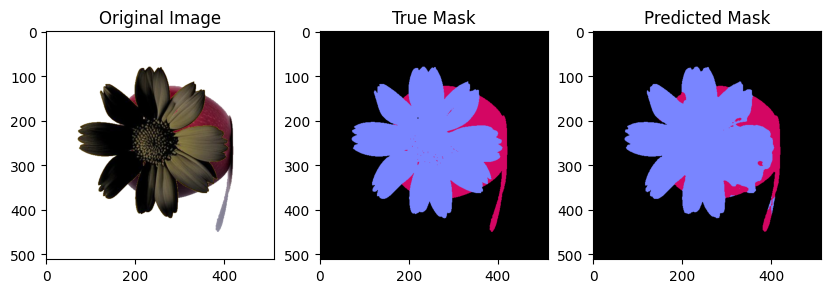

image16 IOU_apple: 0.7931693989071038
image16 IOU_flower: 0.9644491688073936
image16 IOU_back: 0.998273543806809


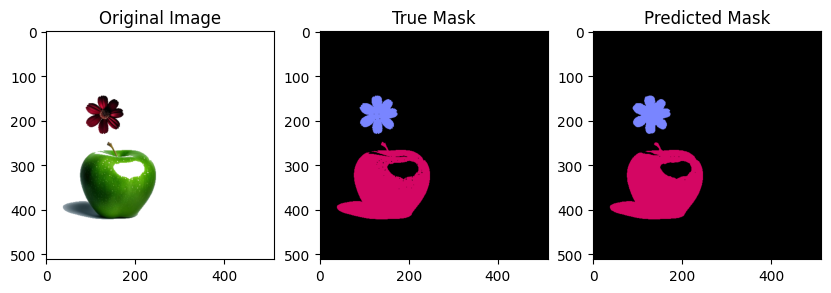

image17 IOU_apple: 0.9865287356321839
image17 IOU_flower: 0.9754640494986132
image17 IOU_back: 0.9982720284607077


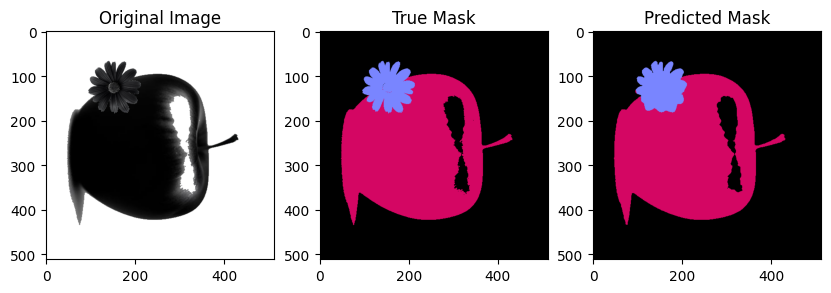

image18 IOU_apple: 0.9875768426186168
image18 IOU_flower: 0.9344670261302365
image18 IOU_back: 0.9970735262300869


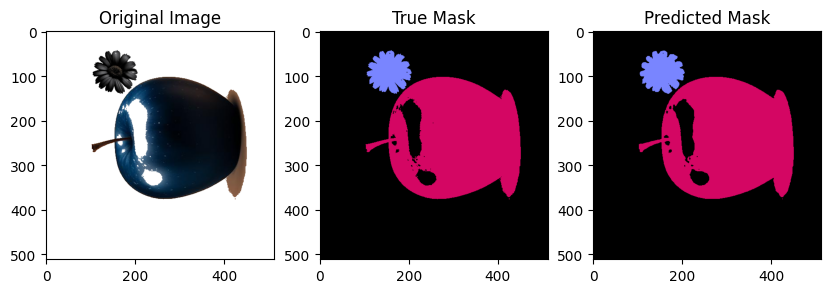

image19 IOU_apple: 0.9924961377179431
image19 IOU_flower: 0.9740817535545023
image19 IOU_back: 0.9966200956341604


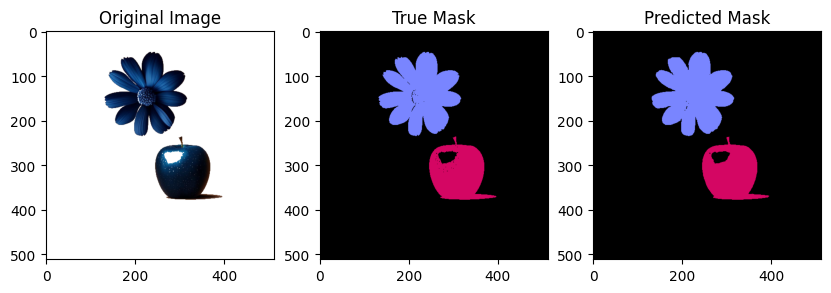

image20 IOU_apple: 0.9874253379440427
image20 IOU_flower: 0.9862561598625615
image20 IOU_back: 0.997962812548021


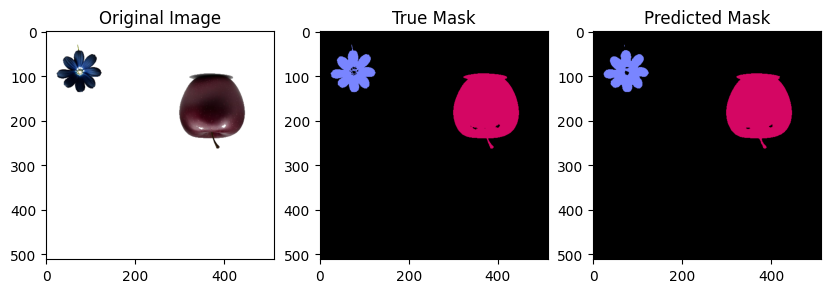

image21 IOU_apple: 0.995386838594931
image21 IOU_flower: 0.9617890473674943
image21 IOU_back: 0.9987435765350353


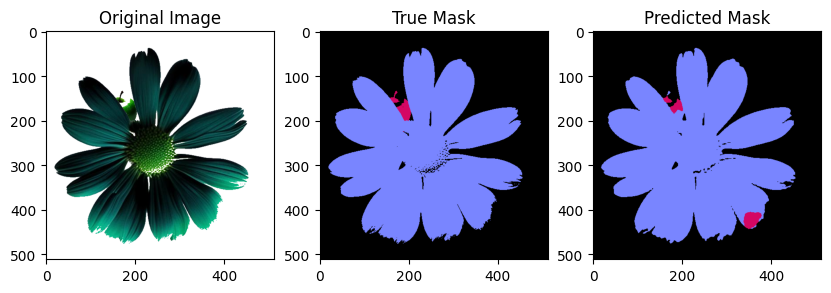

image22 IOU_apple: 0.28896672504378285
image22 IOU_flower: 0.9736318277080648
image22 IOU_back: 0.9899318942009323


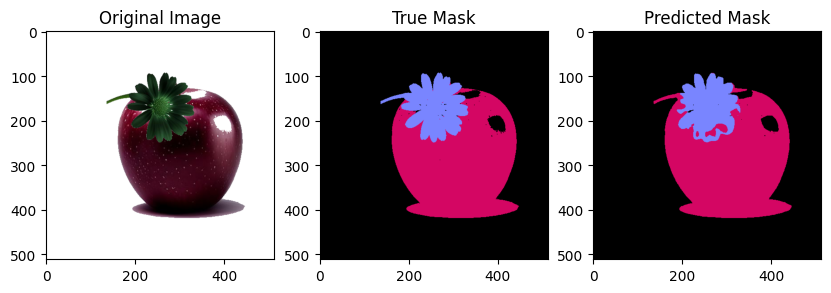

image23 IOU_apple: 0.9489204387670092
image23 IOU_flower: 0.8277446597118728
image23 IOU_back: 0.9978119190357821


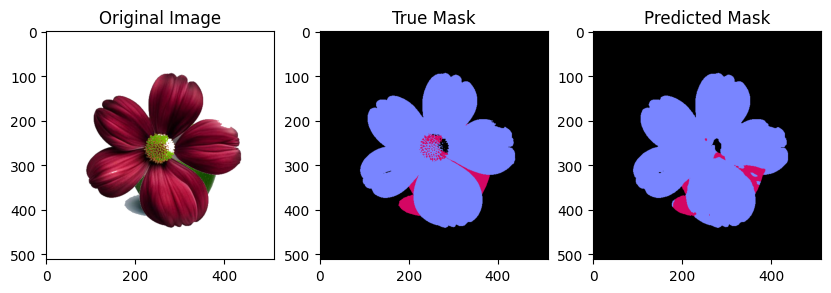

image24 IOU_apple: 0.48591121021690653
image24 IOU_flower: 0.9619028340080972
image24 IOU_back: 0.9978547233722244


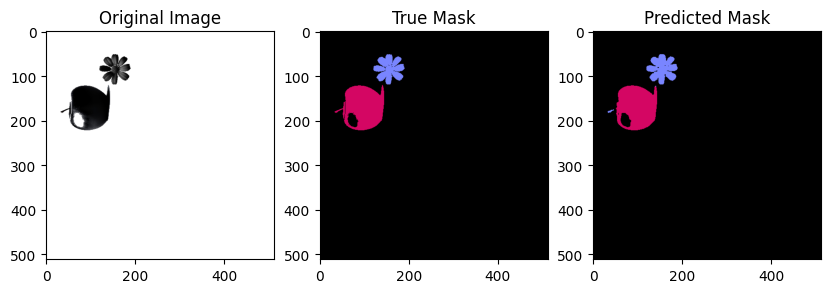

image25 IOU_apple: 0.970348204570185
image25 IOU_flower: 0.9342321604735284
image25 IOU_back: 0.9987149078620667


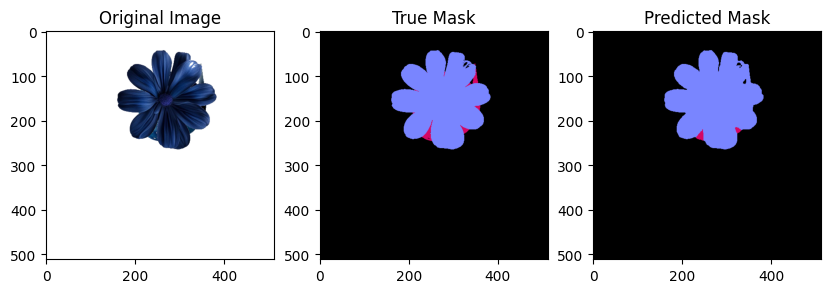

image26 IOU_apple: 0.4018369690011481
image26 IOU_flower: 0.9786605989791526
image26 IOU_back: 0.999002061244678


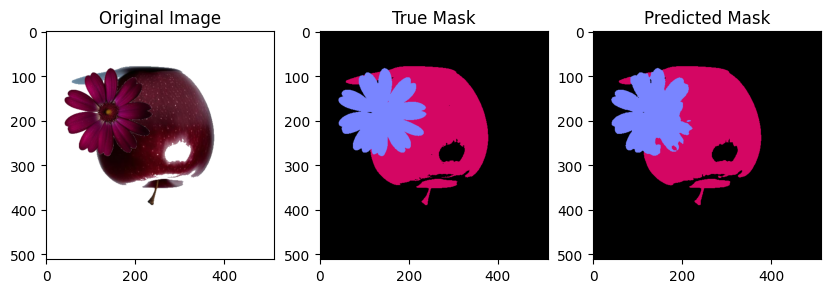

image27 IOU_apple: 0.9328237252496934
image27 IOU_flower: 0.8892216748768473
image27 IOU_back: 0.9975603353766811


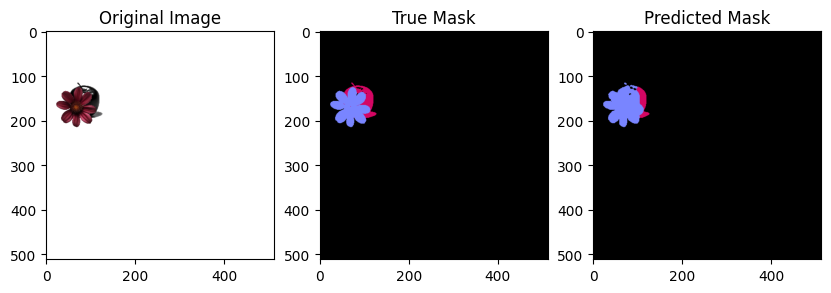

image28 IOU_apple: 0.5517941773865944
image28 IOU_flower: 0.8729085083659666
image28 IOU_back: 0.9994292639068059


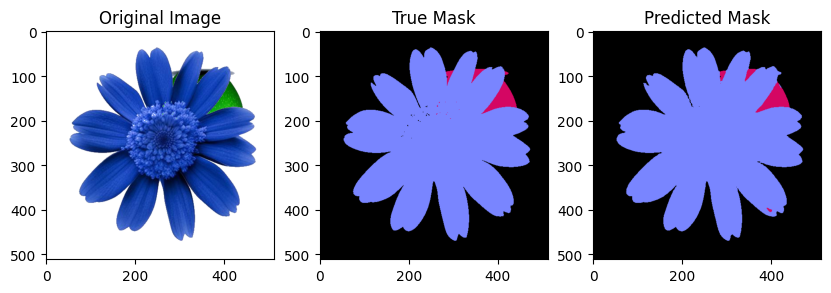

image29 IOU_apple: 0.8715565881181546
image29 IOU_flower: 0.9926602863927466
image29 IOU_back: 0.9968613482088851


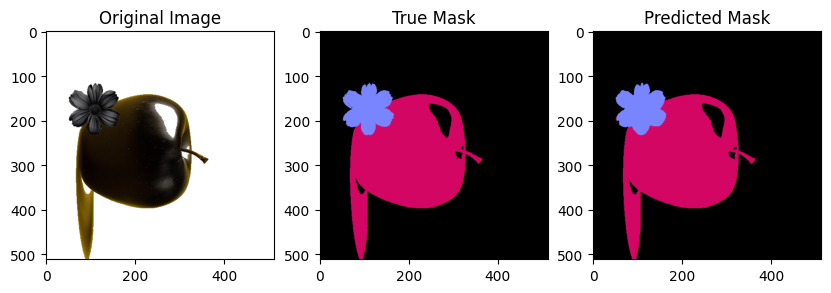

image30 IOU_apple: 0.9909832310088885
image30 IOU_flower: 0.9622950819672131
image30 IOU_back: 0.9982363847394522


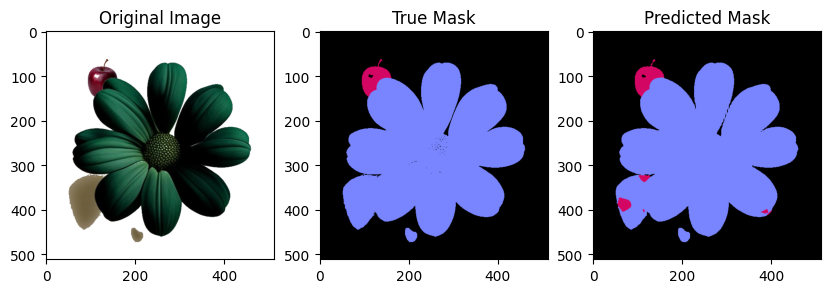

image31 IOU_apple: 0.6777717094483888
image31 IOU_flower: 0.9855254579983183
image31 IOU_back: 0.9967843366073454


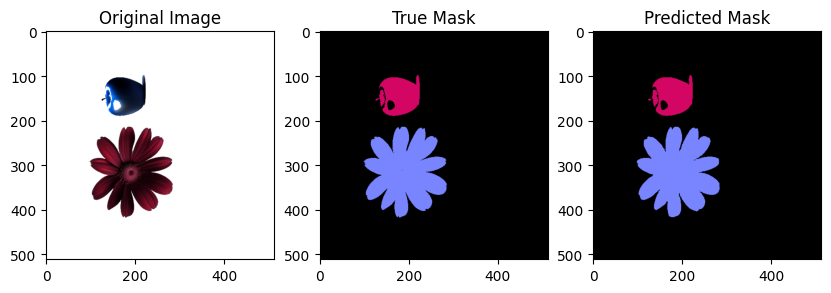

image32 IOU_apple: 0.9744849445324881
image32 IOU_flower: 0.9883811316123225
image32 IOU_back: 0.9980805396918512


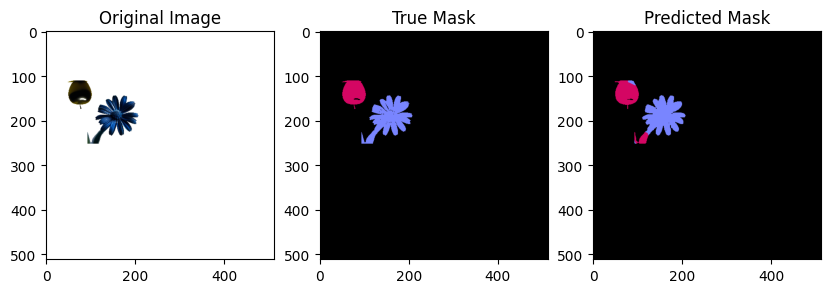

image33 IOU_apple: 0.7815096952908587
image33 IOU_flower: 0.8644122906844416
image33 IOU_back: 0.9986417857564662


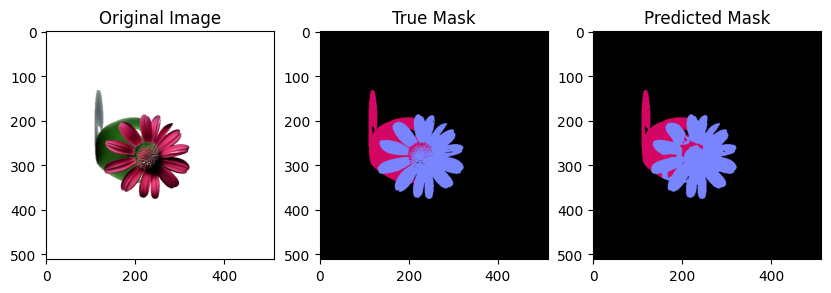

image34 IOU_apple: 0.8269759655625971
image34 IOU_flower: 0.9276883919643669
image34 IOU_back: 0.998680670973048


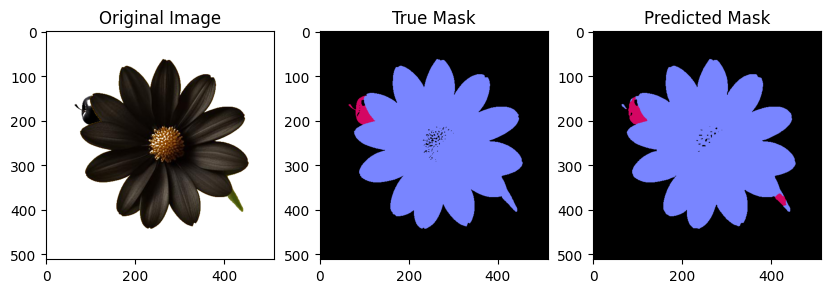

image35 IOU_apple: 0.6891246684350133
image35 IOU_flower: 0.9868426794675976
image35 IOU_back: 0.9956670964247658


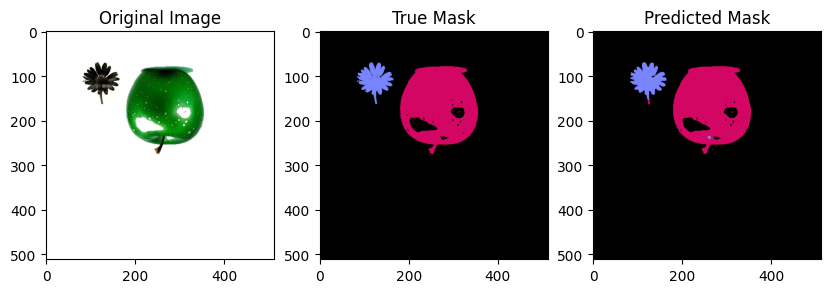

image36 IOU_apple: 0.9833722287047841
image36 IOU_flower: 0.9223153084539223
image36 IOU_back: 0.9976962253866594


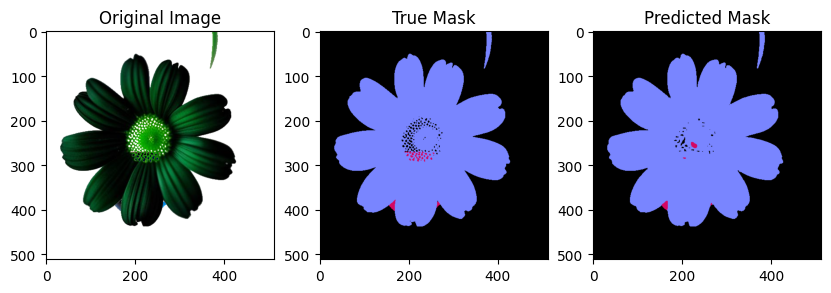

image37 IOU_apple: 0.20780711825487944
image37 IOU_flower: 0.9814903478836653
image37 IOU_back: 0.992949079378937


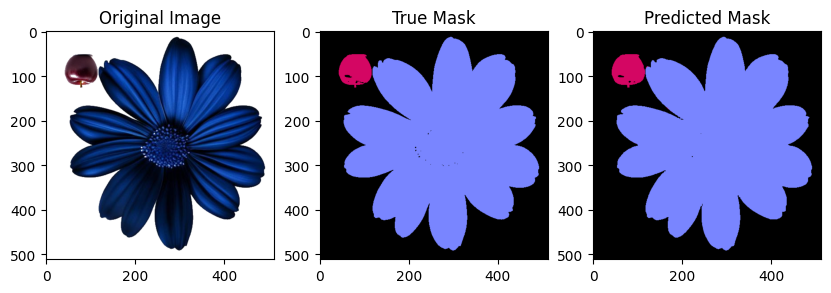

image38 IOU_apple: 0.971890372452565
image38 IOU_flower: 0.9971437470089106
image38 IOU_back: 0.9962909475445284


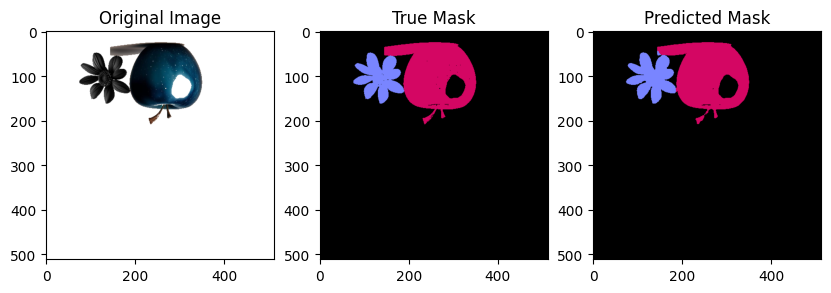

image39 IOU_apple: 0.9832823844096293
image39 IOU_flower: 0.9669062796690628
image39 IOU_back: 0.9982418557809659


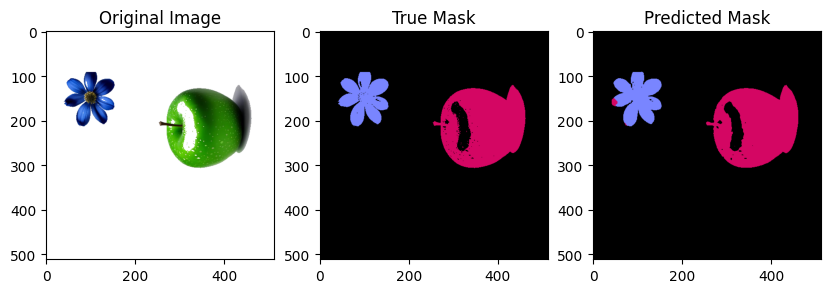

image40 IOU_apple: 0.9746653734238603
image40 IOU_flower: 0.9497648812937264
image40 IOU_back: 0.9967405761086416


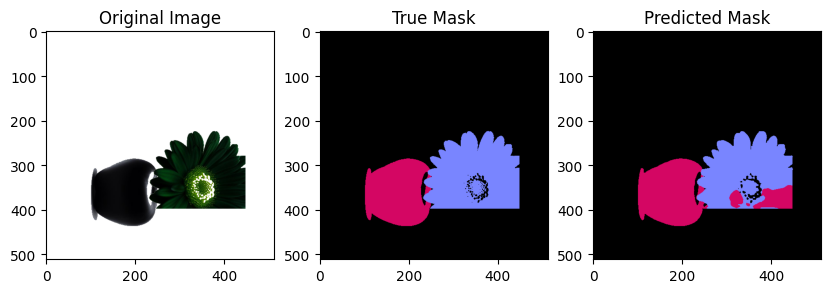

image41 IOU_apple: 0.8000992287222047
image41 IOU_flower: 0.8346472609662422
image41 IOU_back: 0.9968416310188991


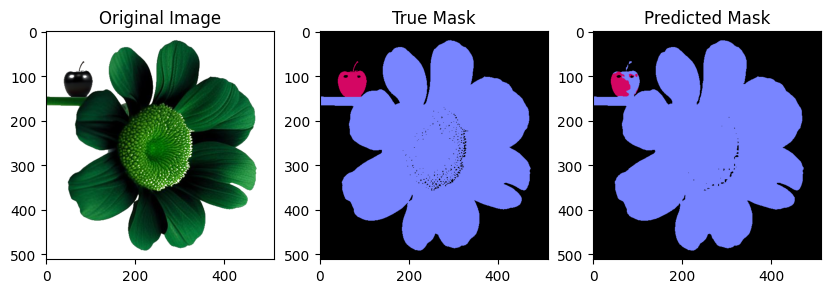

image42 IOU_apple: 0.5615885820663977
image42 IOU_flower: 0.9818412069956841
image42 IOU_back: 0.990504977229678


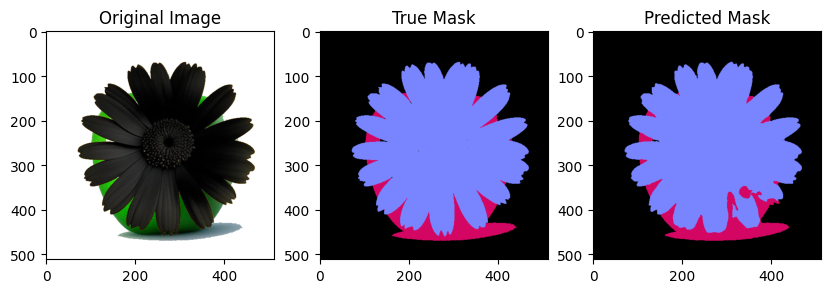

image43 IOU_apple: 0.7942973523421588
image43 IOU_flower: 0.9715875833613203
image43 IOU_back: 0.99676201854542


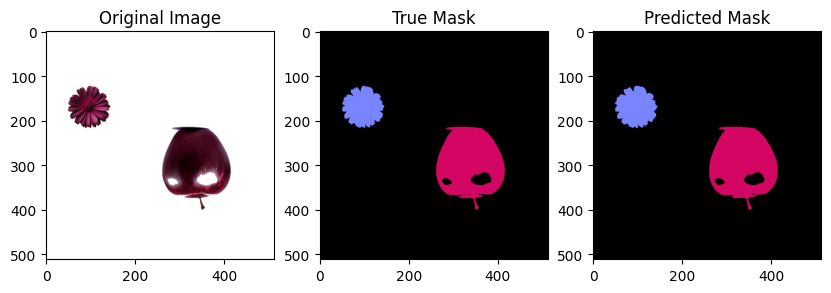

image44 IOU_apple: 0.9885251969753054
image44 IOU_flower: 0.9740279698785923
image44 IOU_back: 0.9983720773305442


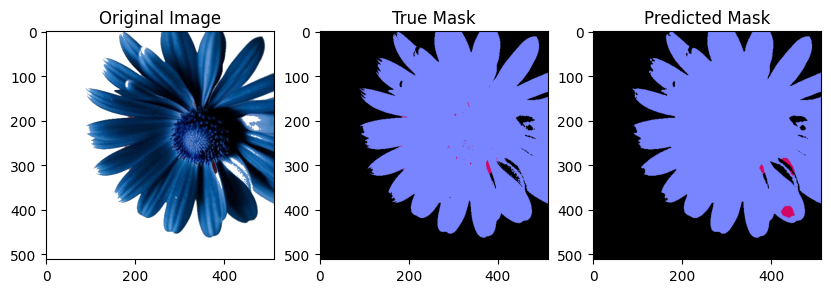

image45 IOU_apple: 0.10777957860615883
image45 IOU_flower: 0.9847693616064211
image45 IOU_back: 0.9908622130991499


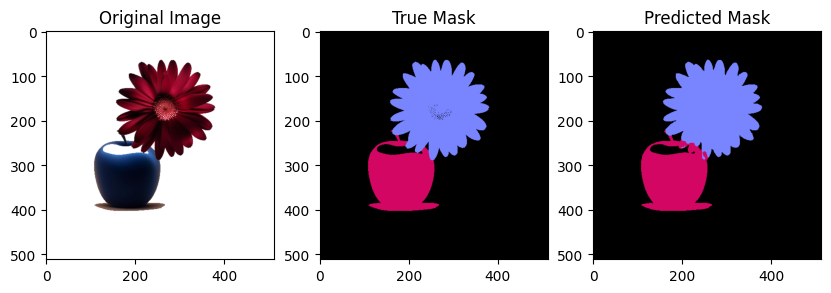

image46 IOU_apple: 0.9521298809772395
image46 IOU_flower: 0.9674077143956662
image46 IOU_back: 0.9975863543497886


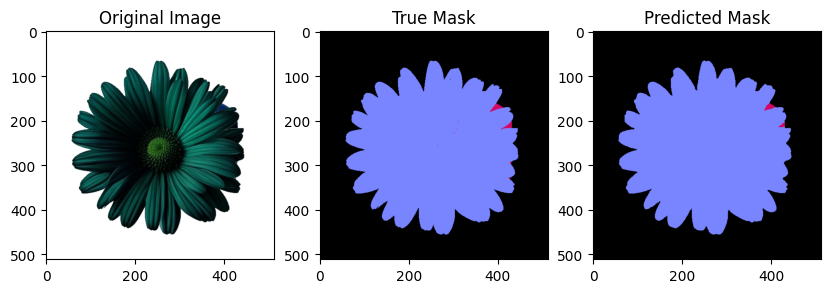

image47 IOU_apple: 0.623059866962306
image47 IOU_flower: 0.9946504023909235
image47 IOU_back: 0.9972547254725472


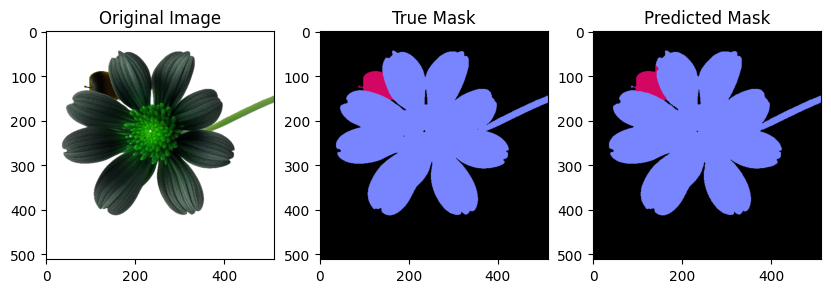

image48 IOU_apple: 0.9304123711340206
image48 IOU_flower: 0.994624294303695
image48 IOU_back: 0.9978423672996121


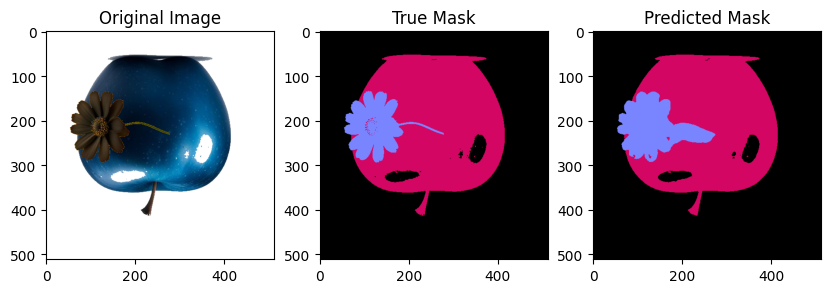

image49 IOU_apple: 0.9394737192016701
image49 IOU_flower: 0.7651991614255765
image49 IOU_back: 0.9977625152097065


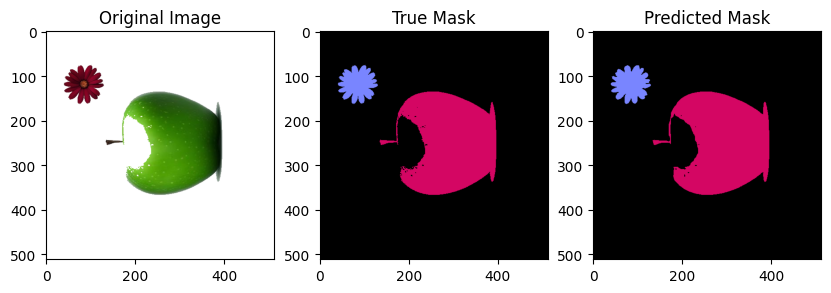

image50 IOU_apple: 0.9892941389947378
image50 IOU_flower: 0.9673265423793965
image50 IOU_back: 0.9973372551348043


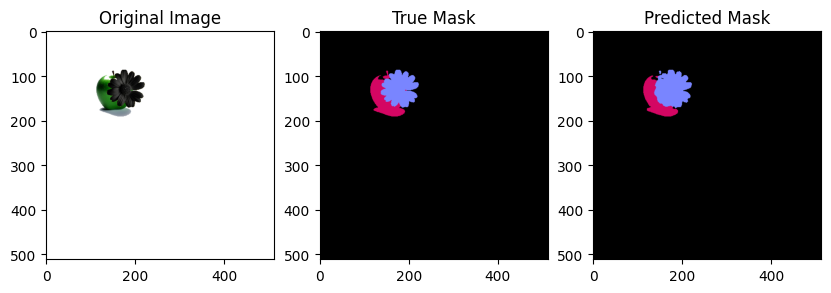

image51 IOU_apple: 0.8751954957772912
image51 IOU_flower: 0.9250857796416317
image51 IOU_back: 0.999346919505862


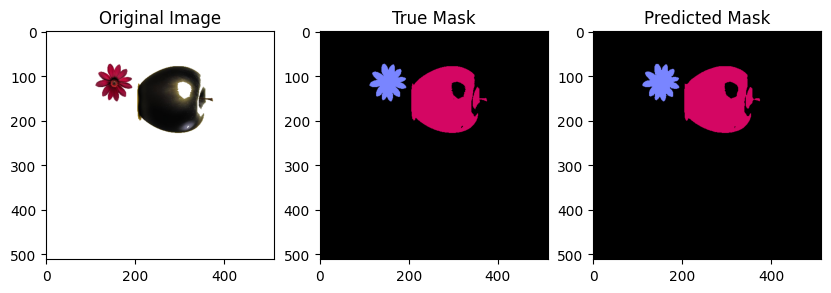

image52 IOU_apple: 0.9901463963963963
image52 IOU_flower: 0.9772616136919315
image52 IOU_back: 0.9988859420856162


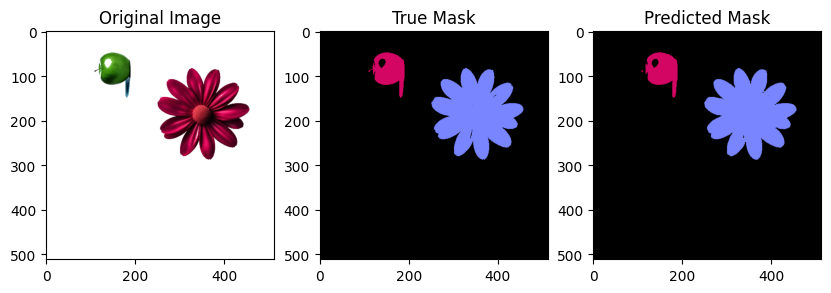

image53 IOU_apple: 0.9759222443119063
image53 IOU_flower: 0.9916428162564396
image53 IOU_back: 0.9985846206956072


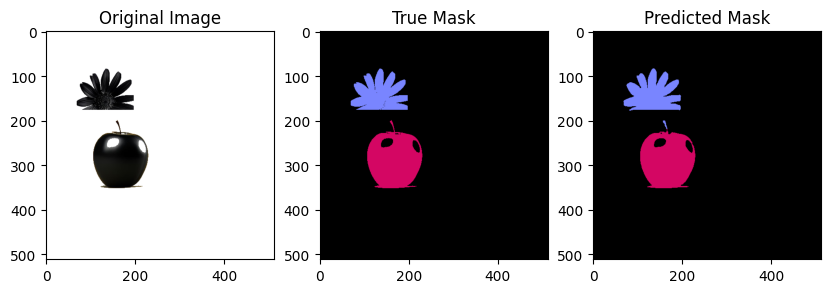

image54 IOU_apple: 0.9830153747082025
image54 IOU_flower: 0.9691668764158067
image54 IOU_back: 0.99865381597747


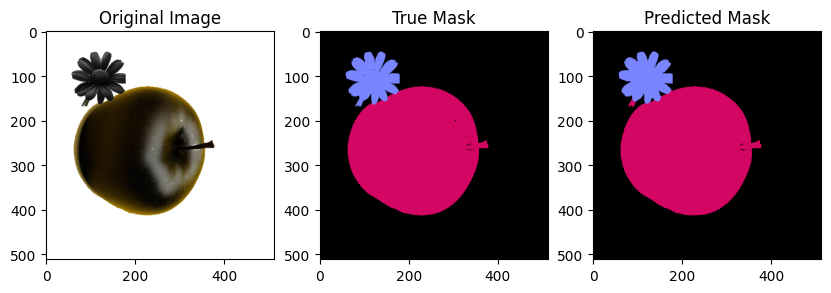

image55 IOU_apple: 0.9933756018781589
image55 IOU_flower: 0.9604875571356019
image55 IOU_back: 0.9976781308953707


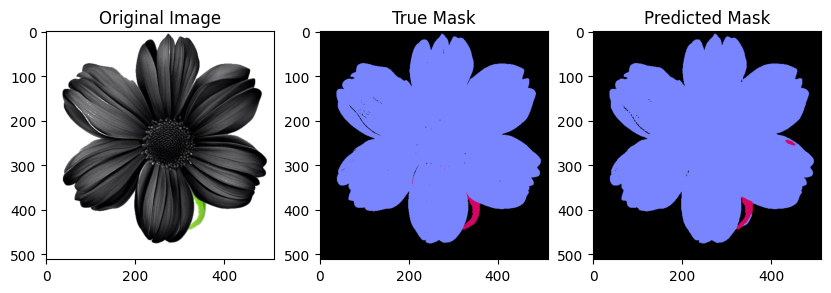

image56 IOU_apple: 0.6842857142857143
image56 IOU_flower: 0.9937729600356229
image56 IOU_back: 0.9952274384144584


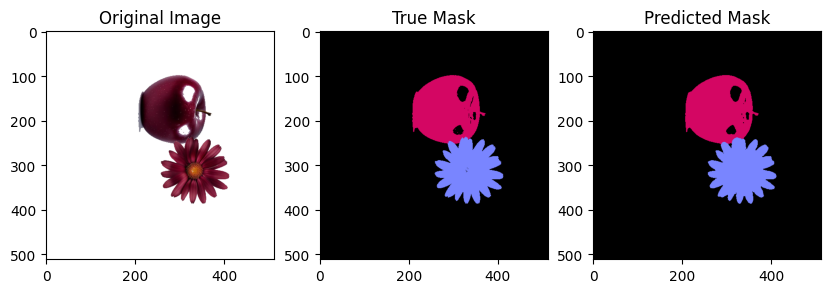

image57 IOU_apple: 0.9850053152800313
image57 IOU_flower: 0.9817763157894737
image57 IOU_back: 0.9982182375799397


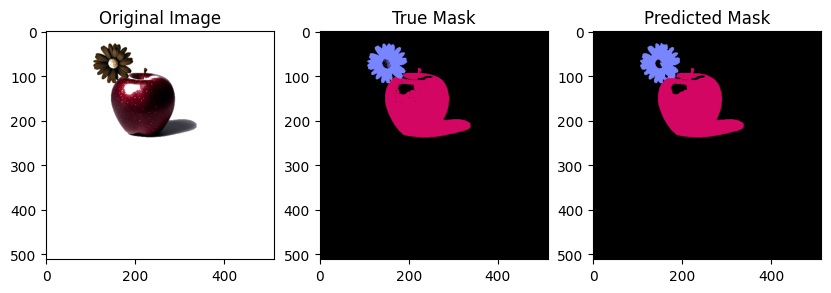

image58 IOU_apple: 0.9854517611026034
image58 IOU_flower: 0.9482041587901702
image58 IOU_back: 0.9981093087264604


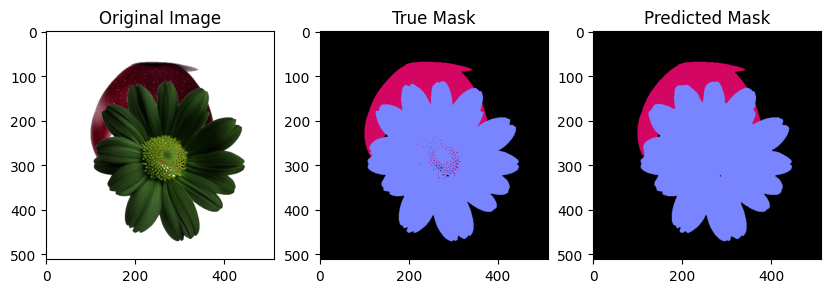

image59 IOU_apple: 0.9385747865891377
image59 IOU_flower: 0.9859341097837744
image59 IOU_back: 0.9981377245508982


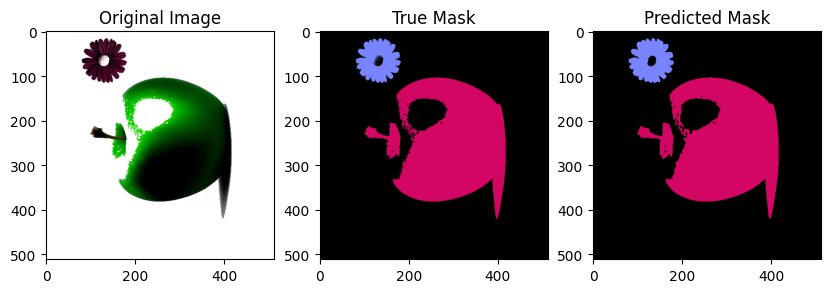

image60 IOU_apple: 0.9852778733498724
image60 IOU_flower: 0.9637149028077754
image60 IOU_back: 0.9947025731069782


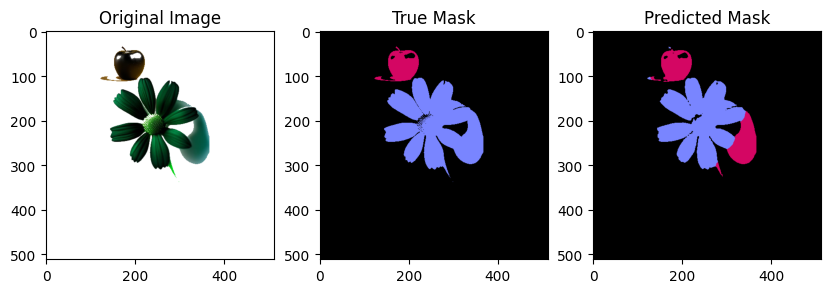

image61 IOU_apple: 0.4342538924877827
image61 IOU_flower: 0.8051532750128648
image61 IOU_back: 0.9970856935617574


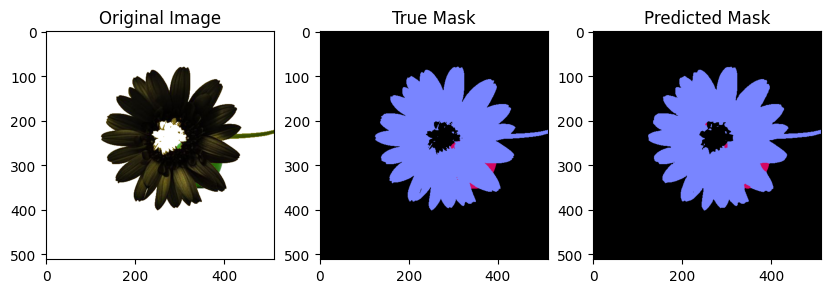

image62 IOU_apple: 0.6932849364791288
image62 IOU_flower: 0.988287358478764
image62 IOU_back: 0.9969154780505015


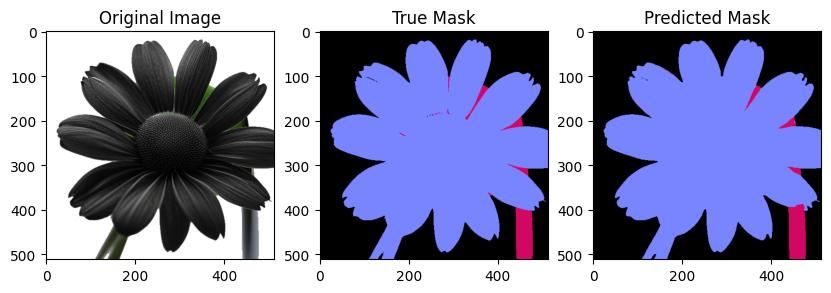

image63 IOU_apple: 0.853309481216458
image63 IOU_flower: 0.991722077239239
image63 IOU_back: 0.9952552404438965


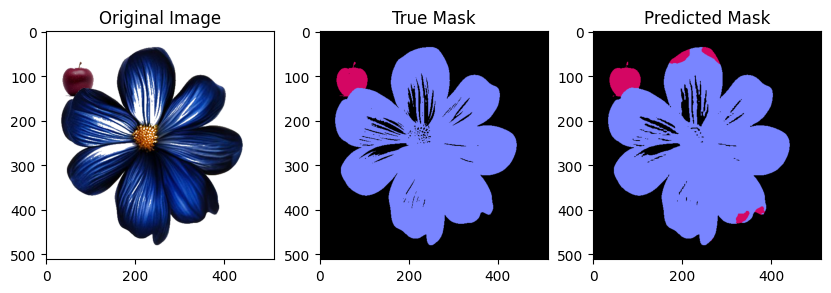

image64 IOU_apple: 0.6029170464904284
image64 IOU_flower: 0.9588218688246918
image64 IOU_back: 0.9849641542336757


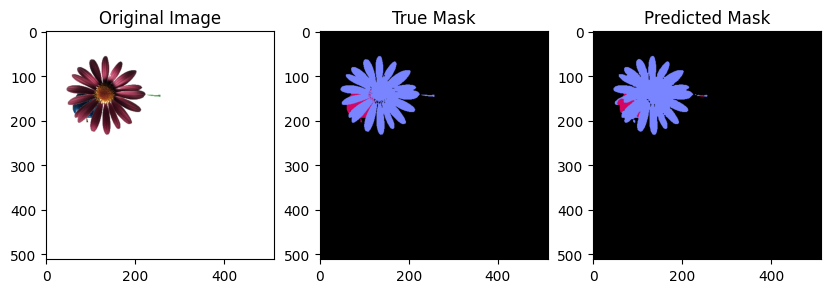

image65 IOU_apple: 0.3691345151199166
image65 IOU_flower: 0.9401102335359963
image65 IOU_back: 0.998033974233209


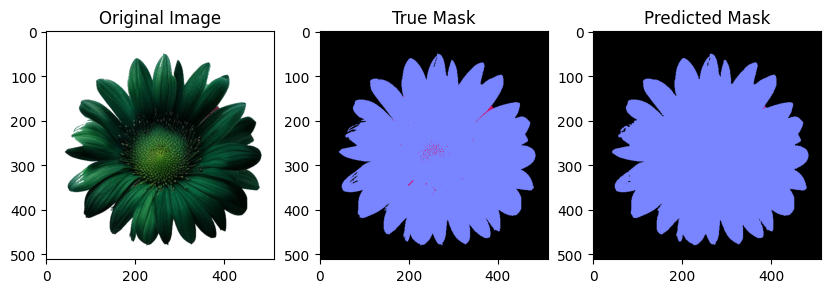

image66 IOU_apple: 0.03787878787878788
image66 IOU_flower: 0.9912524973580074
image66 IOU_back: 0.9943337886315536


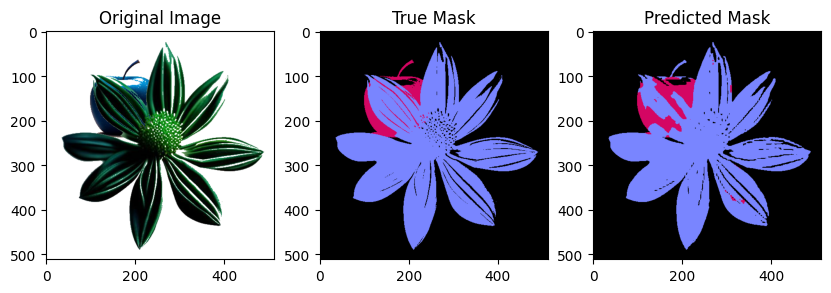

image67 IOU_apple: 0.36307165042304806
image67 IOU_flower: 0.898671840023877
image67 IOU_back: 0.9804790974157117


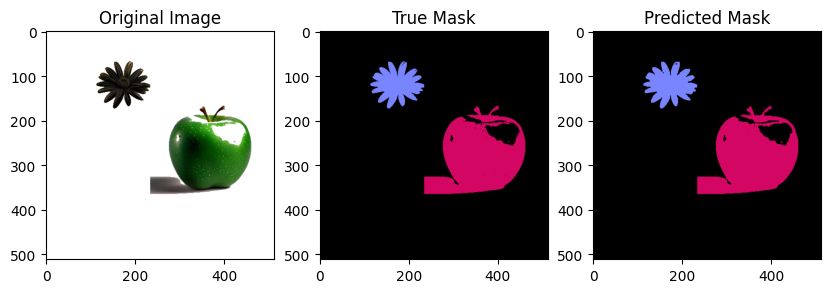

image68 IOU_apple: 0.9857334425985249
image68 IOU_flower: 0.9710398706896551
image68 IOU_back: 0.9973826114359746


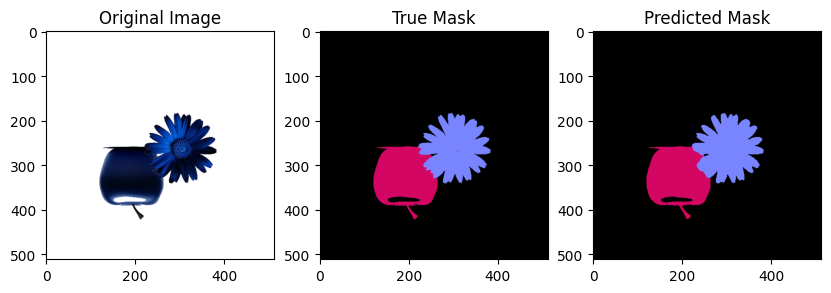

image69 IOU_apple: 0.9755892799483371
image69 IOU_flower: 0.9705403939996385
image69 IOU_back: 0.9982877528815601


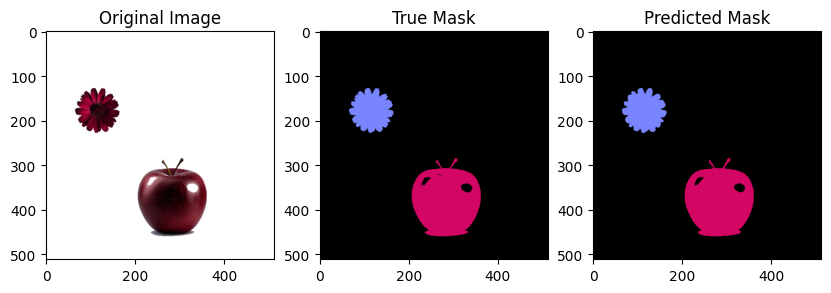

image70 IOU_apple: 0.9908614154421309
image70 IOU_flower: 0.9788981730633055
image70 IOU_back: 0.9986237502593701


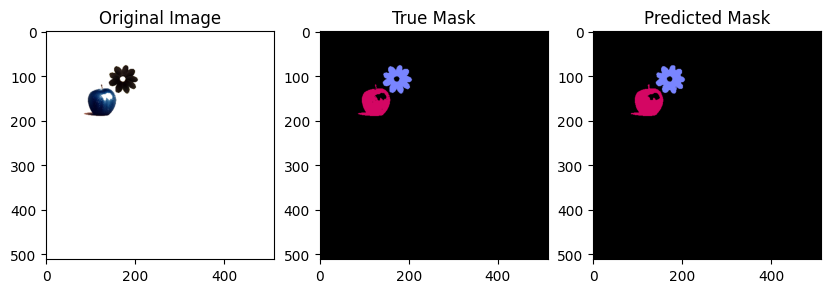

image71 IOU_apple: 0.9719387755102041
image71 IOU_flower: 0.9689004072565717
image71 IOU_back: 0.9993293797932774


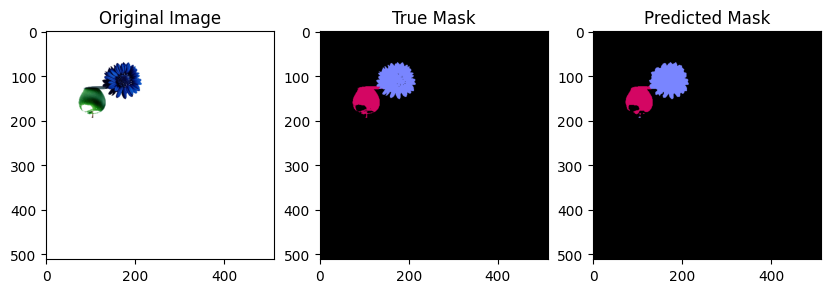

image72 IOU_apple: 0.935997171145686
image72 IOU_flower: 0.9567074354494273
image72 IOU_back: 0.9987113553948243


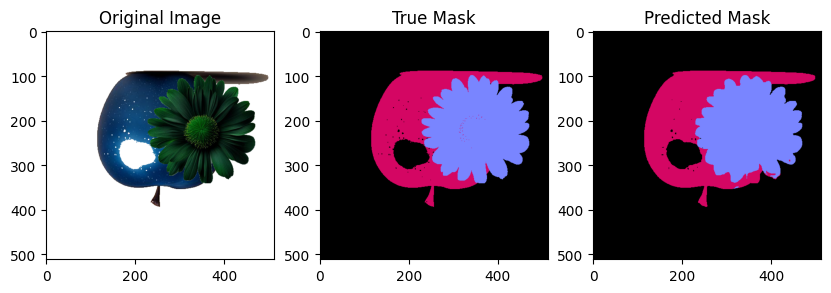

image73 IOU_apple: 0.9419135319057006
image73 IOU_flower: 0.9550548459091125
image73 IOU_back: 0.9976354488328403


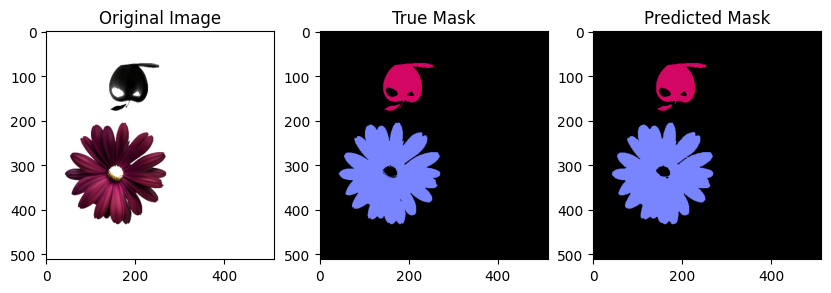

image74 IOU_apple: 0.9785427601111454
image74 IOU_flower: 0.9874246550194291
image74 IOU_back: 0.9975395131814989


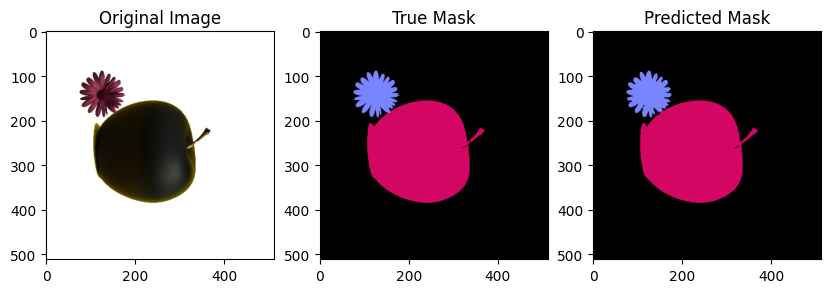

image75 IOU_apple: 0.99525334685131
image75 IOU_flower: 0.9623616236162361
image75 IOU_back: 0.9981120616192956


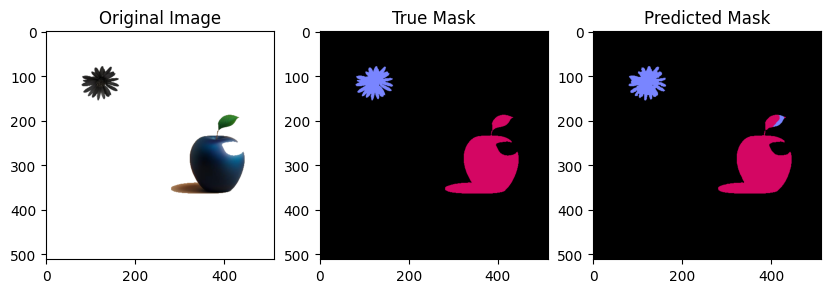

image76 IOU_apple: 0.9754223206867904
image76 IOU_flower: 0.8830635419183378
image76 IOU_back: 0.9986442538481073


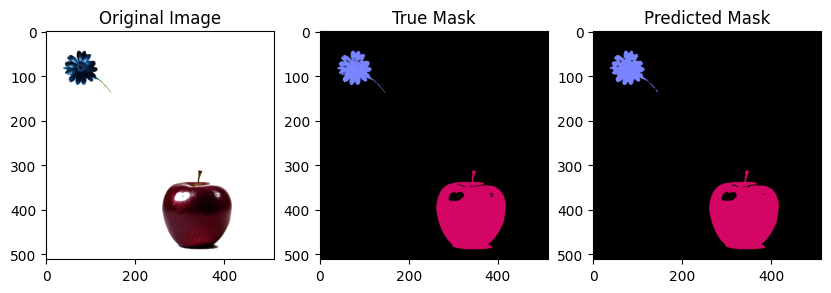

image77 IOU_apple: 0.9910446188695148
image77 IOU_flower: 0.9366866866866866
image77 IOU_back: 0.9982344691720787


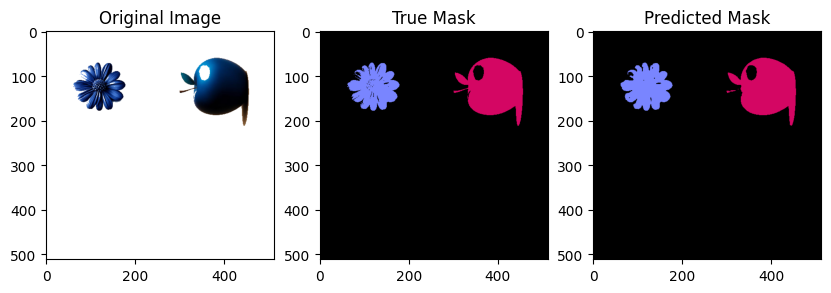

image78 IOU_apple: 0.9884015947807177
image78 IOU_flower: 0.9491669706919615
image78 IOU_back: 0.9975987104493486


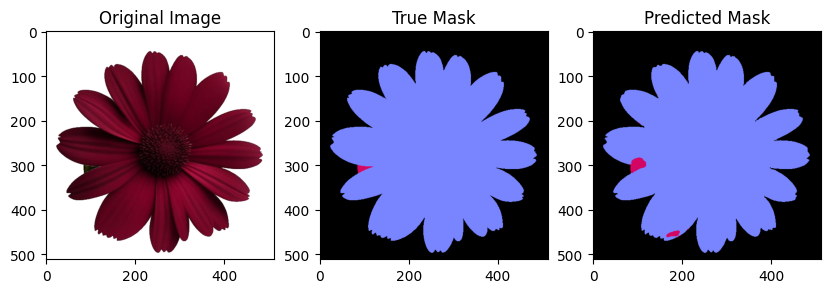

image79 IOU_apple: 0.25362937660119556
image79 IOU_flower: 0.991074629541109
image79 IOU_back: 0.9973886675968726


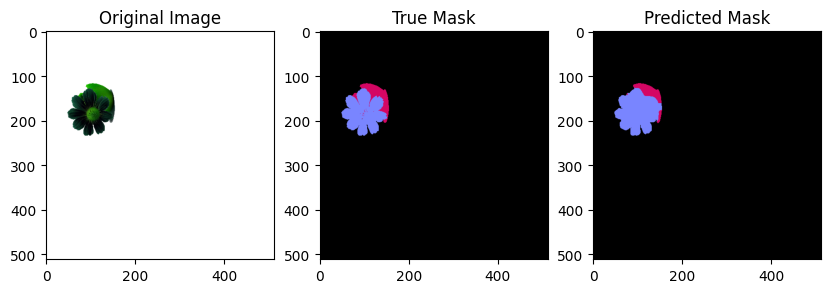

image80 IOU_apple: 0.6826042726347915
image80 IOU_flower: 0.908411214953271
image80 IOU_back: 0.9995737913234963


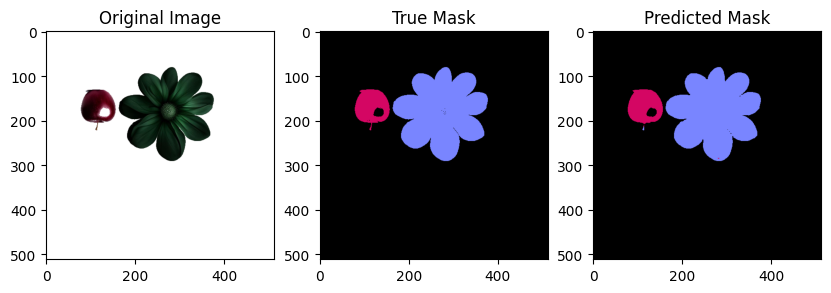

image81 IOU_apple: 0.9730079896350681
image81 IOU_flower: 0.9936185542251347
image81 IOU_back: 0.9988934956789476


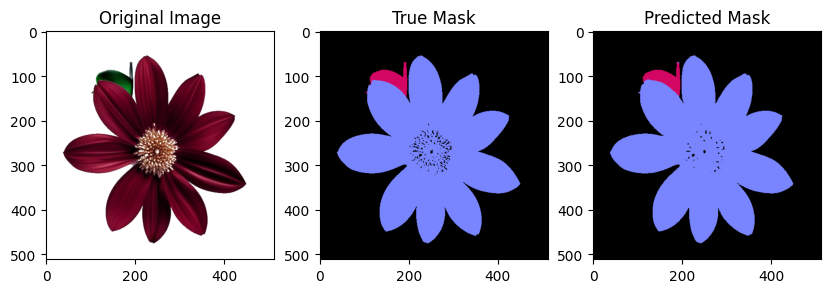

image82 IOU_apple: 0.9568899153194765
image82 IOU_flower: 0.9866714307369151
image82 IOU_back: 0.9929771862440709


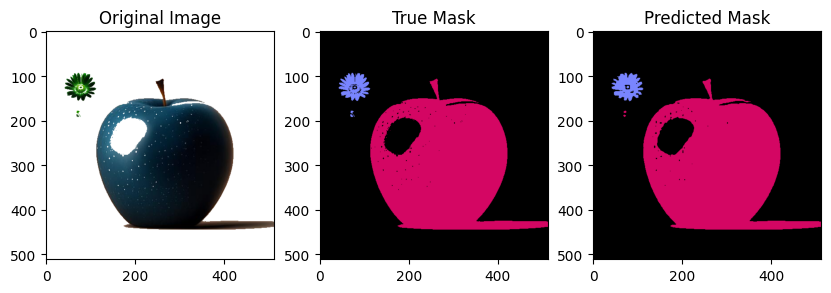

image83 IOU_apple: 0.9923084214660041
image83 IOU_flower: 0.868013468013468
image83 IOU_back: 0.9953179448355106


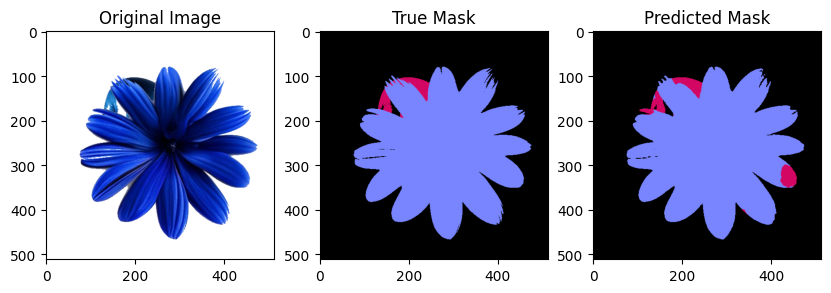

image84 IOU_apple: 0.48929456840207347
image84 IOU_flower: 0.9696559761909718
image84 IOU_back: 0.9951639752609388


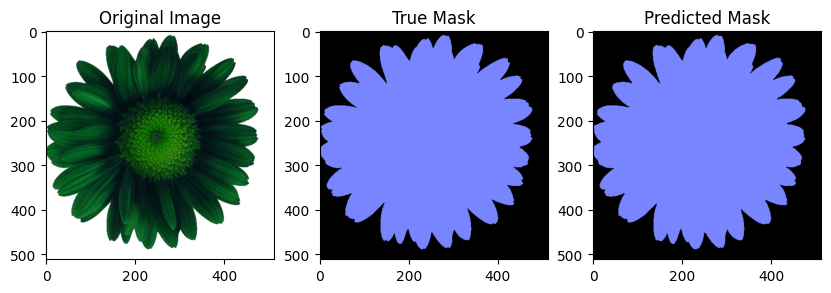

image85 IOU_apple: 1
image85 IOU_flower: 0.9972962940048259
image85 IOU_back: 0.9956711671999287


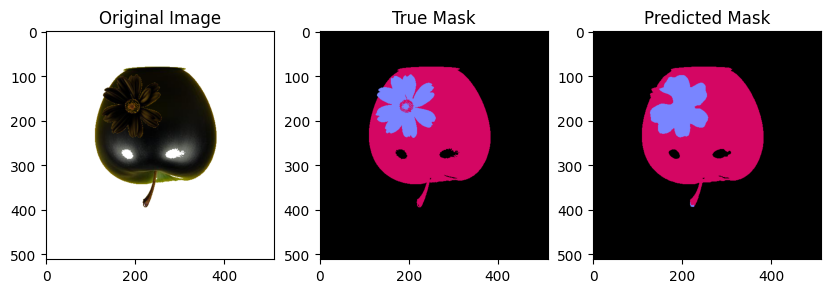

image86 IOU_apple: 0.939057156814851
image86 IOU_flower: 0.7933186211095046
image86 IOU_back: 0.9985114426683622


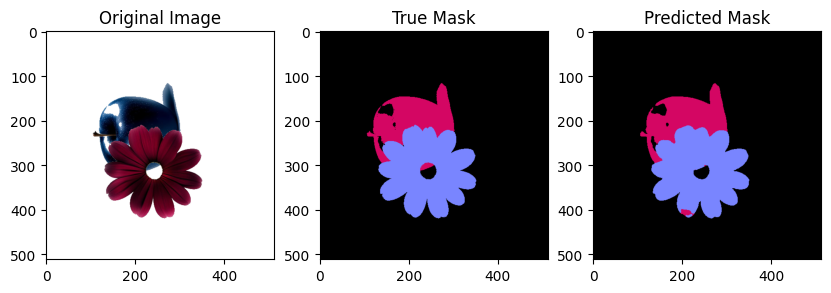

image87 IOU_apple: 0.9313278842288624
image87 IOU_flower: 0.9668380462724936
image87 IOU_back: 0.9983939328397016


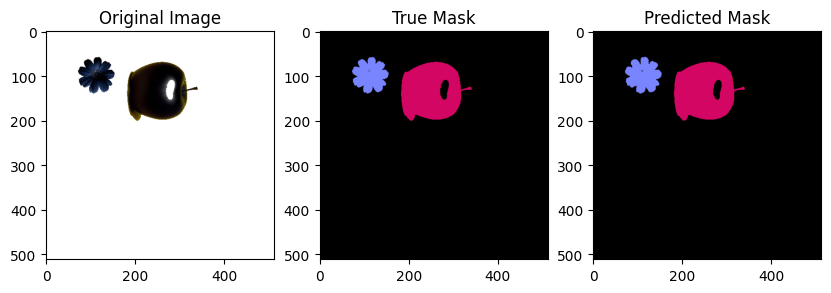

image88 IOU_apple: 0.9920574625319428
image88 IOU_flower: 0.9792117799913382
image88 IOU_back: 0.9991326081773261


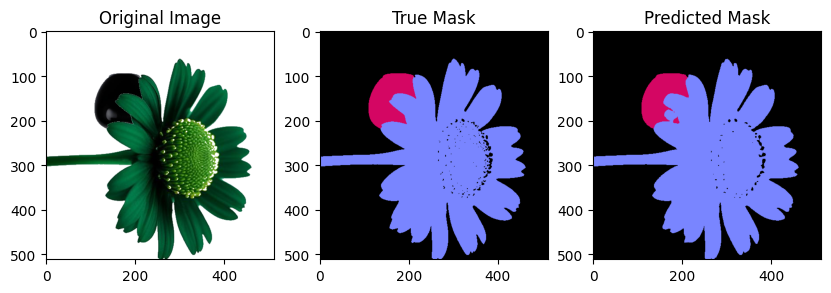

image89 IOU_apple: 0.9115120274914089
image89 IOU_flower: 0.9828311732031645
image89 IOU_back: 0.9938670933758382


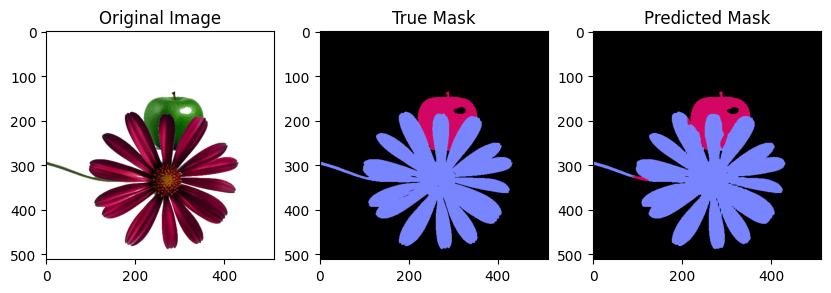

image90 IOU_apple: 0.896025206010664
image90 IOU_flower: 0.9767189767022998
image90 IOU_back: 0.9961929713244776


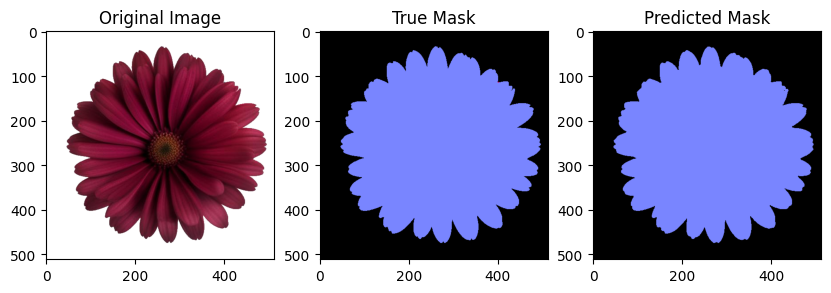

image91 IOU_apple: 1
image91 IOU_flower: 0.9971904837568071
image91 IOU_back: 0.9968808182411684


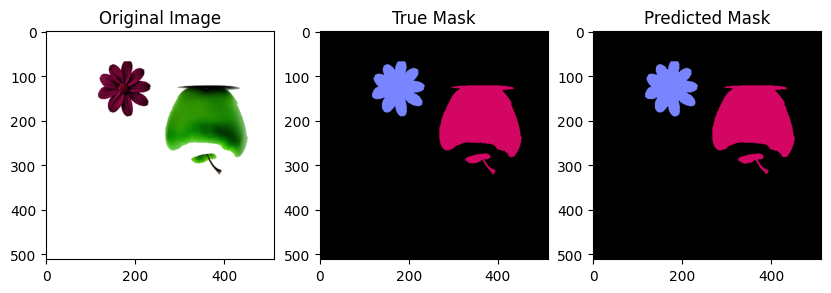

image92 IOU_apple: 0.9921524174913895
image92 IOU_flower: 0.9891781849351763
image92 IOU_back: 0.9987790836610111


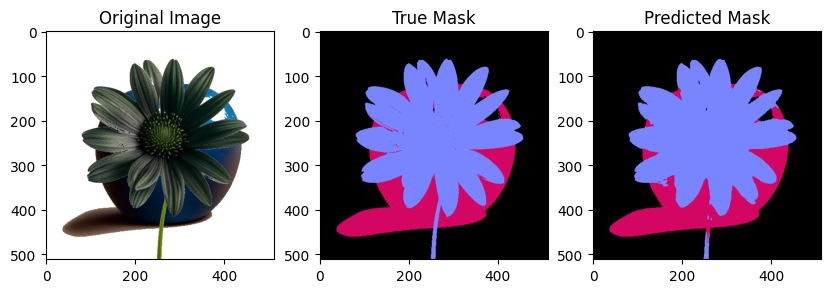

image93 IOU_apple: 0.9118564480965957
image93 IOU_flower: 0.9659161202523815
image93 IOU_back: 0.9974026983438153


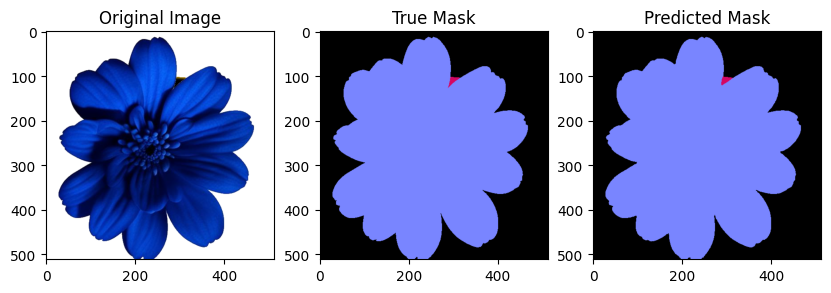

image94 IOU_apple: 0.7392739273927392
image94 IOU_flower: 0.9975090230951058
image94 IOU_back: 0.9972980155917789


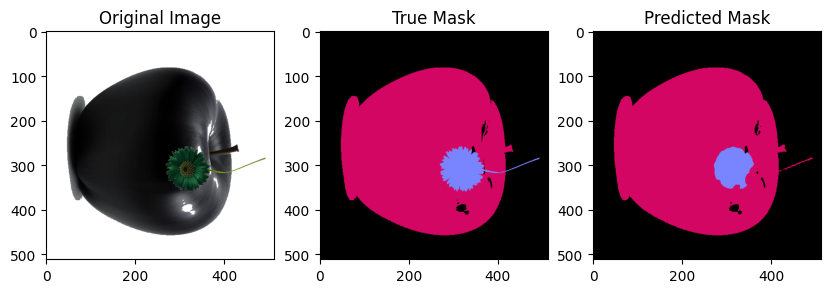

image95 IOU_apple: 0.9798460081216179
image95 IOU_flower: 0.7761213720316623
image95 IOU_back: 0.9966424621943908


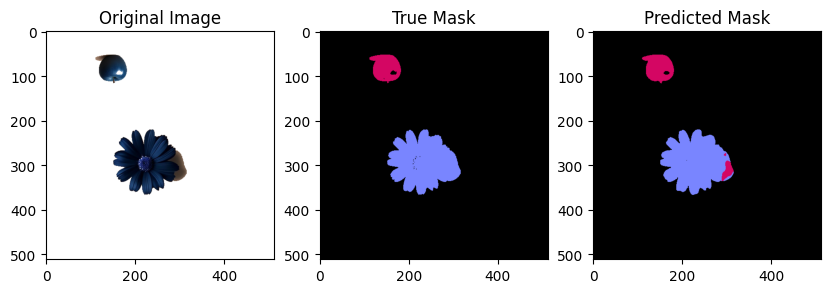

image96 IOU_apple: 0.8092952765849962
image96 IOU_flower: 0.9440321972078983
image96 IOU_back: 0.9988694433138877


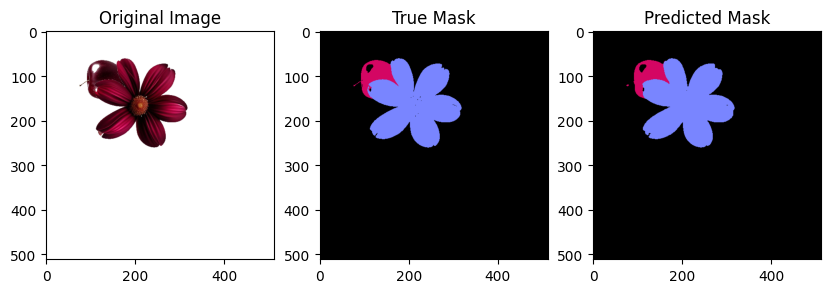

image97 IOU_apple: 0.9324166179052077
image97 IOU_flower: 0.9868616563697505
image97 IOU_back: 0.9988483109988441


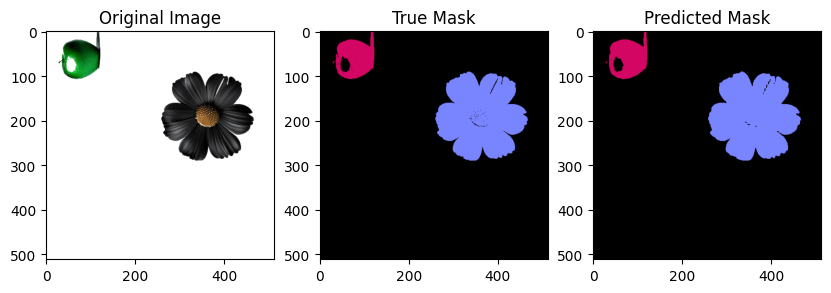

image98 IOU_apple: 0.9735930021455685
image98 IOU_flower: 0.9894594136587019
image98 IOU_back: 0.9979255761921331


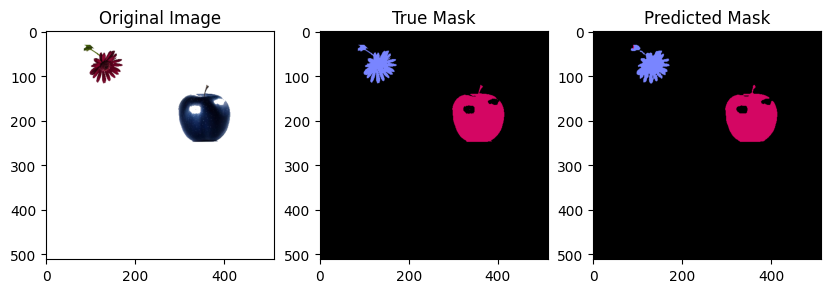

image99 IOU_apple: 0.9862498763478089
image99 IOU_flower: 0.9159710628825821
image99 IOU_back: 0.9983645751712776


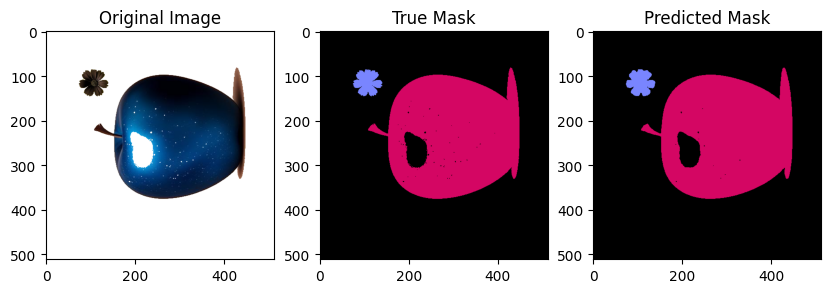

image100 IOU_apple: 0.9951731970471324
image100 IOU_flower: 0.9536804308797128
image100 IOU_back: 0.9976567319705744


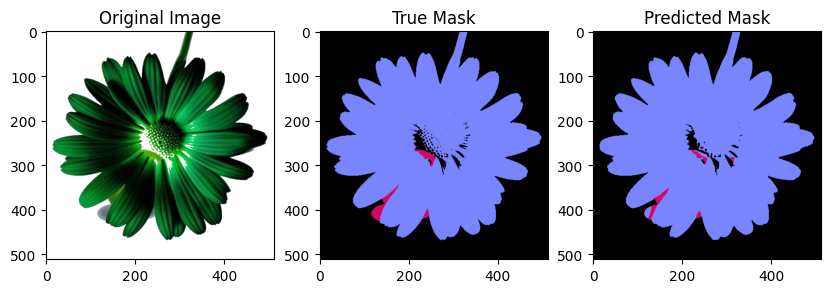

image101 IOU_apple: 0.5356037151702786
image101 IOU_flower: 0.9835544585004629
image101 IOU_back: 0.9899809411888781


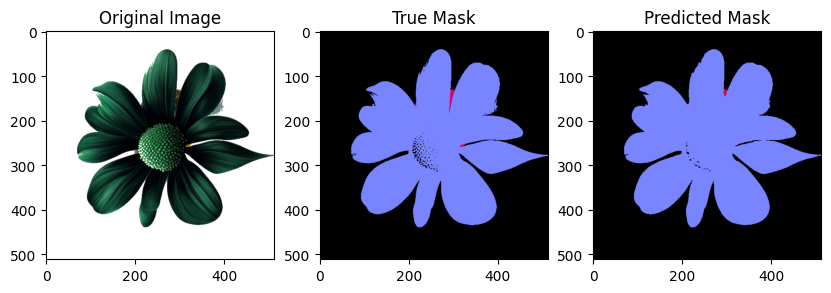

image102 IOU_apple: 0.26822157434402333
image102 IOU_flower: 0.9872524727131243
image102 IOU_back: 0.9938208157490598


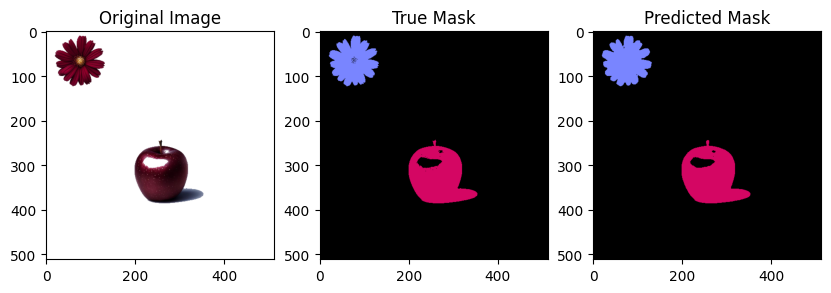

image103 IOU_apple: 0.9903031228525616
image103 IOU_flower: 0.9732544378698225
image103 IOU_back: 0.9985349657605312


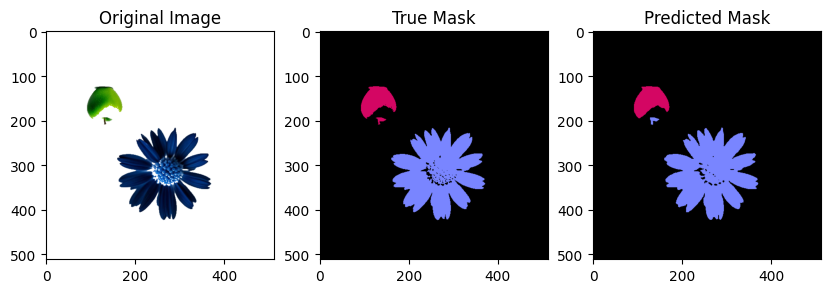

image104 IOU_apple: 0.9405076679005817
image104 IOU_flower: 0.9694957622153654
image104 IOU_back: 0.997080516945416


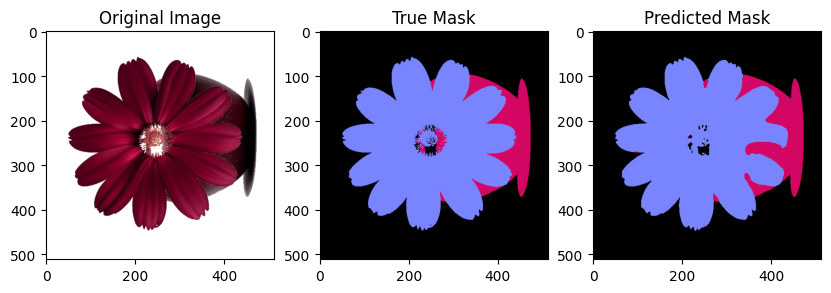

image105 IOU_apple: 0.7893389959708156
image105 IOU_flower: 0.9547789816369093
image105 IOU_back: 0.9947744481177349


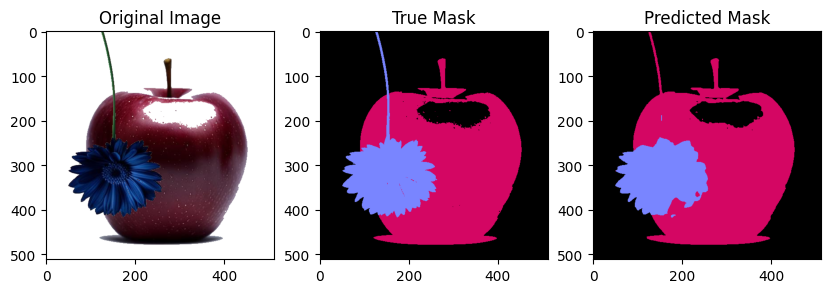

image106 IOU_apple: 0.9516176870412022
image106 IOU_flower: 0.8796874442501873
image106 IOU_back: 0.9953628019108564


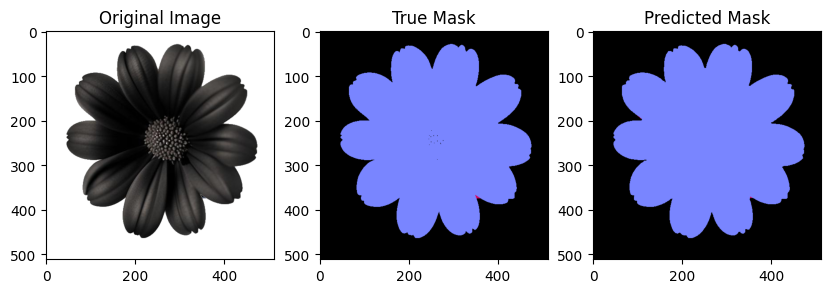

image107 IOU_apple: 0.22
image107 IOU_flower: 0.997944293467681
image107 IOU_back: 0.9982156455779367


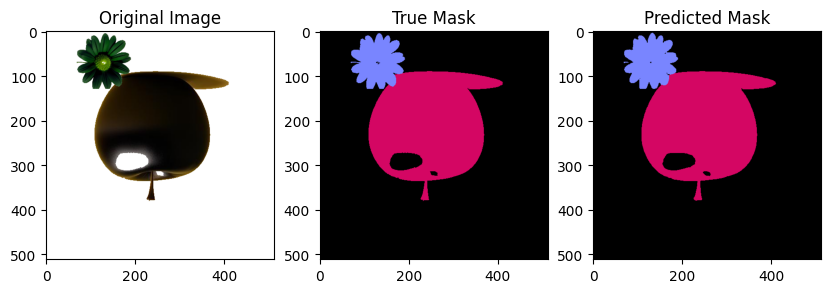

image108 IOU_apple: 0.9950953678474115
image108 IOU_flower: 0.974598040148416
image108 IOU_back: 0.9981093176446925


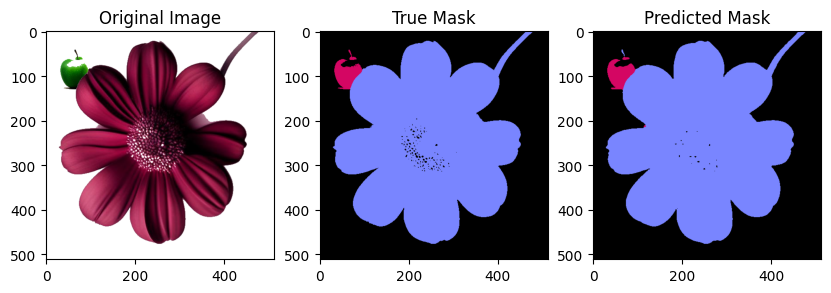

image109 IOU_apple: 0.9369369369369369
image109 IOU_flower: 0.9926170919806885
image109 IOU_back: 0.9927044119861467


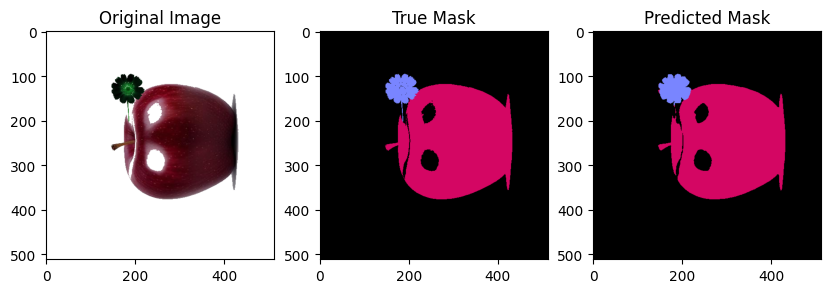

image110 IOU_apple: 0.9893210283454186
image110 IOU_flower: 0.92940863079382
image110 IOU_back: 0.996903363587827


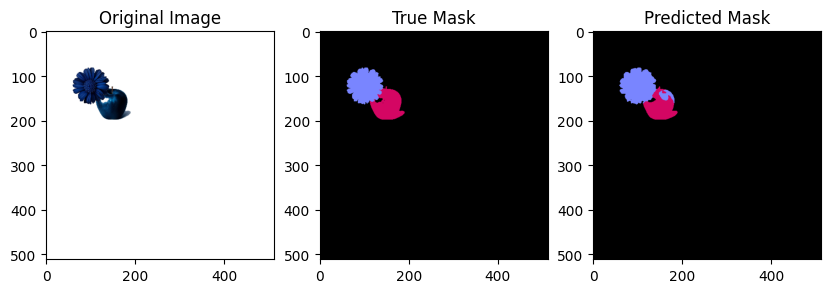

image111 IOU_apple: 0.8266237251744498
image111 IOU_flower: 0.8717810192688636
image111 IOU_back: 0.9993139639870521


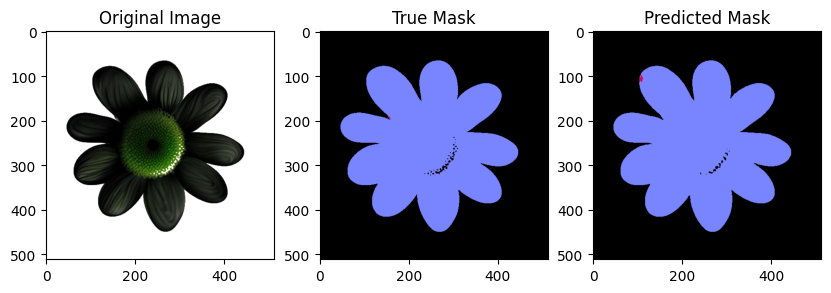

image112 IOU_apple: 1
image112 IOU_flower: 0.993380569588748
image112 IOU_back: 0.9969269907690844


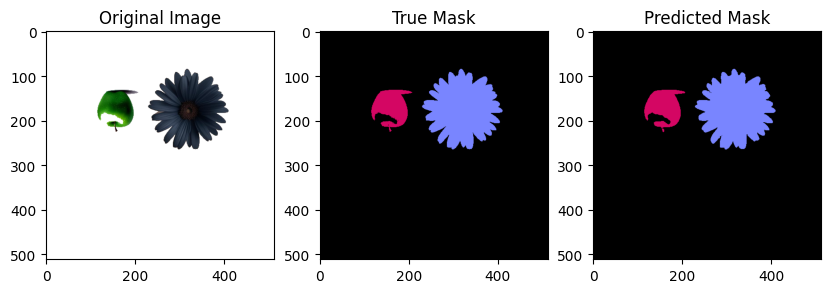

image113 IOU_apple: 0.9796884243738907
image113 IOU_flower: 0.9889110984199505
image113 IOU_back: 0.9985786621657635


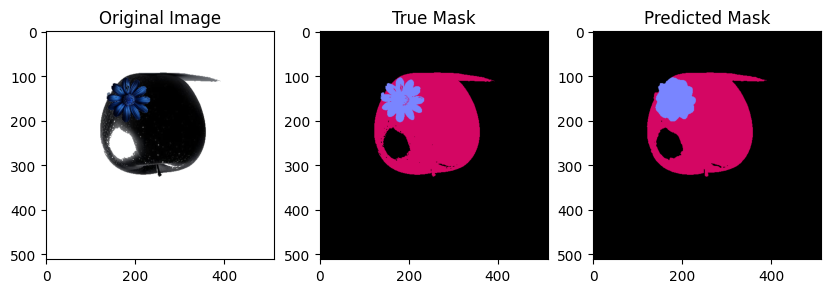

image114 IOU_apple: 0.9643553774215097
image114 IOU_flower: 0.8558545454545454
image114 IOU_back: 0.9982891867478124


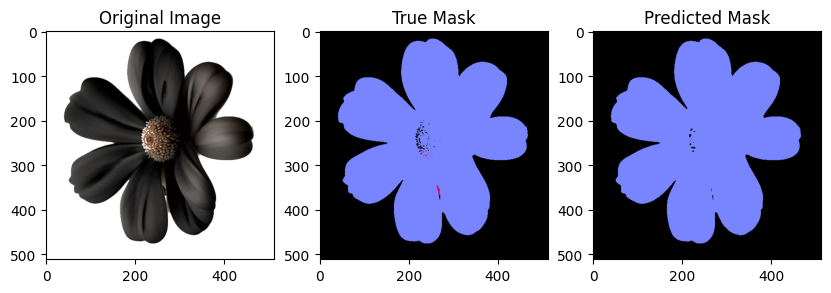

image115 IOU_apple: 0.10344827586206896
image115 IOU_flower: 0.994914155600246
image115 IOU_back: 0.9965701433792522


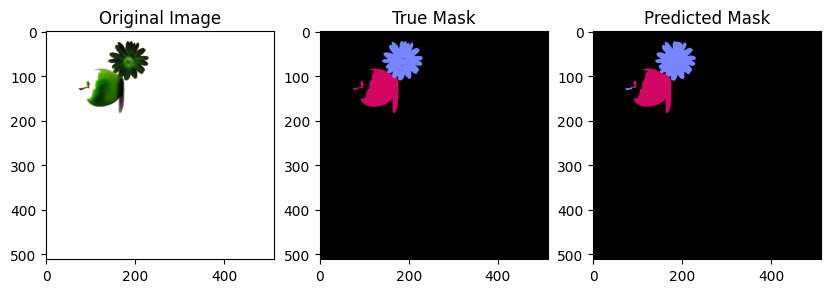

image116 IOU_apple: 0.9564266180492251
image116 IOU_flower: 0.94574807584006
image116 IOU_back: 0.9988559625009931


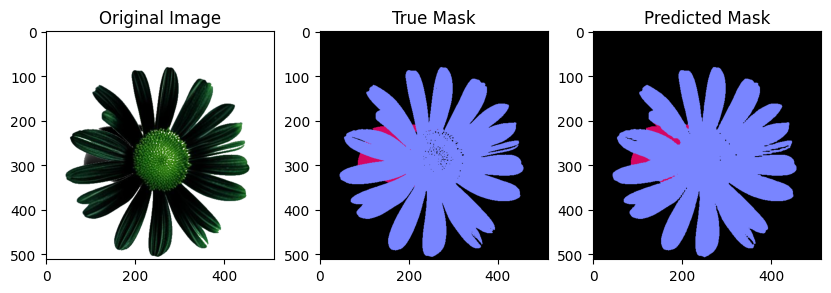

image117 IOU_apple: 0.646755921730175
image117 IOU_flower: 0.9823553710879871
image117 IOU_back: 0.992778162360381


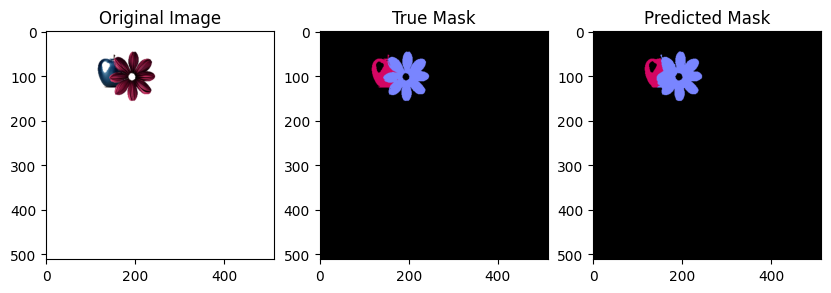

image118 IOU_apple: 0.8180845371856608
image118 IOU_flower: 0.9410668196157155
image118 IOU_back: 0.9993497767566865


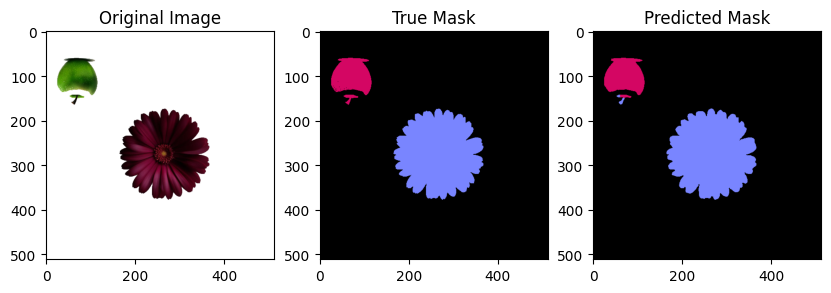

image119 IOU_apple: 0.9613811160202913
image119 IOU_flower: 0.9867807414863278
image119 IOU_back: 0.9983063929256621


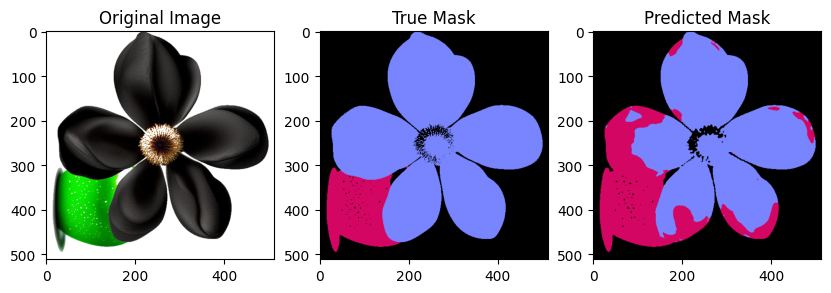

image120 IOU_apple: 0.4699948509104527
image120 IOU_flower: 0.8064934746945471
image120 IOU_back: 0.9865163334353569


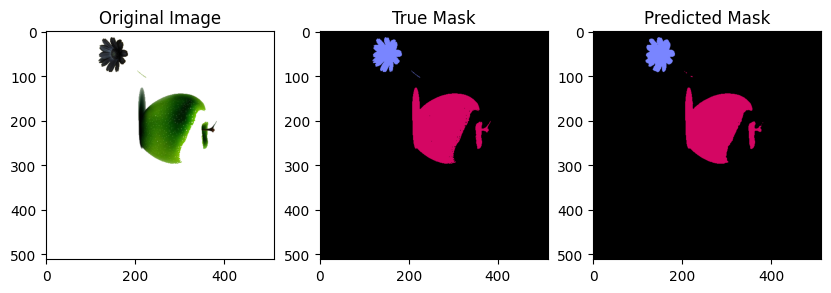

image121 IOU_apple: 0.9877900584456918
image121 IOU_flower: 0.9600340136054422
image121 IOU_back: 0.9986179958457121


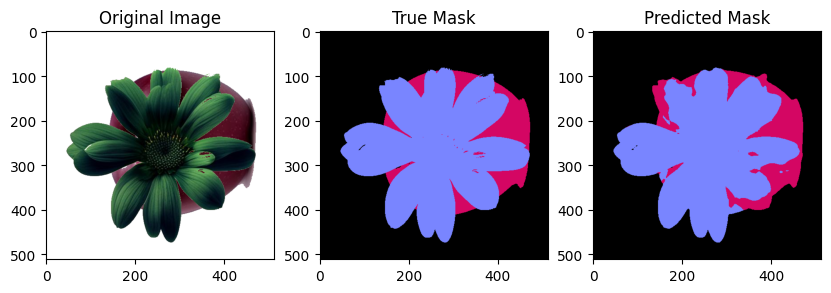

image122 IOU_apple: 0.6302648810781124
image122 IOU_flower: 0.9062045978976155
image122 IOU_back: 0.9983350568096827


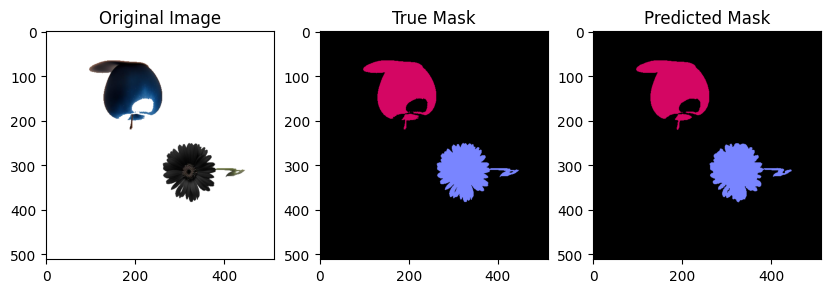

image123 IOU_apple: 0.9878960484158064
image123 IOU_flower: 0.973186119873817
image123 IOU_back: 0.9979929415633974


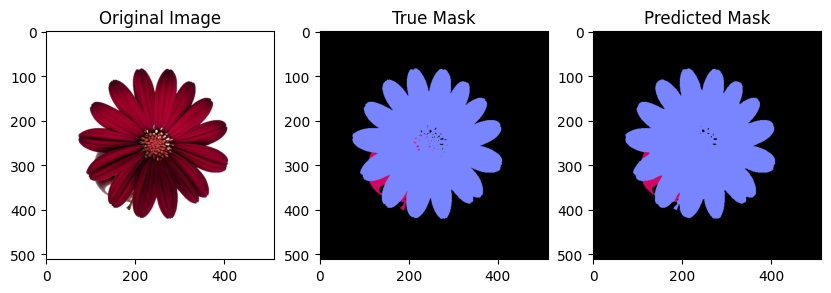

image124 IOU_apple: 0.7218798151001541
image124 IOU_flower: 0.9907832848481553
image124 IOU_back: 0.9978458134314863


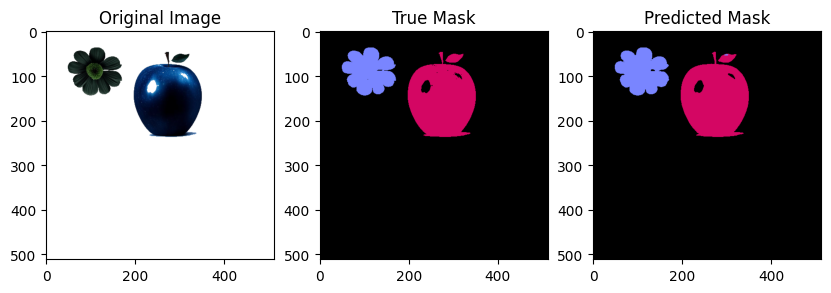

image125 IOU_apple: 0.9909730140630939
image125 IOU_flower: 0.9831686393745249
image125 IOU_back: 0.9987123668763915


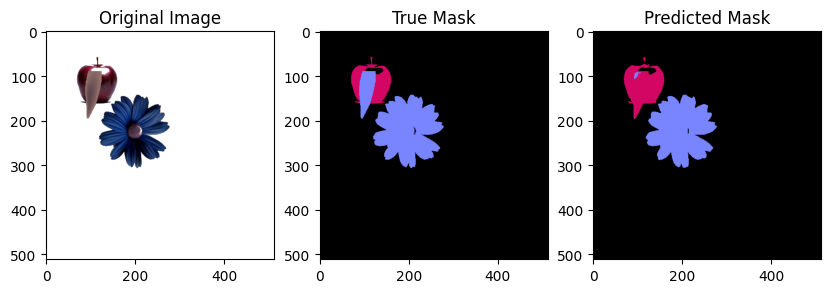

image126 IOU_apple: 0.5864628172777201
image126 IOU_flower: 0.8559790962188749
image126 IOU_back: 0.9984719722024532


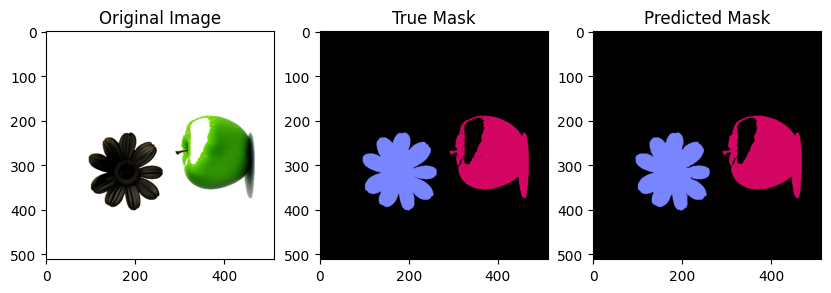

image127 IOU_apple: 0.9822853414964621
image127 IOU_flower: 0.9897948392554992
image127 IOU_back: 0.9975608775480118


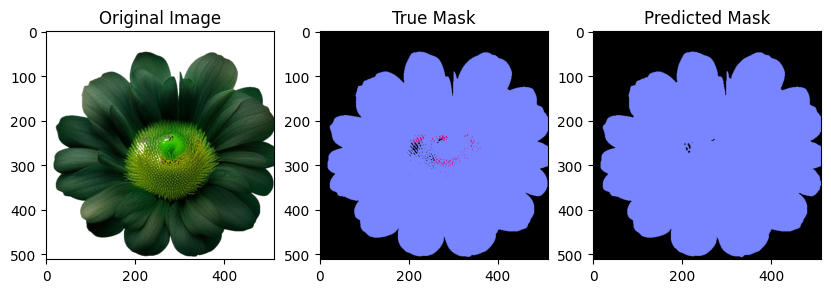

image128 IOU_apple: 1
image128 IOU_flower: 0.9935873850197109
image128 IOU_back: 0.9937805371254932


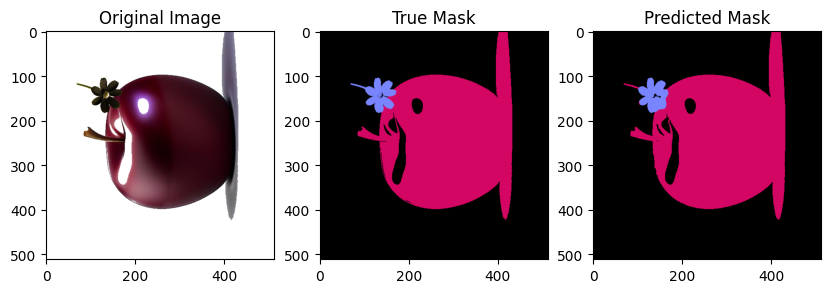

image129 IOU_apple: 0.9900925878821794
image129 IOU_flower: 0.8754116355653129
image129 IOU_back: 0.9970954517540705


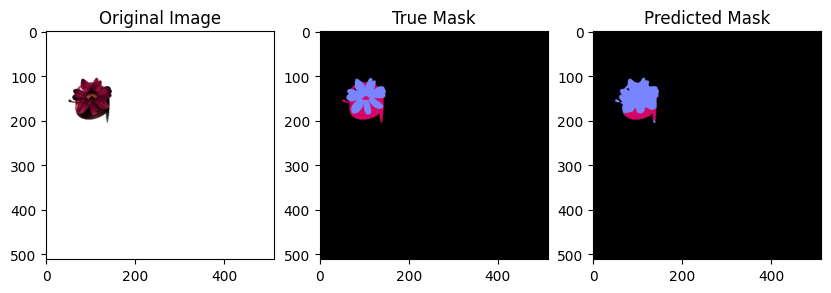

image130 IOU_apple: 0.5567112431896979
image130 IOU_flower: 0.8203454894433782
image130 IOU_back: 0.9995349564265895


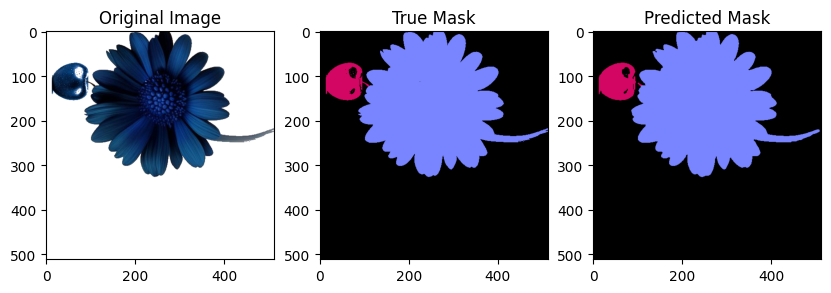

image131 IOU_apple: 0.9567281358407888
image131 IOU_flower: 0.9944029850746269
image131 IOU_back: 0.9964833549123308


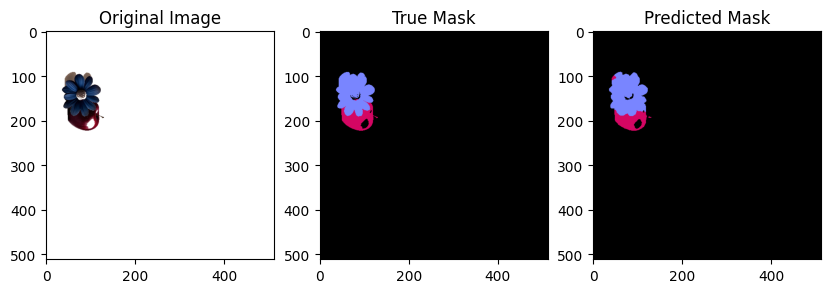

image132 IOU_apple: 0.8187781877818778
image132 IOU_flower: 0.9237235367372354
image132 IOU_back: 0.9993302656875414


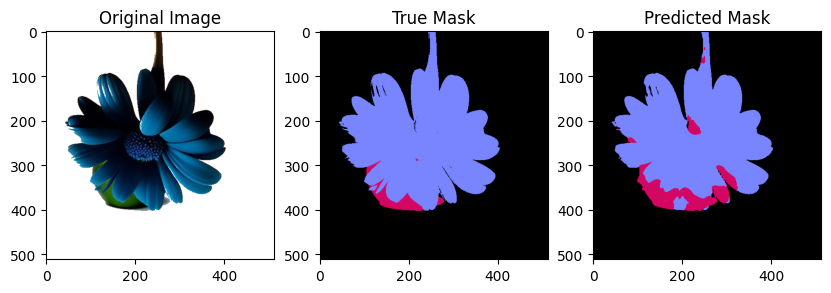

image133 IOU_apple: 0.23750239417736066
image133 IOU_flower: 0.8927173969005818
image133 IOU_back: 0.9964763261727313


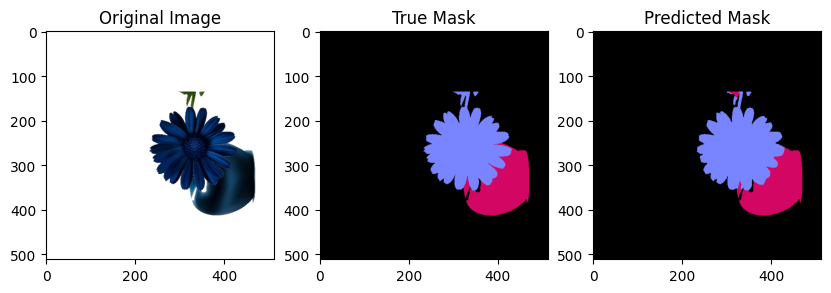

image134 IOU_apple: 0.9506916555109326
image134 IOU_flower: 0.9663835948812273
image134 IOU_back: 0.9985718493658119


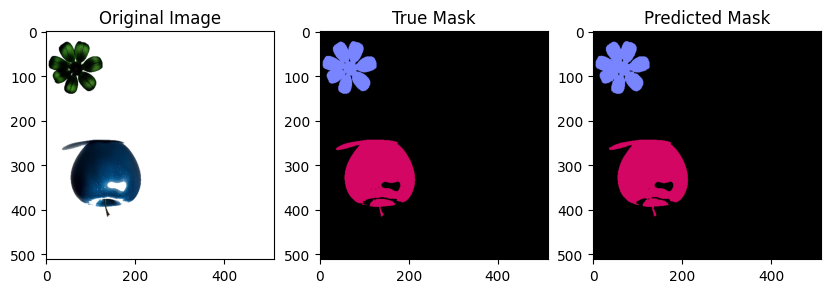

image135 IOU_apple: 0.9882771613983672
image135 IOU_flower: 0.9812005277044855
image135 IOU_back: 0.9983143789873472


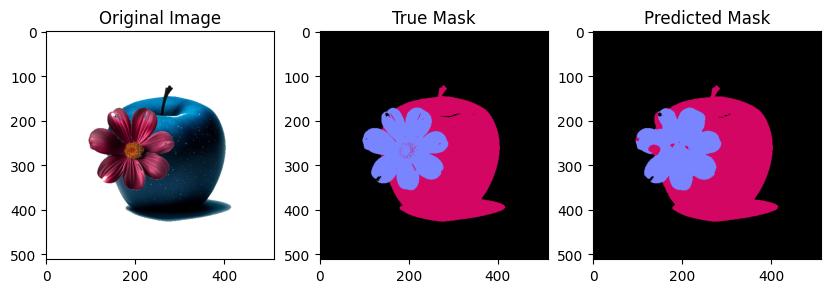

image136 IOU_apple: 0.9546991210277215
image136 IOU_flower: 0.9216882574174676
image136 IOU_back: 0.9985606884196665


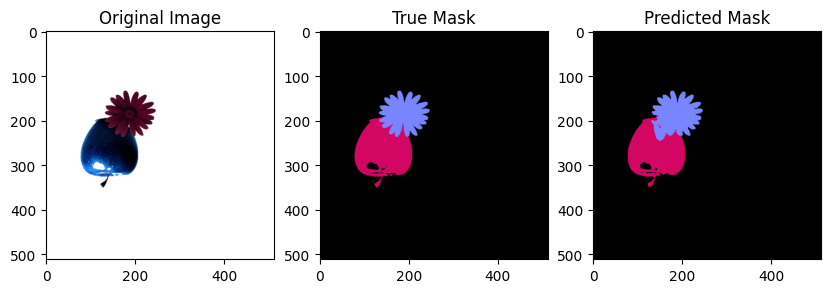

image137 IOU_apple: 0.9146681539319577
image137 IOU_flower: 0.8858957769674156
image137 IOU_back: 0.9984028459881307


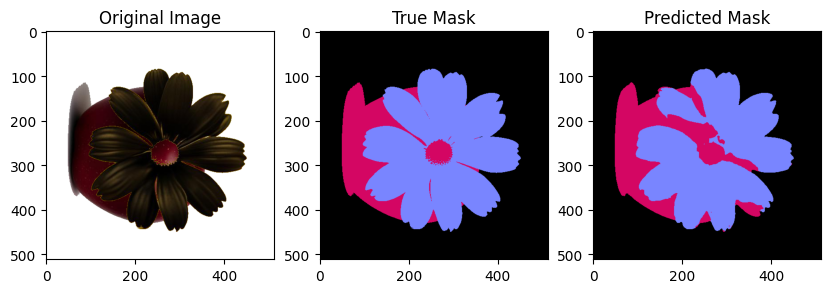

image138 IOU_apple: 0.7169323023512704
image138 IOU_flower: 0.8886620641872665
image138 IOU_back: 0.9983747621987326


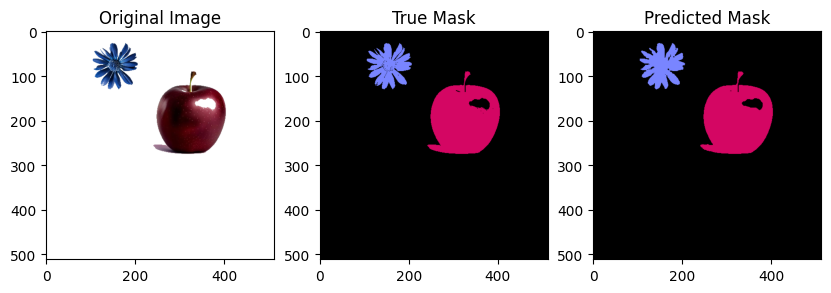

image139 IOU_apple: 0.9931941923774955
image139 IOU_flower: 0.9287063267233239
image139 IOU_back: 0.9975141835276611


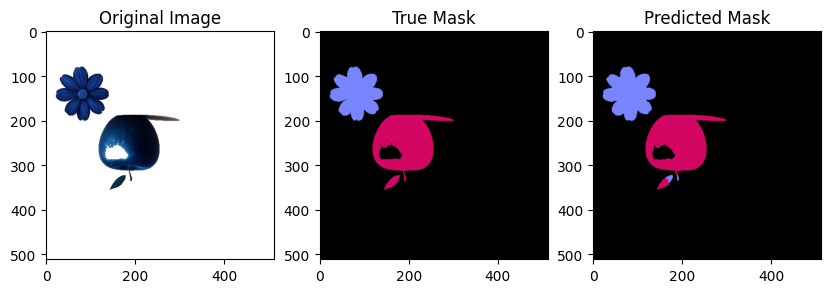

image140 IOU_apple: 0.9733160444960076
image140 IOU_flower: 0.966624419095902
image140 IOU_back: 0.9986961917059346


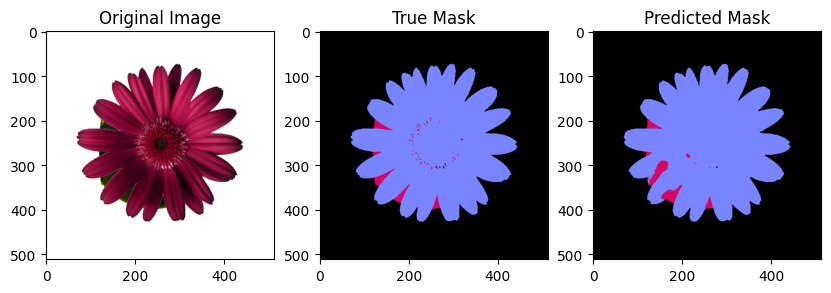

image141 IOU_apple: 0.47190313567215153
image141 IOU_flower: 0.9759744978084054
image141 IOU_back: 0.9976832350463353


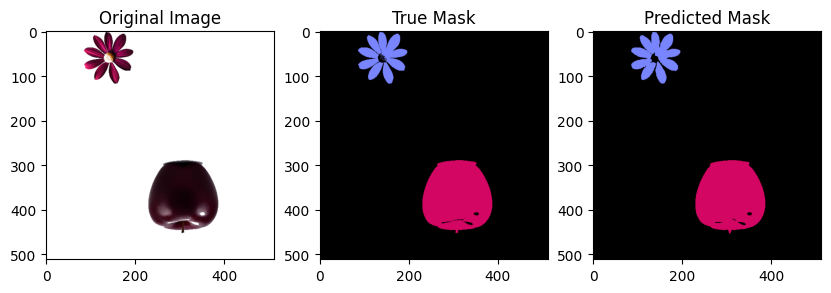

image142 IOU_apple: 0.9913310546391242
image142 IOU_flower: 0.9609274366680979
image142 IOU_back: 0.9980970019284846


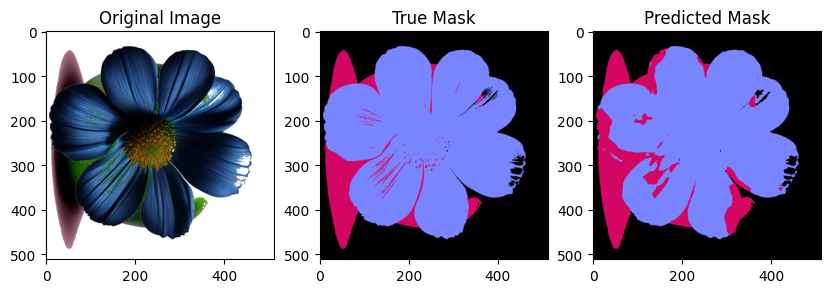

image143 IOU_apple: 0.5635884722652619
image143 IOU_flower: 0.890874776305698
image143 IOU_back: 0.9908852417917932


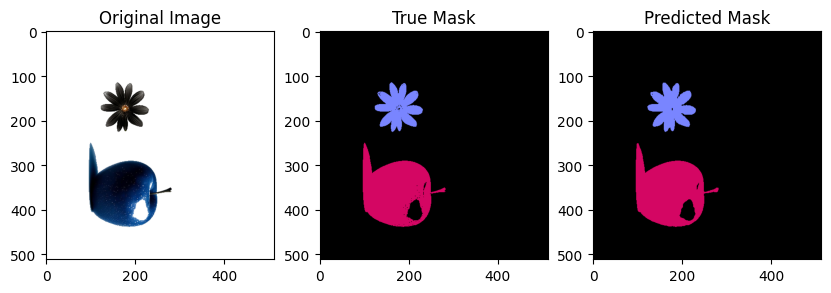

image144 IOU_apple: 0.989963743366087
image144 IOU_flower: 0.9702840495265841
image144 IOU_back: 0.9983308189973927


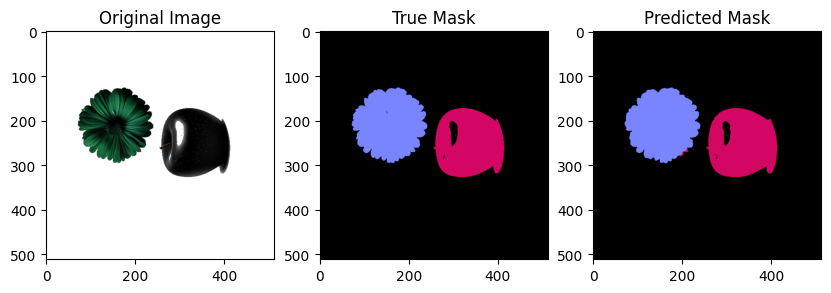

image145 IOU_apple: 0.9891034910142532
image145 IOU_flower: 0.9876092594371338
image145 IOU_back: 0.9986192690671296


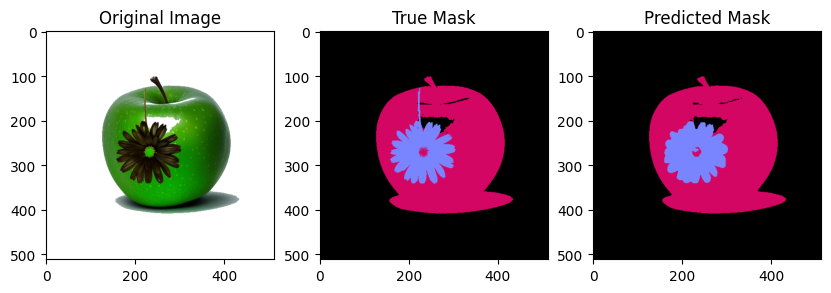

image146 IOU_apple: 0.9671430098713517
image146 IOU_flower: 0.8958375772390846
image146 IOU_back: 0.9979914897141496


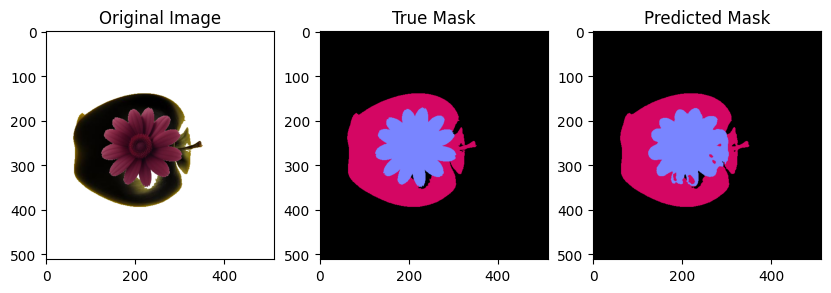

image147 IOU_apple: 0.9455605013470775
image147 IOU_flower: 0.9251700680272109
image147 IOU_back: 0.9986729493220502


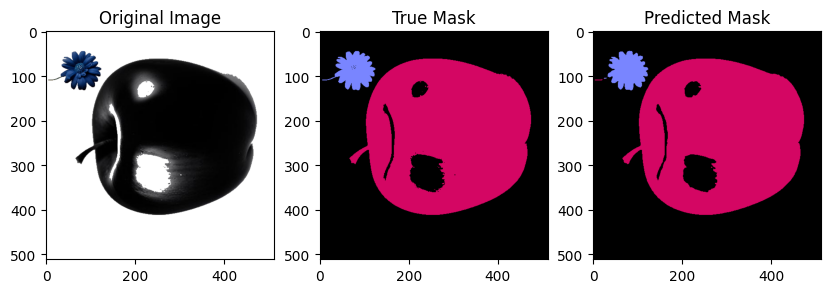

image148 IOU_apple: 0.9950379364179669
image148 IOU_flower: 0.9655357142857143
image148 IOU_back: 0.995965347956819


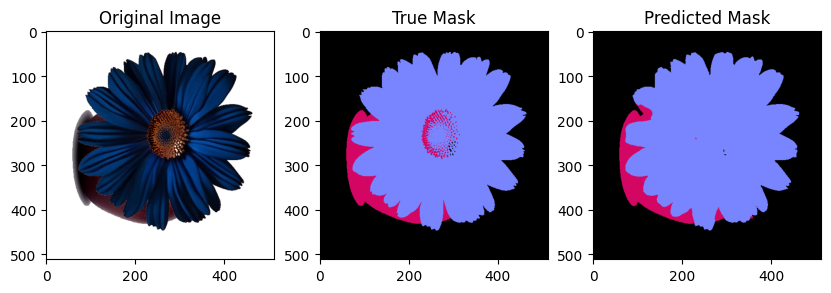

image149 IOU_apple: 0.7183454373223871
image149 IOU_flower: 0.9648975463502298
image149 IOU_back: 0.9964896546408728


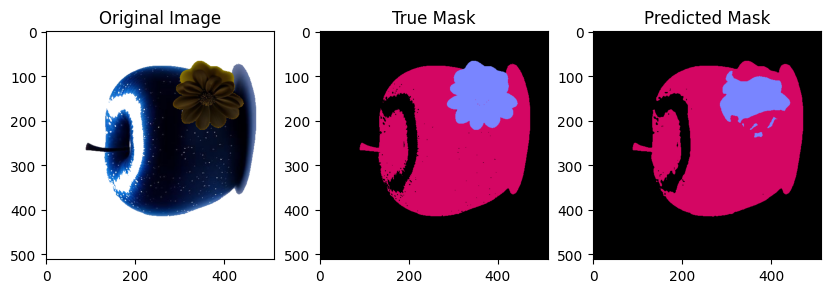

image150 IOU_apple: 0.9090820407765096
image150 IOU_flower: 0.6288589069288818
image150 IOU_back: 0.994285848657292


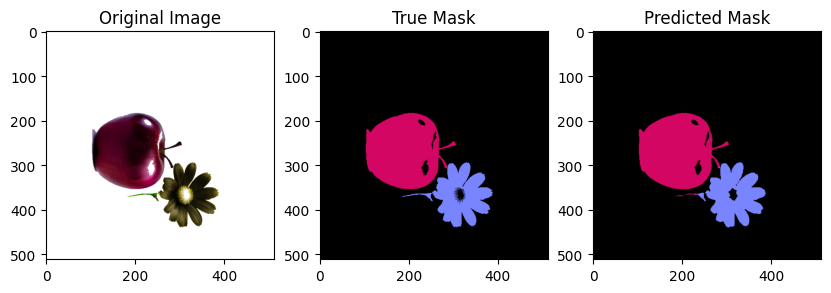

image151 IOU_apple: 0.9869179791720458
image151 IOU_flower: 0.9575514217815291
image151 IOU_back: 0.9971596530028096


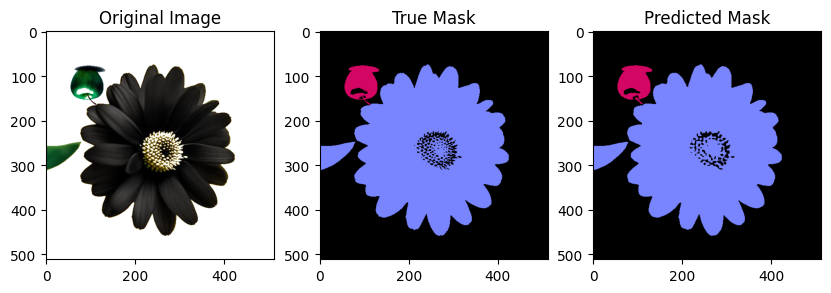

image152 IOU_apple: 0.9680661009379187
image152 IOU_flower: 0.9793064937017429
image152 IOU_back: 0.9875761486060679


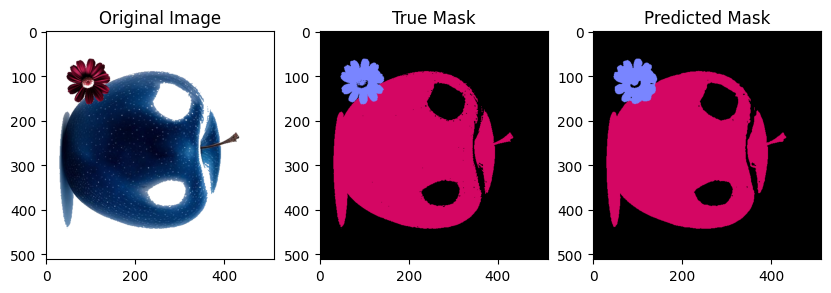

image153 IOU_apple: 0.9880722566729576
image153 IOU_flower: 0.9457983193277311
image153 IOU_back: 0.9934032341882432


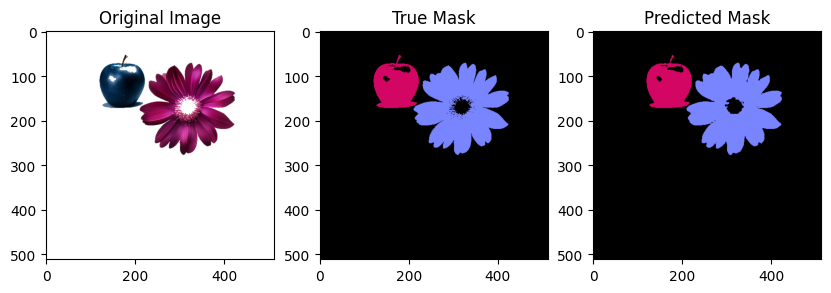

image154 IOU_apple: 0.976902012144303
image154 IOU_flower: 0.9773805992287156
image154 IOU_back: 0.9964671919009056


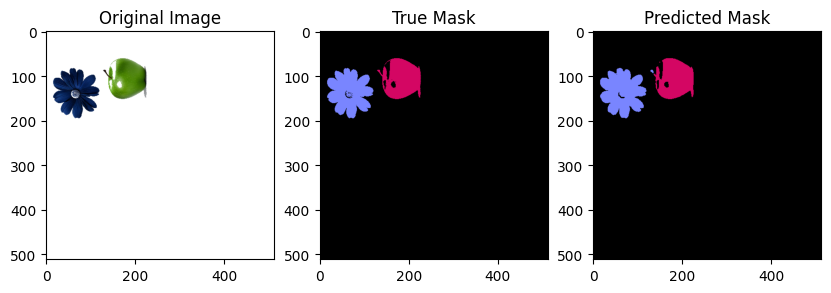

image155 IOU_apple: 0.9661598822952427
image155 IOU_flower: 0.97285986049461
image155 IOU_back: 0.9985876842850705


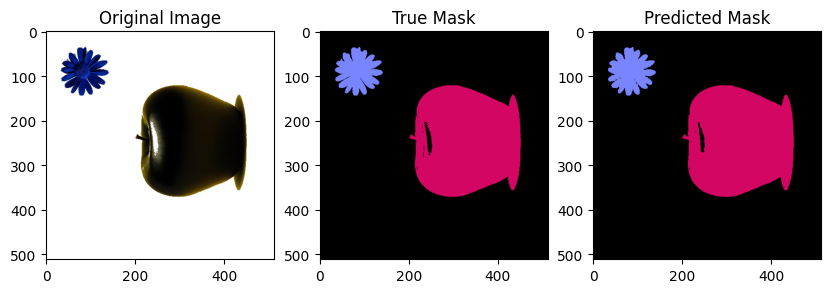

image156 IOU_apple: 0.9938858695652174
image156 IOU_flower: 0.9675968787197461
image156 IOU_back: 0.997313322216046


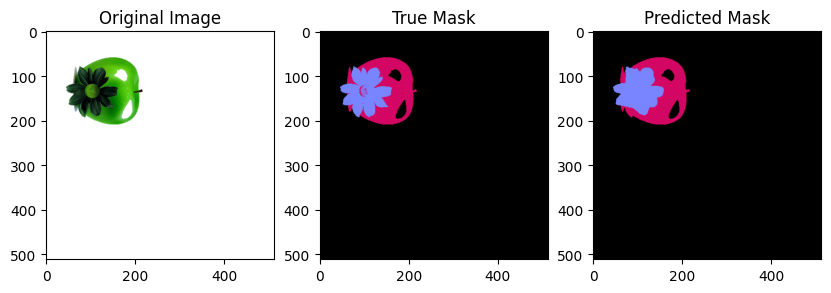

image157 IOU_apple: 0.8847385272145144
image157 IOU_flower: 0.8598864597173572
image157 IOU_back: 0.9992621106096197


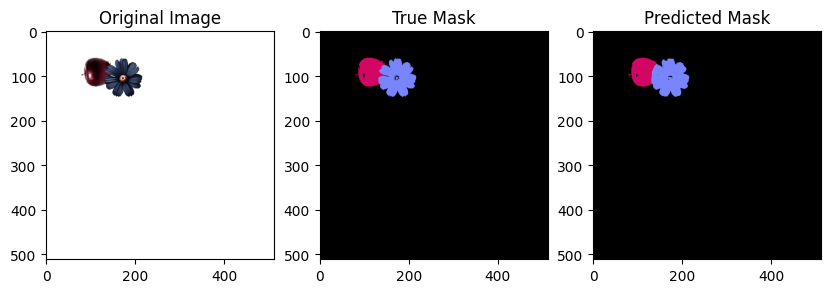

image158 IOU_apple: 0.9405050155655482
image158 IOU_flower: 0.950207468879668
image158 IOU_back: 0.9991426706203447


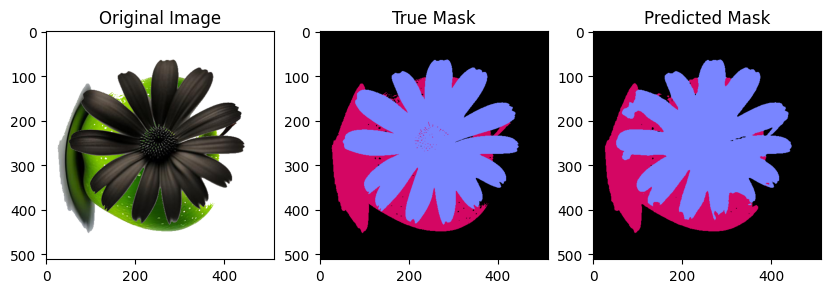

image159 IOU_apple: 0.8187310261080752
image159 IOU_flower: 0.934256739469216
image159 IOU_back: 0.9954208285354685


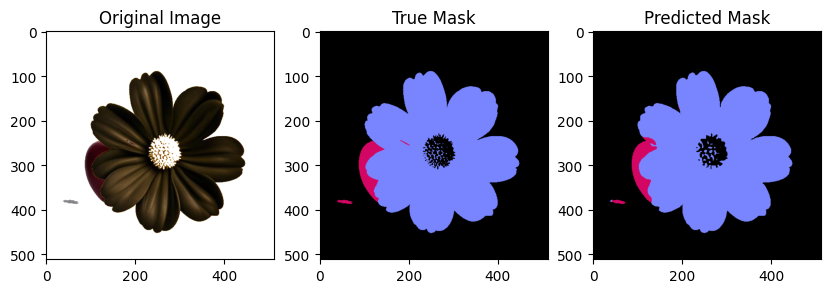

image160 IOU_apple: 0.8584729981378026
image160 IOU_flower: 0.982416127133608
image160 IOU_back: 0.9944031629419847


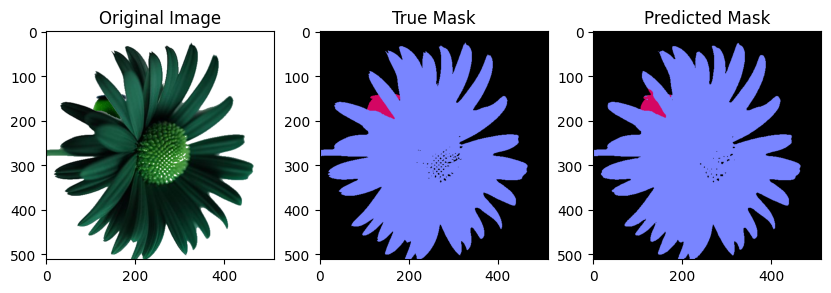

image161 IOU_apple: 0.8347156398104265
image161 IOU_flower: 0.990625662445336
image161 IOU_back: 0.9929039463886821


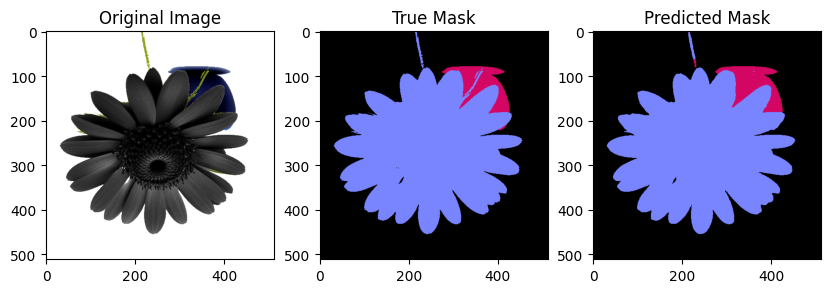

image162 IOU_apple: 0.8752455795677799
image162 IOU_flower: 0.9872526465696673
image162 IOU_back: 0.9968256411243002


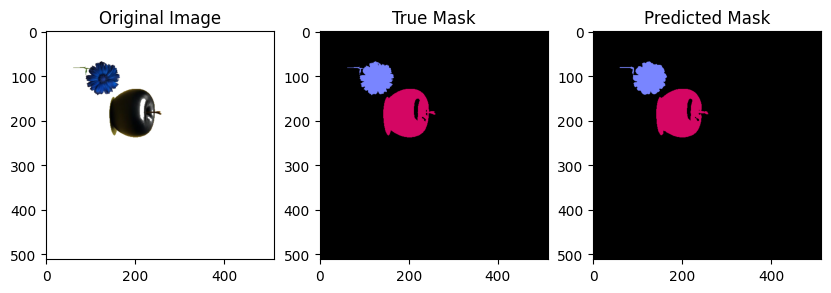

image163 IOU_apple: 0.9850581073602657
image163 IOU_flower: 0.9522024367385192
image163 IOU_back: 0.9986395376836023


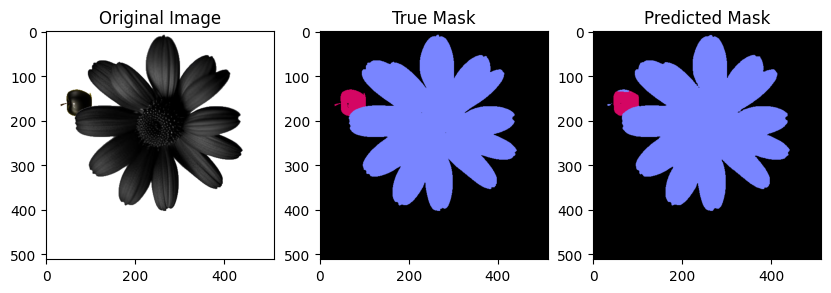

image164 IOU_apple: 0.9127701375245579
image164 IOU_flower: 0.9944968285847204
image164 IOU_back: 0.9978431110361787


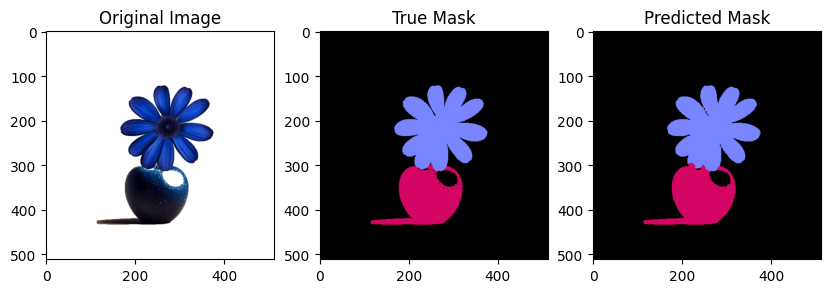

image165 IOU_apple: 0.9726832418469487
image165 IOU_flower: 0.9816122795249181
image165 IOU_back: 0.9981393630584726


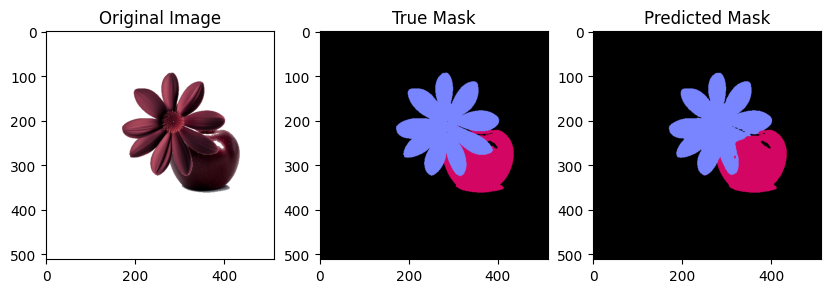

image166 IOU_apple: 0.8269455721461502
image166 IOU_flower: 0.913498912971869
image166 IOU_back: 0.9986134851074663


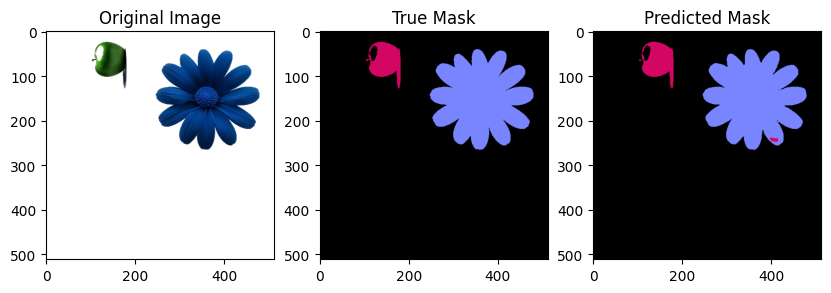

image167 IOU_apple: 0.9502911813643927
image167 IOU_flower: 0.9901053118851985
image167 IOU_back: 0.9985977896146834


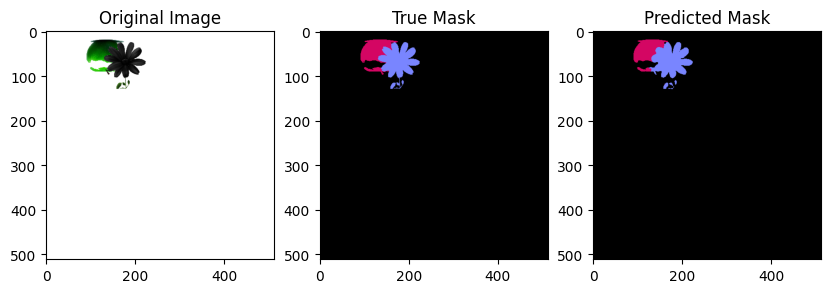

image168 IOU_apple: 0.8857044198895028
image168 IOU_flower: 0.9230919765166341
image168 IOU_back: 0.9989475089736641


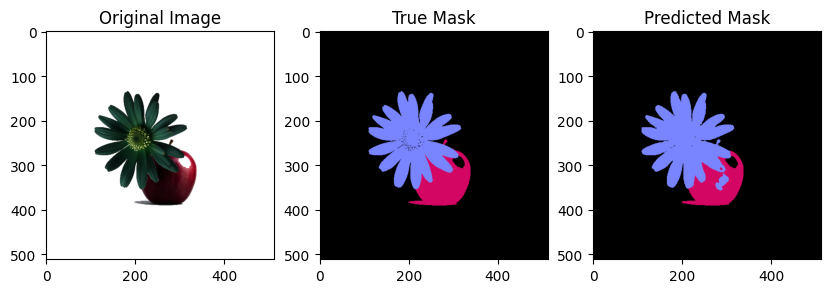

image169 IOU_apple: 0.8852512155591572
image169 IOU_flower: 0.9474140204166196
image169 IOU_back: 0.9979543818370178


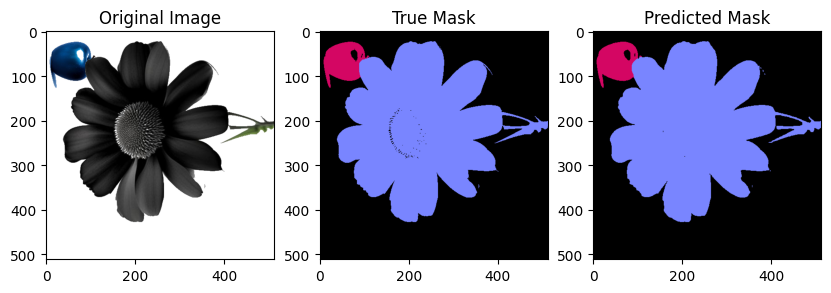

image170 IOU_apple: 0.9796818396597889
image170 IOU_flower: 0.9923608621170471
image170 IOU_back: 0.9949307133484815


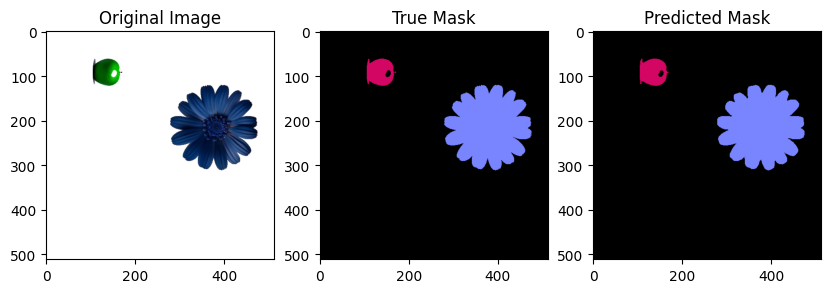

image171 IOU_apple: 0.9794050343249427
image171 IOU_flower: 0.9912026810876685
image171 IOU_back: 0.9987388523556436


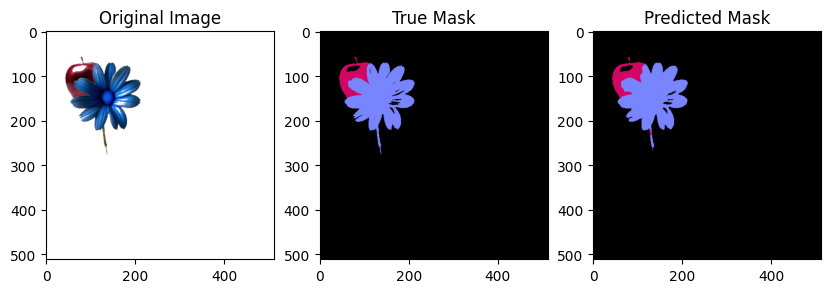

image172 IOU_apple: 0.8733668341708543
image172 IOU_flower: 0.9550377420413522
image172 IOU_back: 0.9982057831817718


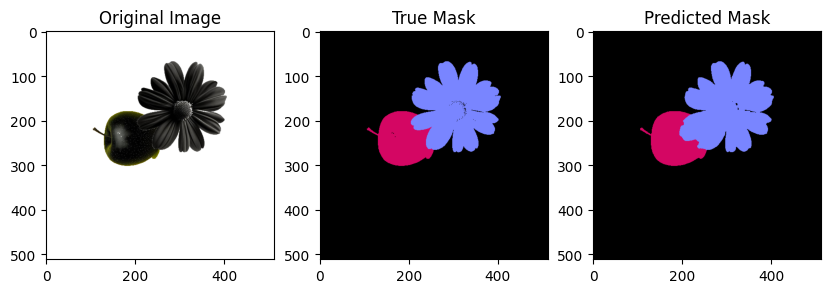

image173 IOU_apple: 0.8771163785421493
image173 IOU_flower: 0.9443276949047439
image173 IOU_back: 0.9983853148636016


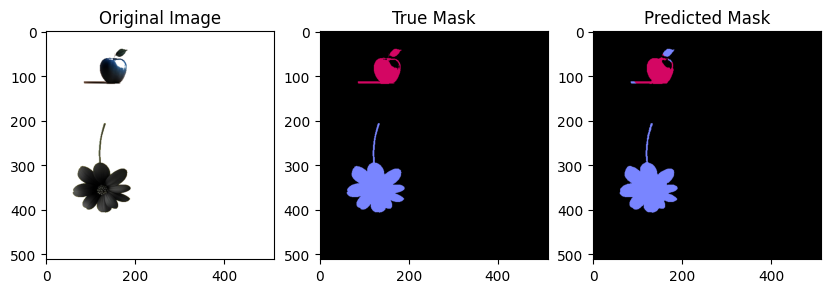

image174 IOU_apple: 0.8509124652025982
image174 IOU_flower: 0.9537054677081349
image174 IOU_back: 0.998955936504877


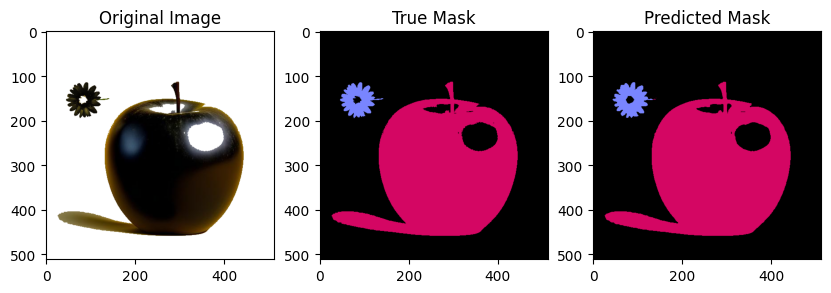

image175 IOU_apple: 0.9955631184218819
image175 IOU_flower: 0.9513393954288523
image175 IOU_back: 0.9969991744940987


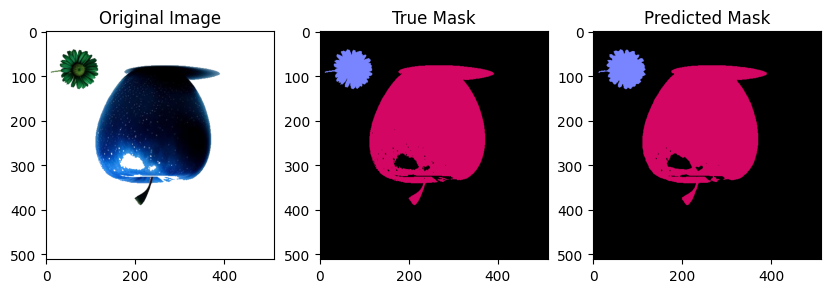

image176 IOU_apple: 0.9906027276726793
image176 IOU_flower: 0.966364586964099
image176 IOU_back: 0.9963705892924896


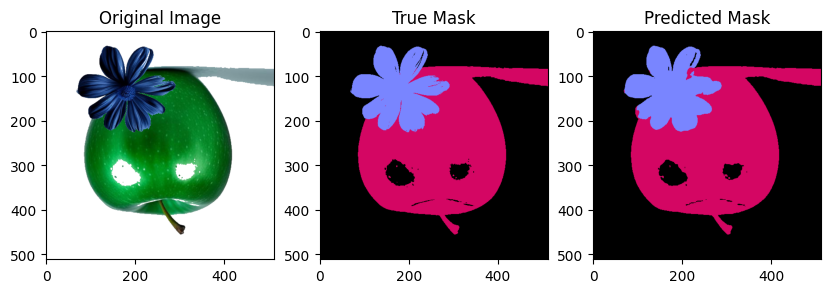

image177 IOU_apple: 0.9779479561520336
image177 IOU_flower: 0.9437932662051605
image177 IOU_back: 0.99544755344921


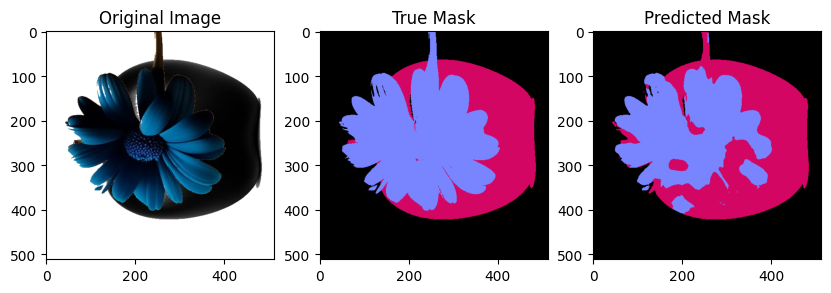

image178 IOU_apple: 0.6931689011382569
image178 IOU_flower: 0.7486884327407936
image178 IOU_back: 0.9963620708212249


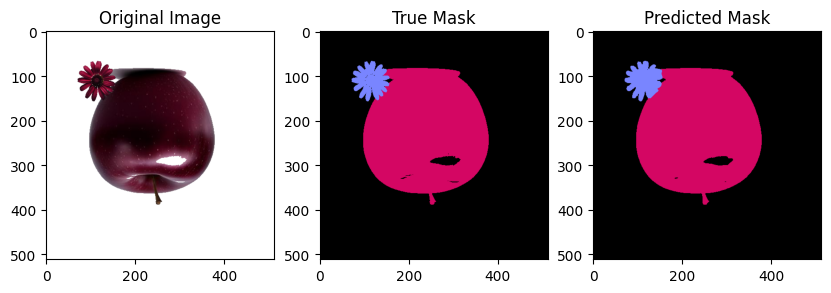

image179 IOU_apple: 0.9925396477837906
image179 IOU_flower: 0.9193296960249415
image179 IOU_back: 0.9980434569379842


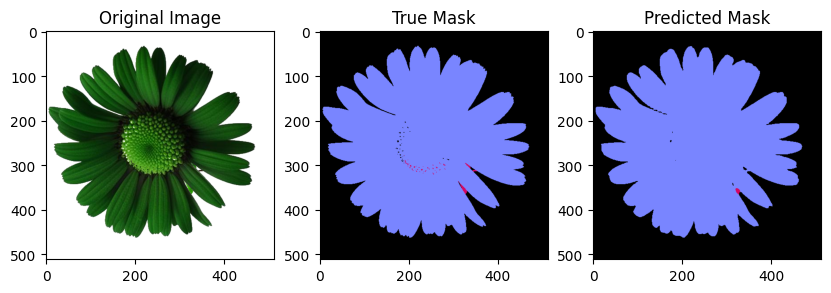

image180 IOU_apple: 0.21351351351351353
image180 IOU_flower: 0.9923133291604964
image180 IOU_back: 0.9944000121408951


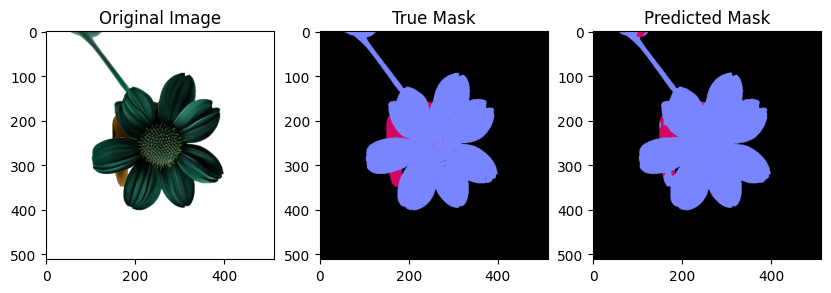

image181 IOU_apple: 0.447887323943662
image181 IOU_flower: 0.9766503891601807
image181 IOU_back: 0.9987935836523137


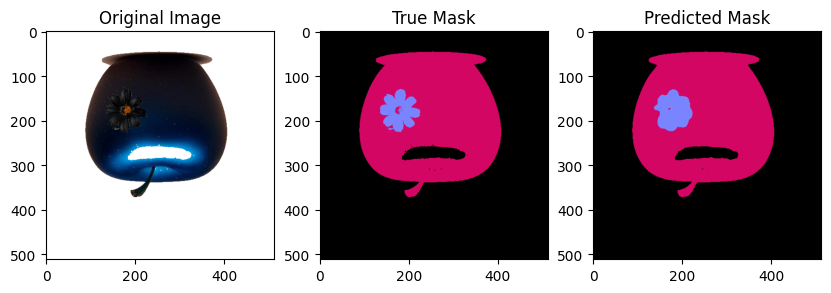

image182 IOU_apple: 0.9834434317250607
image182 IOU_flower: 0.8415475189234651
image182 IOU_back: 0.9986748045875464


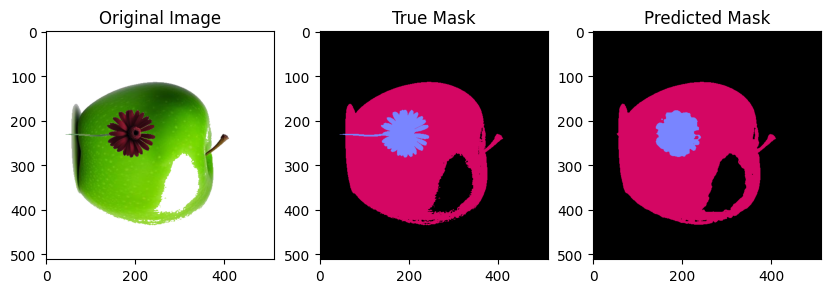

image183 IOU_apple: 0.9722486138487499
image183 IOU_flower: 0.8561151079136691
image183 IOU_back: 0.9958782601179801


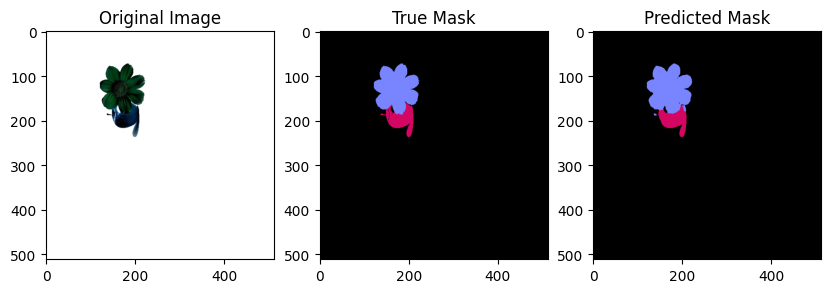

image184 IOU_apple: 0.8789047435403008
image184 IOU_flower: 0.9575898313370814
image184 IOU_back: 0.9993049680881062


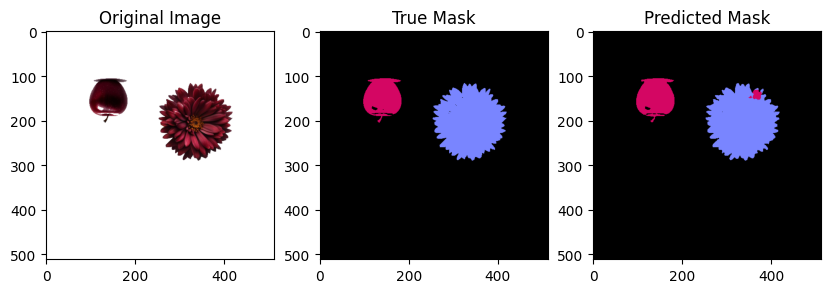

image185 IOU_apple: 0.9162690472525781
image185 IOU_flower: 0.9683654660489215
image185 IOU_back: 0.9982358316551876


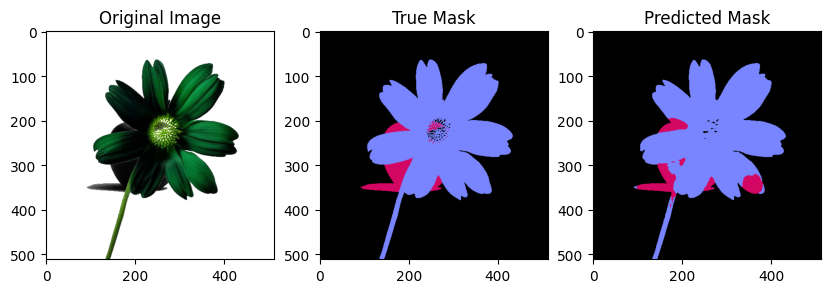

image186 IOU_apple: 0.4798348245010323
image186 IOU_flower: 0.9314359236695655
image186 IOU_back: 0.9962839970641524


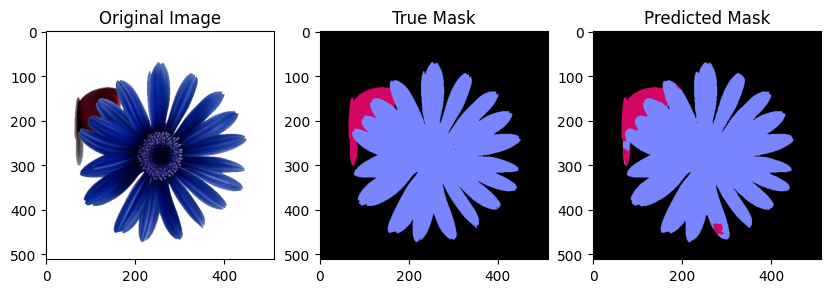

image187 IOU_apple: 0.8470533208606174
image187 IOU_flower: 0.9825105720500392
image187 IOU_back: 0.996012615724085


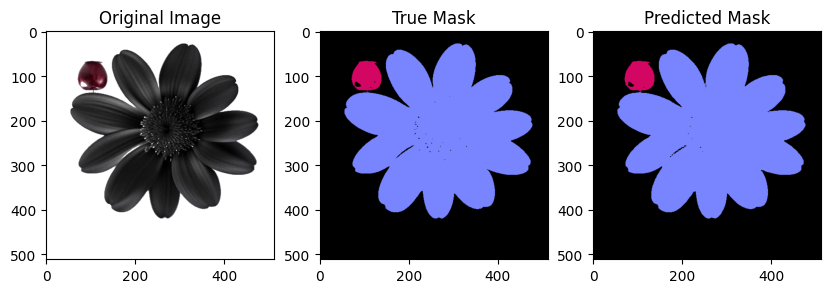

image188 IOU_apple: 0.9801176141136937
image188 IOU_flower: 0.9964964584797098
image188 IOU_back: 0.9971631021088041


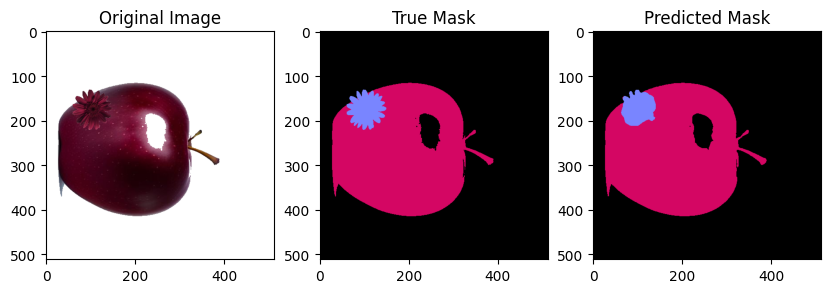

image189 IOU_apple: 0.9823026851098454
image189 IOU_flower: 0.822971741112124
image189 IOU_back: 0.9983763743964291


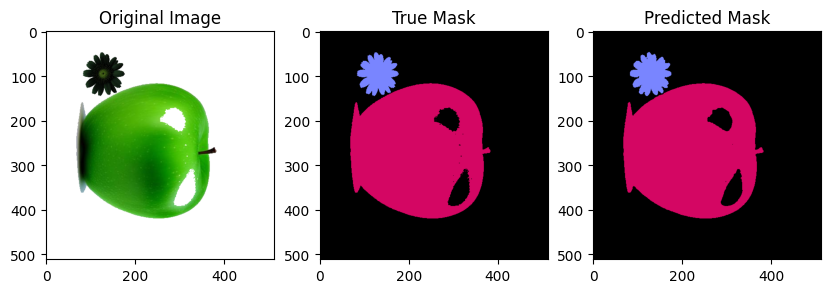

image190 IOU_apple: 0.9948361497657272
image190 IOU_flower: 0.968812541694463
image190 IOU_back: 0.9970155846814379


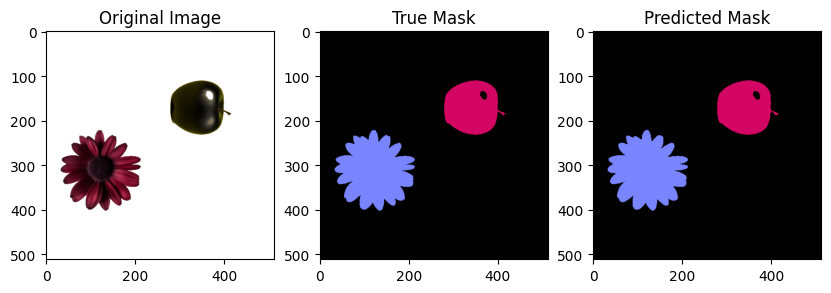

image191 IOU_apple: 0.9939504433579183
image191 IOU_flower: 0.990724610386553
image191 IOU_back: 0.9988215164900396


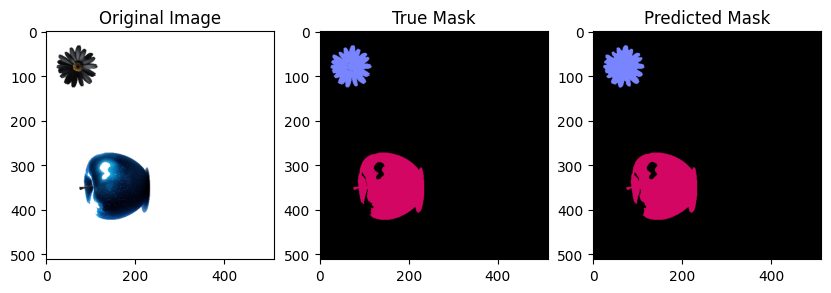

image192 IOU_apple: 0.9905682212706862
image192 IOU_flower: 0.9694950911640954
image192 IOU_back: 0.9985928725025575


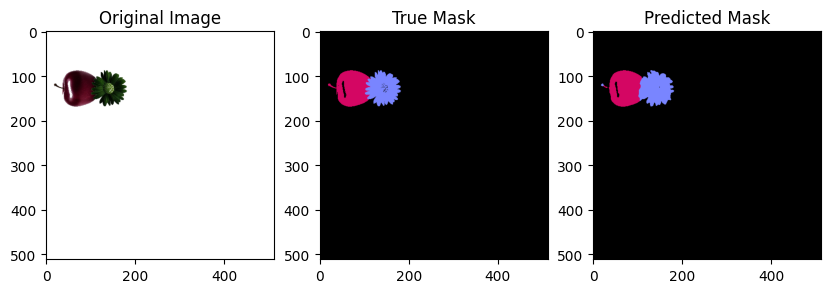

image193 IOU_apple: 0.9486294416243655
image193 IOU_flower: 0.9212821631051025
image193 IOU_back: 0.9989647174113193


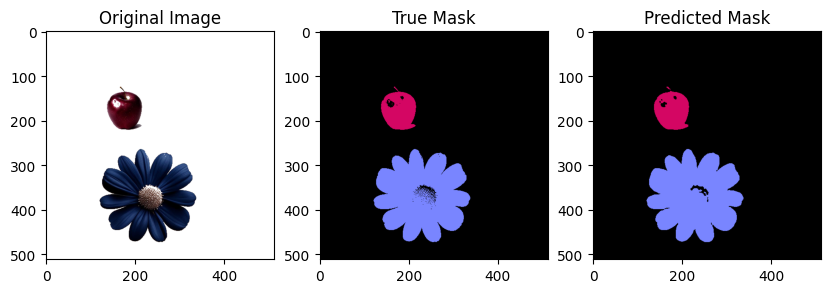

image194 IOU_apple: 0.9704570791527313
image194 IOU_flower: 0.9787866068257403
image194 IOU_back: 0.9963990521034214


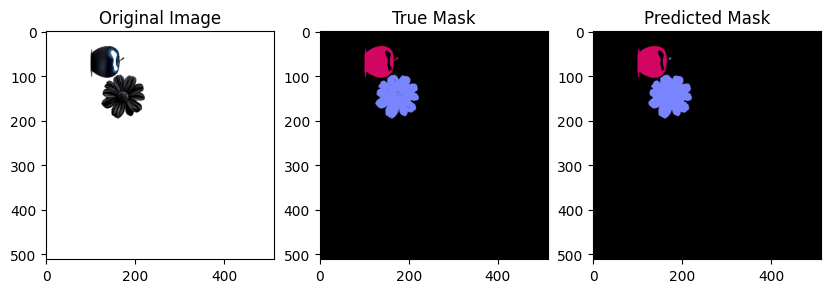

image195 IOU_apple: 0.975354942405572
image195 IOU_flower: 0.9787171149866982
image195 IOU_back: 0.9991979798621479


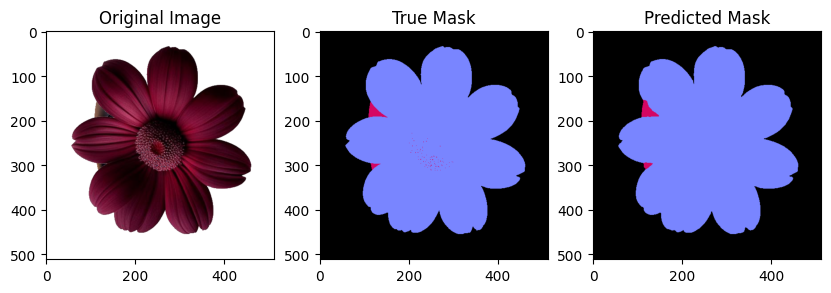

image196 IOU_apple: 0.6794300979519146
image196 IOU_flower: 0.9953185955786736
image196 IOU_back: 0.9985091978390207


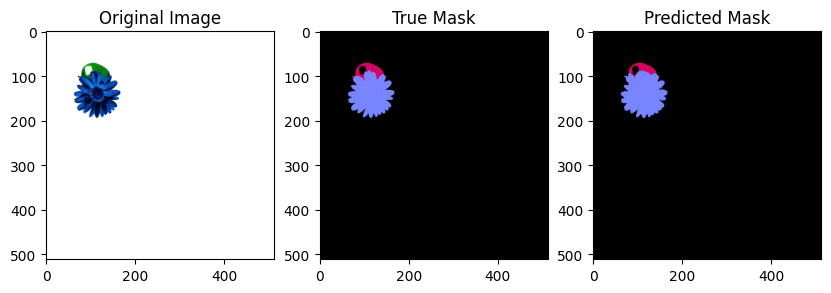

image197 IOU_apple: 0.7421665174574754
image197 IOU_flower: 0.9466393022062596
image197 IOU_back: 0.999290425074801


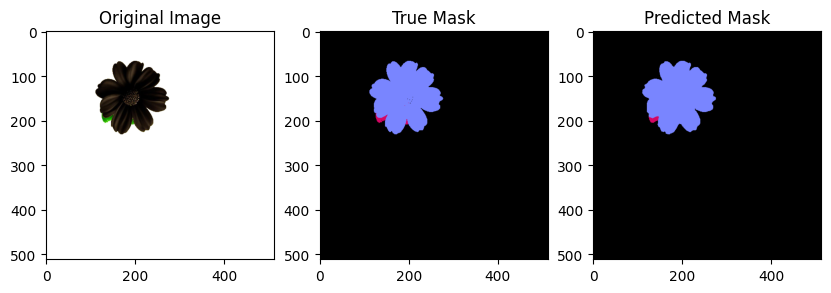

image198 IOU_apple: 0.6468646864686468
image198 IOU_flower: 0.9876639253167371
image198 IOU_back: 0.9993813630497572


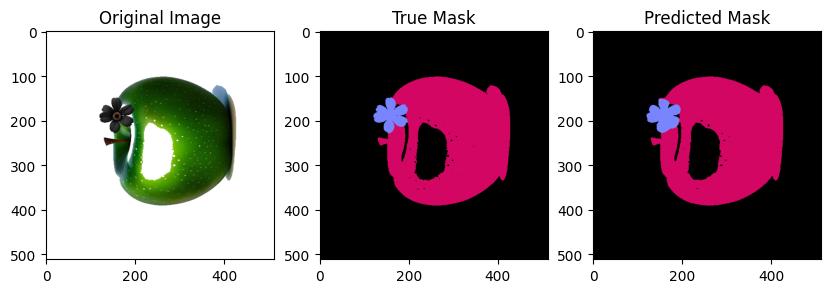

image199 IOU_apple: 0.9888160965238284
image199 IOU_flower: 0.9159533073929961
image199 IOU_back: 0.9978472705578204


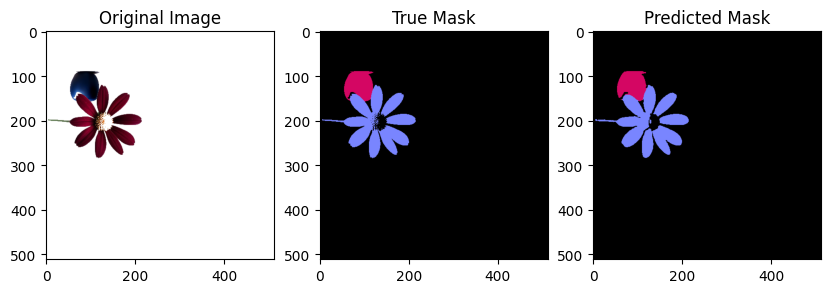

image200 IOU_apple: 0.95937318630296
image200 IOU_flower: 0.957353056888819
image200 IOU_back: 0.9977535106464942


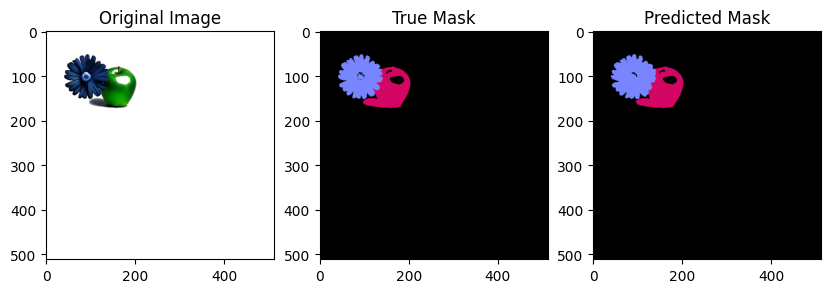

image201 IOU_apple: 0.9656705798648167
image201 IOU_flower: 0.9536652835408023
image201 IOU_back: 0.9988065917782984


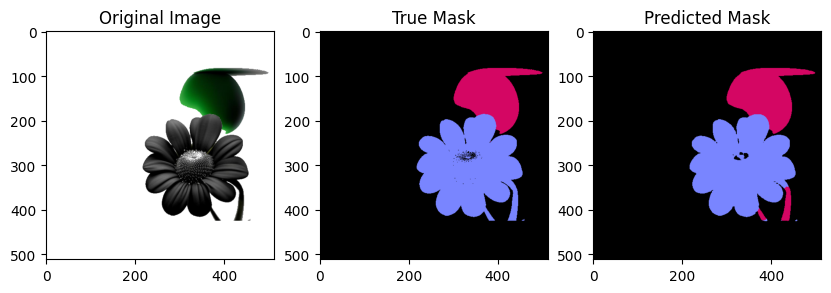

image202 IOU_apple: 0.9160608467224632
image202 IOU_flower: 0.9526247421104913
image202 IOU_back: 0.99707344220768


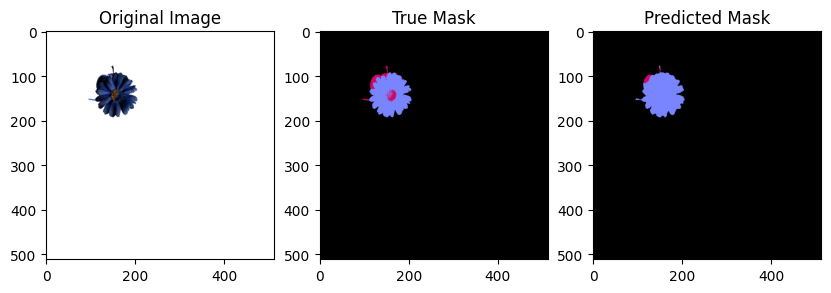

image203 IOU_apple: 0.22588235294117648
image203 IOU_flower: 0.8921610470906246
image203 IOU_back: 0.9993805184825055


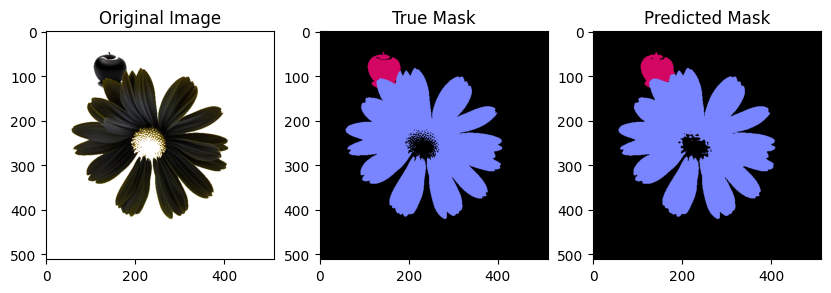

image204 IOU_apple: 0.9454015372382719
image204 IOU_flower: 0.9806140087715539
image204 IOU_back: 0.9929565593029259


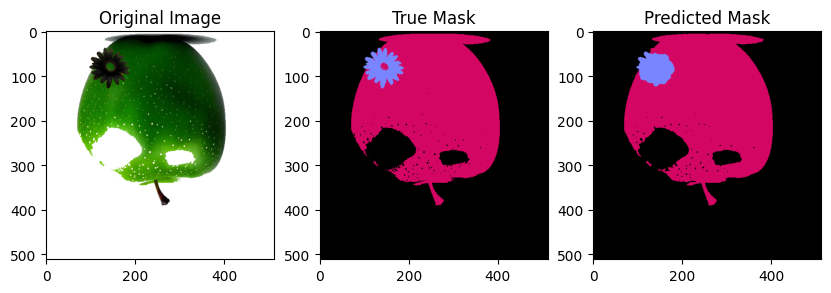

image205 IOU_apple: 0.9761036755892929
image205 IOU_flower: 0.8005448530842576
image205 IOU_back: 0.9947608850022644


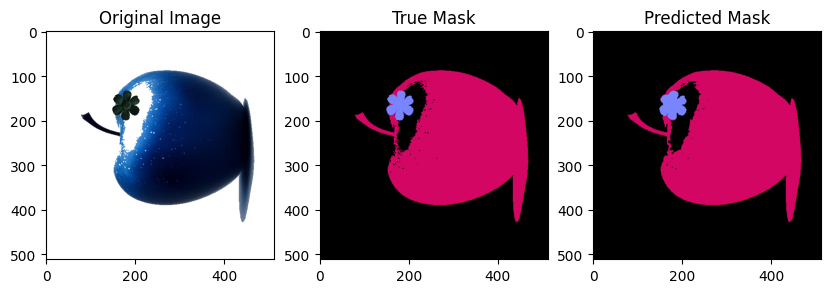

image206 IOU_apple: 0.9878298901158605
image206 IOU_flower: 0.9365526965103983
image206 IOU_back: 0.9956704853557382


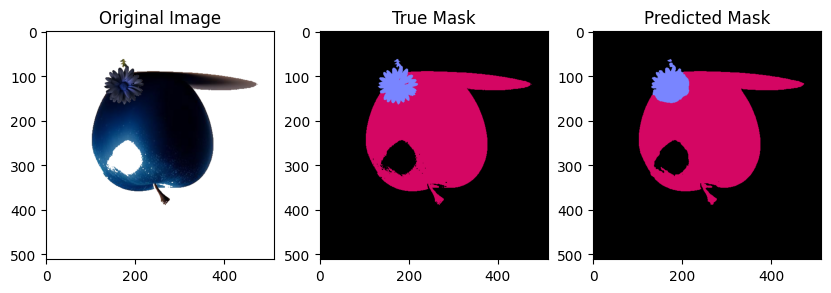

image207 IOU_apple: 0.9849976477147985
image207 IOU_flower: 0.9047443234262507
image207 IOU_back: 0.9970397511993251


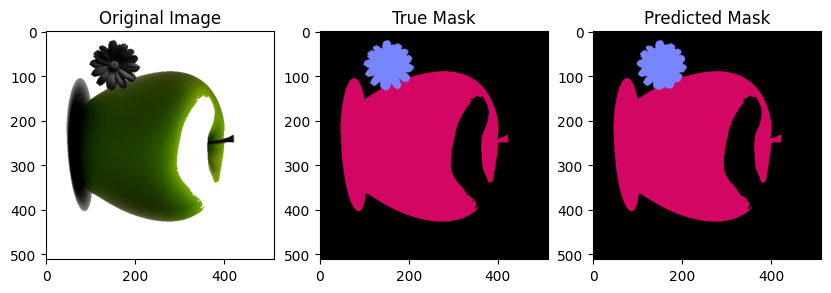

image208 IOU_apple: 0.994934036939314
image208 IOU_flower: 0.9658169177288528
image208 IOU_back: 0.9976836218438607


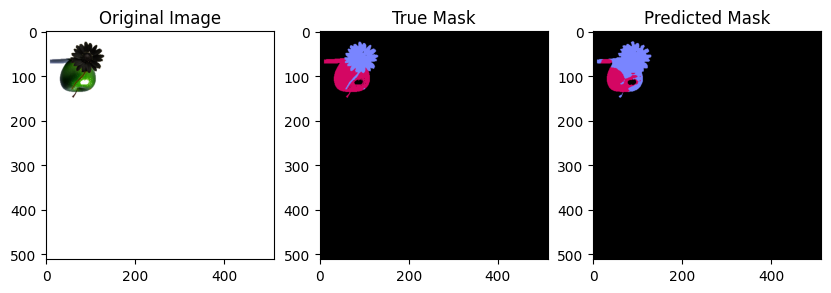

image209 IOU_apple: 0.5798845043310876
image209 IOU_flower: 0.6666047893075924
image209 IOU_back: 0.9991983463929517


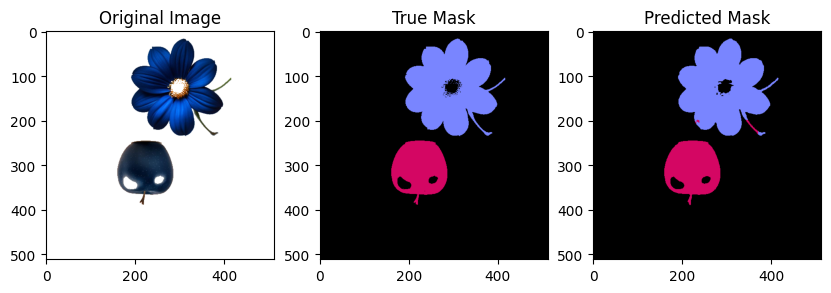

image210 IOU_apple: 0.9768720685751253
image210 IOU_flower: 0.9777027259882138
image210 IOU_back: 0.9974763777216973


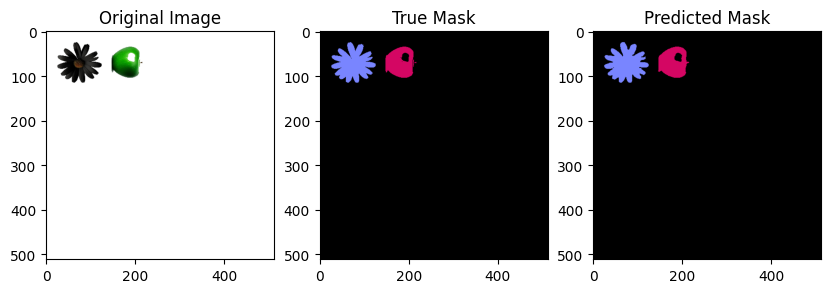

image211 IOU_apple: 0.9769746429612358
image211 IOU_flower: 0.9707720588235295
image211 IOU_back: 0.9990611847217675


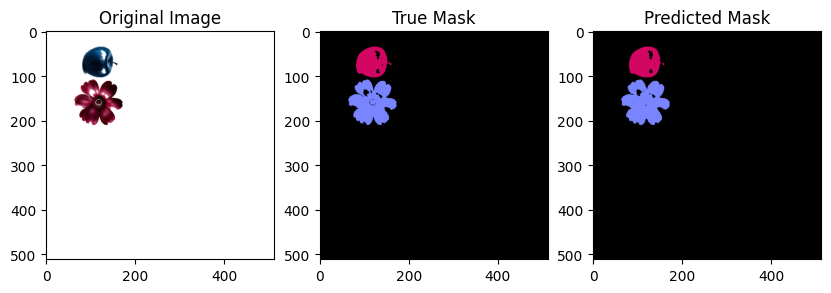

image212 IOU_apple: 0.9747102212855637
image212 IOU_flower: 0.9729952021932831
image212 IOU_back: 0.9988342762566342


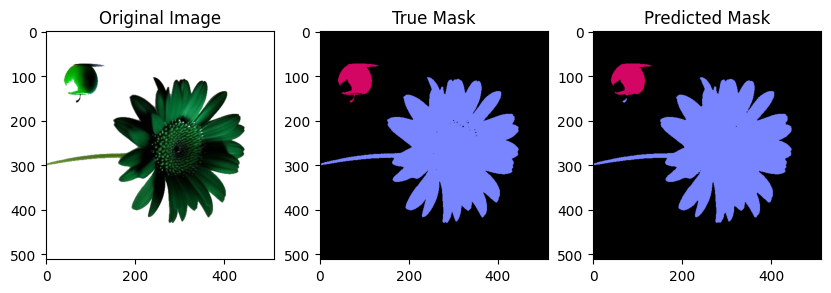

image213 IOU_apple: 0.9566666666666667
image213 IOU_flower: 0.9930295331851381
image213 IOU_back: 0.9972129462482165


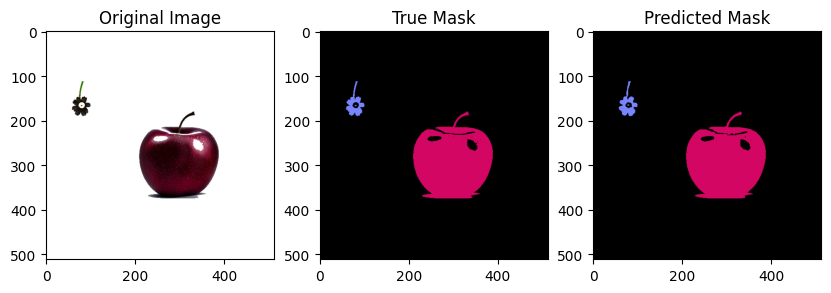

image214 IOU_apple: 0.9888353209845216
image214 IOU_flower: 0.9130769230769231
image214 IOU_back: 0.9984131326949385


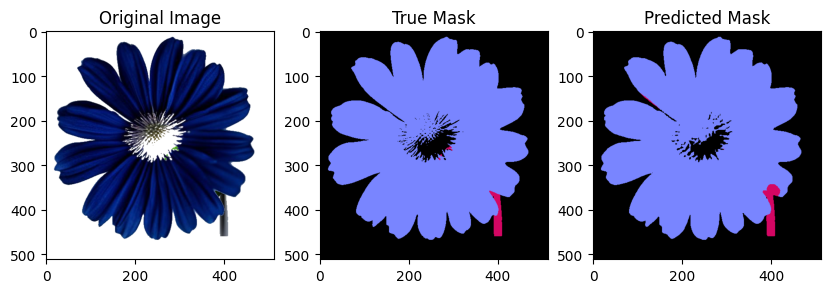

image215 IOU_apple: 0.6213550600343053
image215 IOU_flower: 0.9814231395980445
image215 IOU_back: 0.9854781126370975


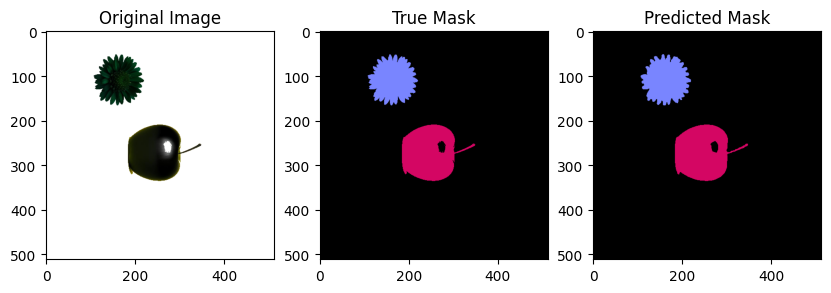

image216 IOU_apple: 0.9893801132787917
image216 IOU_flower: 0.9714766984839978
image216 IOU_back: 0.9983853293264042


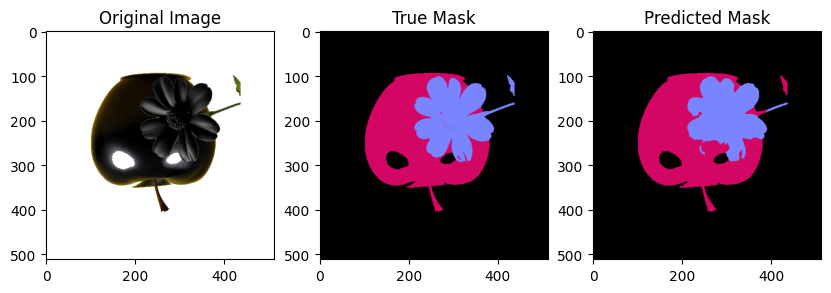

image217 IOU_apple: 0.9147253953209956
image217 IOU_flower: 0.8659243504733308
image217 IOU_back: 0.9985213633228638


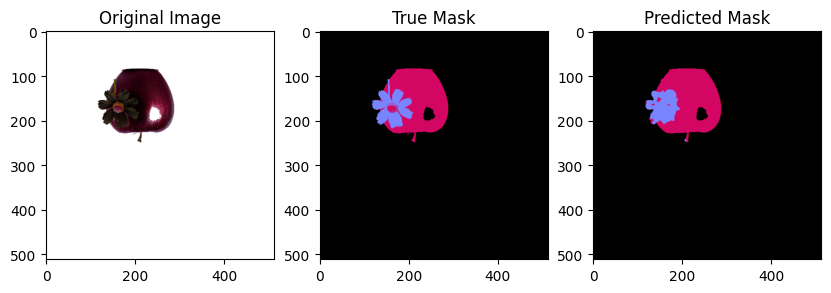

image218 IOU_apple: 0.868389231846242
image218 IOU_flower: 0.6338369707144189
image218 IOU_back: 0.9992967911469707


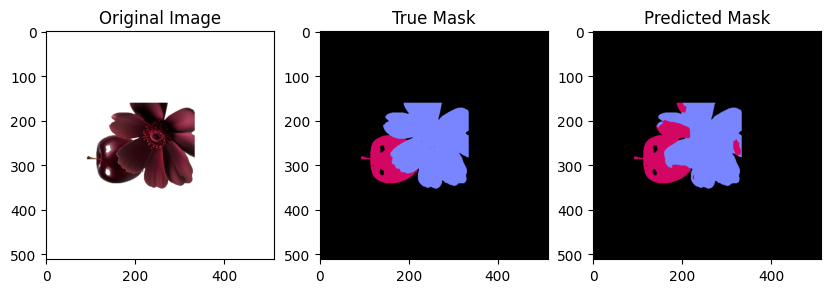

image219 IOU_apple: 0.611594796681348
image219 IOU_flower: 0.863879995683298
image219 IOU_back: 0.9993958999995622


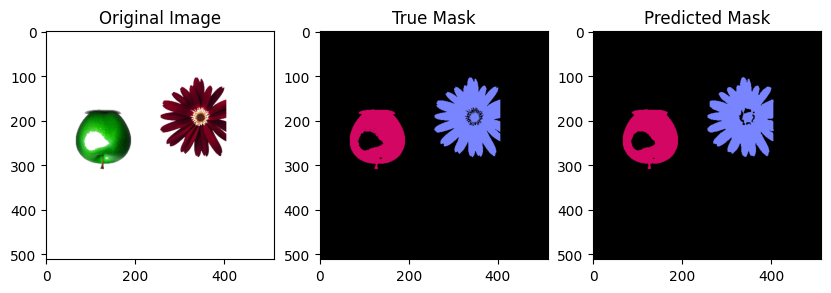

image220 IOU_apple: 0.987088444157521
image220 IOU_flower: 0.9618576625738973
image220 IOU_back: 0.996541872761385


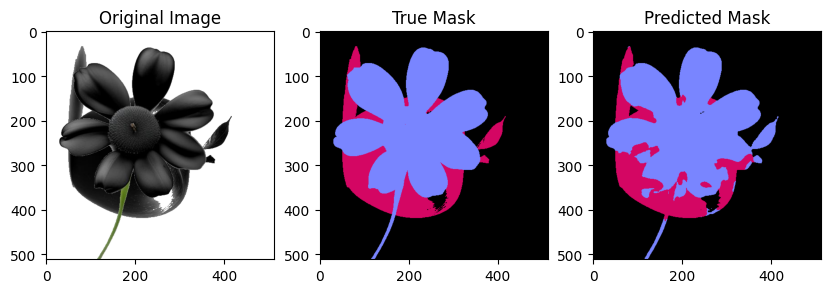

image221 IOU_apple: 0.6039673115876231
image221 IOU_flower: 0.852890355010996
image221 IOU_back: 0.9969051628050372


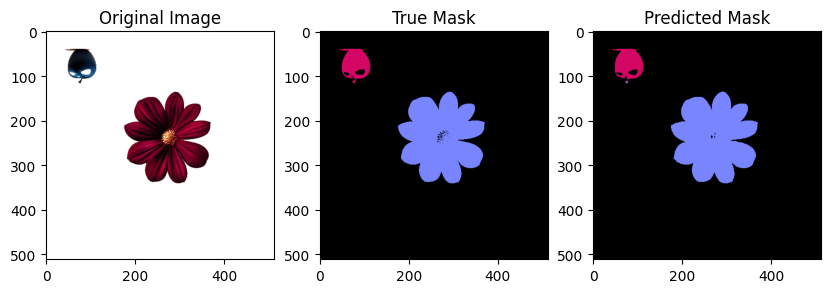

image222 IOU_apple: 0.963233148526408
image222 IOU_flower: 0.98991565823249
image222 IOU_back: 0.9983910901765919


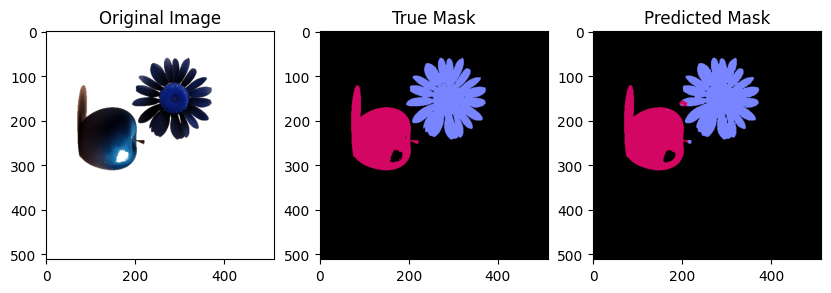

image223 IOU_apple: 0.9794301031408426
image223 IOU_flower: 0.9685276278714361
image223 IOU_back: 0.9975181137664625


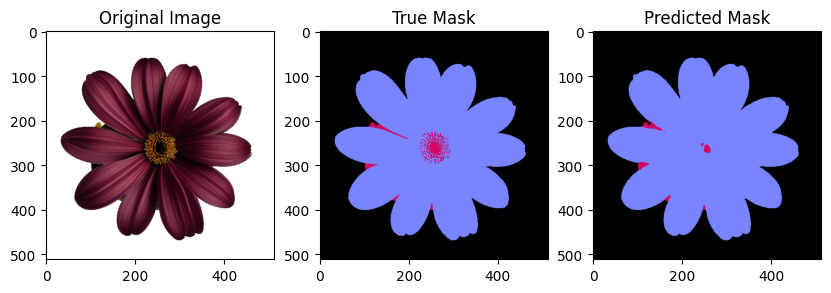

image224 IOU_apple: 0.28505291005291006
image224 IOU_flower: 0.9790347819901842
image224 IOU_back: 0.9982152562046686


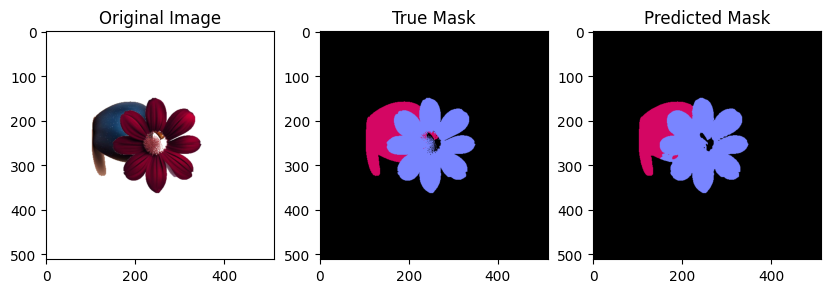

image225 IOU_apple: 0.9115424973767051
image225 IOU_flower: 0.9548227220739611
image225 IOU_back: 0.9981371644479592


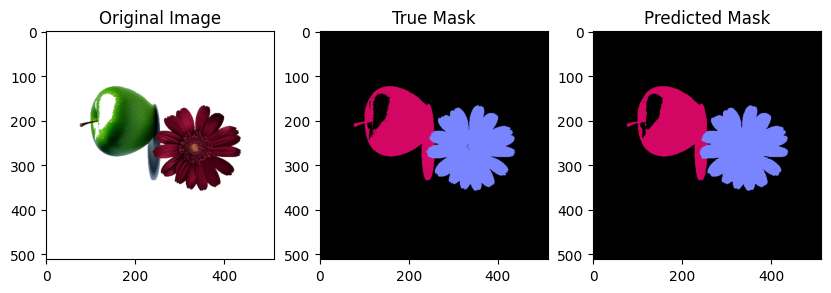

image226 IOU_apple: 0.9763354333209805
image226 IOU_flower: 0.9865501008742434
image226 IOU_back: 0.9972789675625494


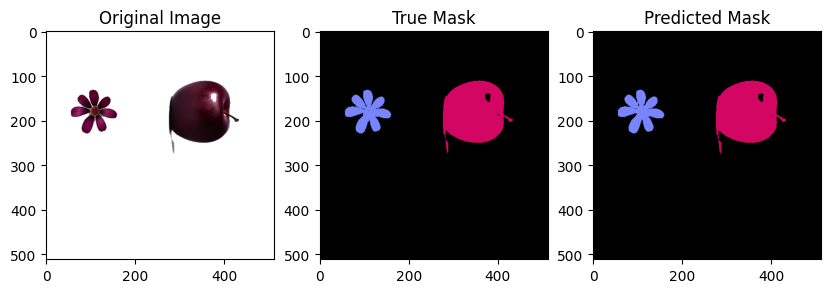

image227 IOU_apple: 0.9945368608434104
image227 IOU_flower: 0.9775451950523311
image227 IOU_back: 0.999140383297689


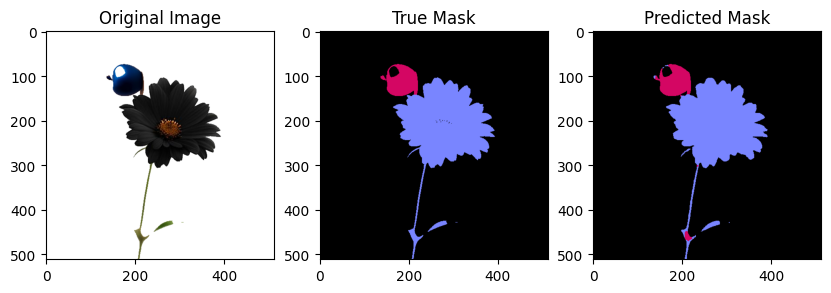

image228 IOU_apple: 0.9120644702536146
image228 IOU_flower: 0.9770398108001577
image228 IOU_back: 0.9979408633478057


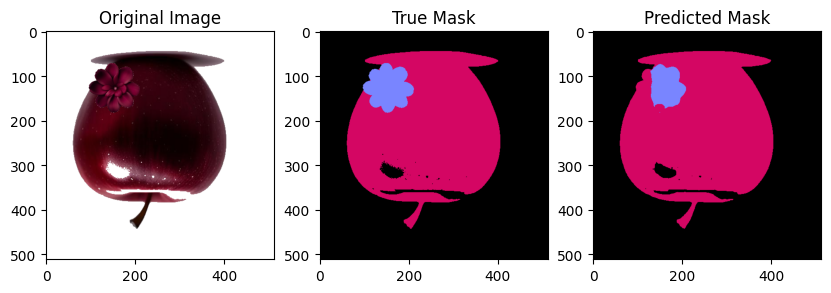

image229 IOU_apple: 0.9651377159573881
image229 IOU_flower: 0.6761190531989688
image229 IOU_back: 0.9975930583803689


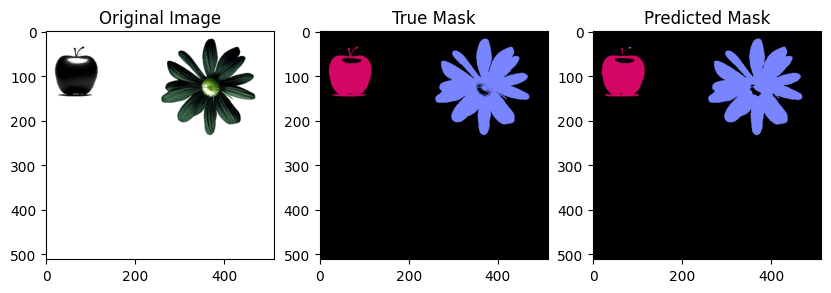

image230 IOU_apple: 0.9650377969762419
image230 IOU_flower: 0.9797043347531947
image230 IOU_back: 0.9969117138908086


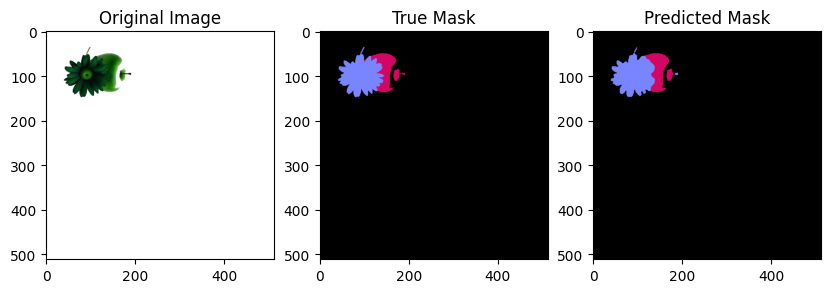

image231 IOU_apple: 0.8631997350115932
image231 IOU_flower: 0.9329889298892989
image231 IOU_back: 0.9991656418428638


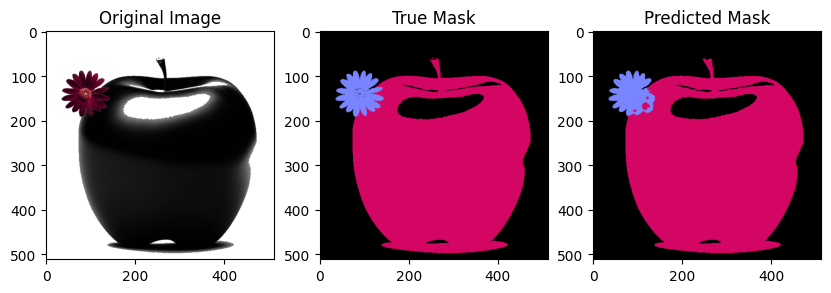

image232 IOU_apple: 0.9894475382862928
image232 IOU_flower: 0.868381855111713
image232 IOU_back: 0.9950699451531398


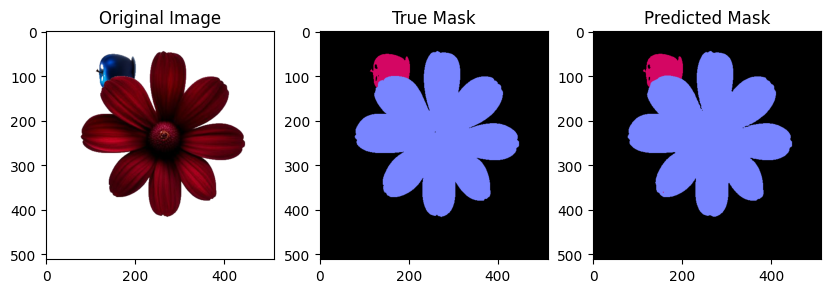

image233 IOU_apple: 0.9731314118221788
image233 IOU_flower: 0.9966268482588957
image233 IOU_back: 0.9984959474138652


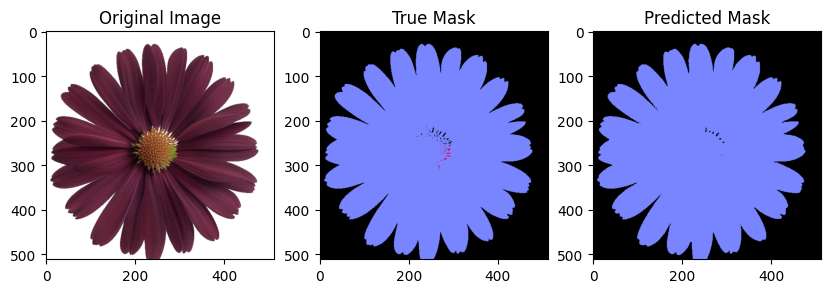

image234 IOU_apple: 0.005988023952095809
image234 IOU_flower: 0.9938655011118779
image234 IOU_back: 0.9925407487434825


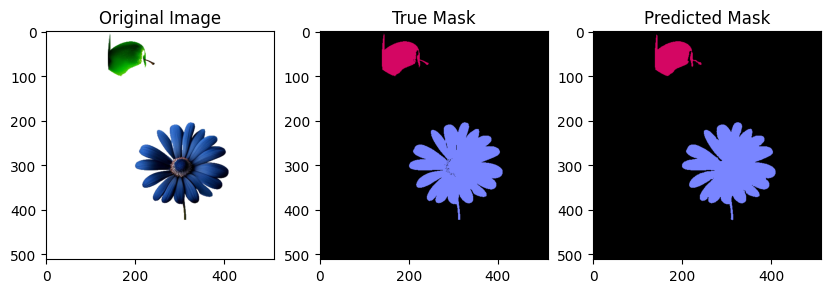

image235 IOU_apple: 0.9775416081812713
image235 IOU_flower: 0.9861049400169649
image235 IOU_back: 0.9980417081801628


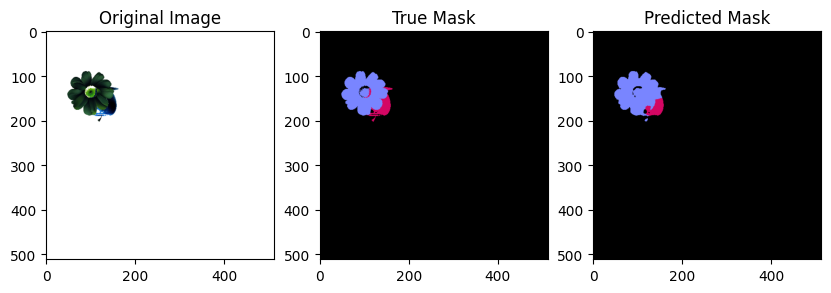

image236 IOU_apple: 0.6310122038765255
image236 IOU_flower: 0.9171930788244987
image236 IOU_back: 0.9990124059129737


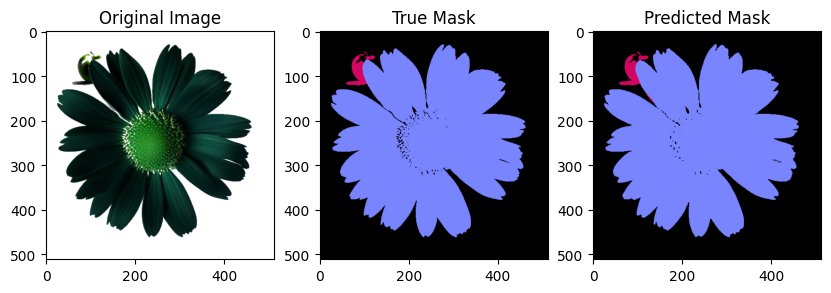

image237 IOU_apple: 0.8893048128342246
image237 IOU_flower: 0.989293706631462
image237 IOU_back: 0.9902318747817992


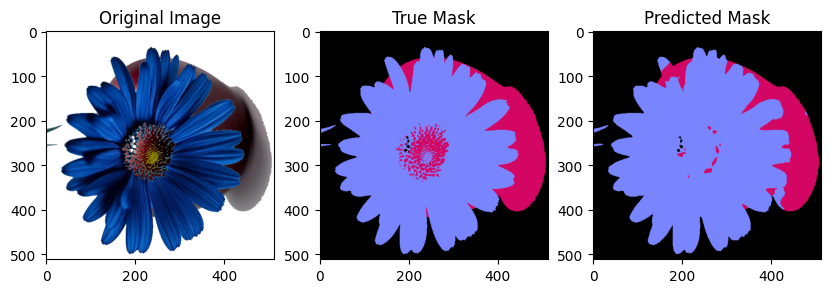

image238 IOU_apple: 0.718697271656426
image238 IOU_flower: 0.9273373331622177
image238 IOU_back: 0.9947706183331888


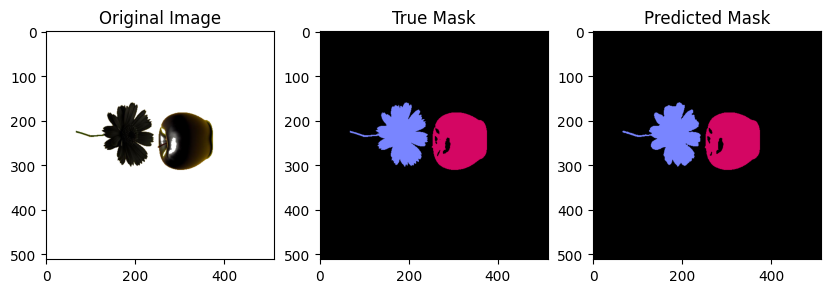

image239 IOU_apple: 0.989749250906797
image239 IOU_flower: 0.971379713797138
image239 IOU_back: 0.9981239452426518


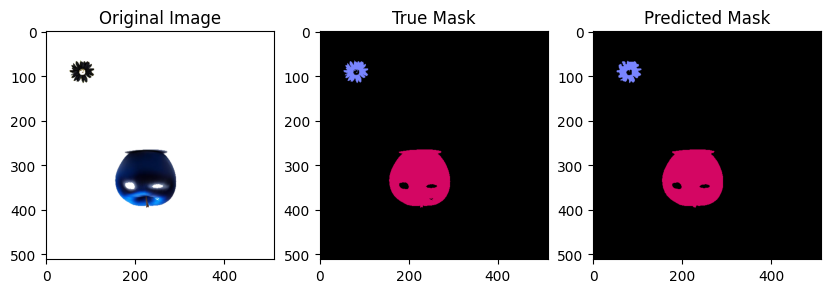

image240 IOU_apple: 0.992274434757956
image240 IOU_flower: 0.8861047835990888
image240 IOU_back: 0.9987468976592535


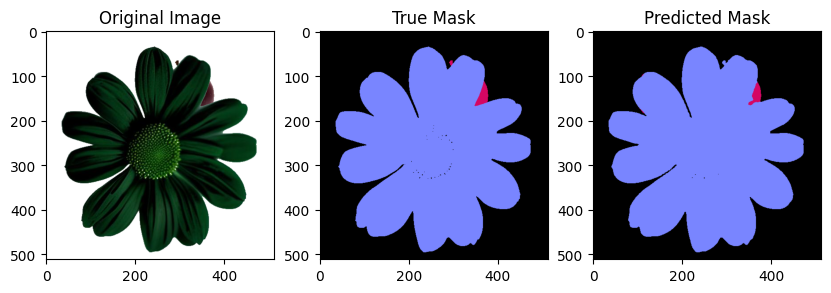

image241 IOU_apple: 0.7438524590163934
image241 IOU_flower: 0.9950811759207472
image241 IOU_back: 0.9968013403906935


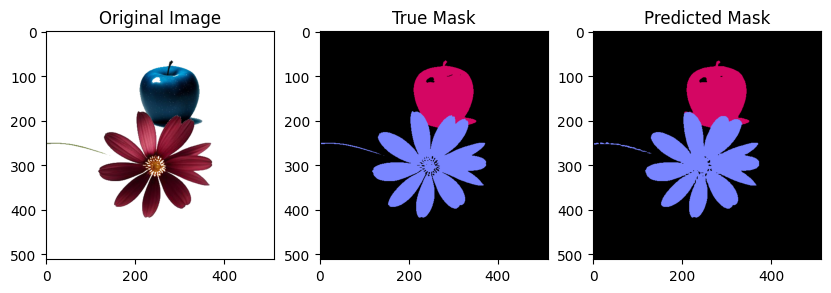

image242 IOU_apple: 0.982944657152802
image242 IOU_flower: 0.9726679439588073
image242 IOU_back: 0.9960998077762404


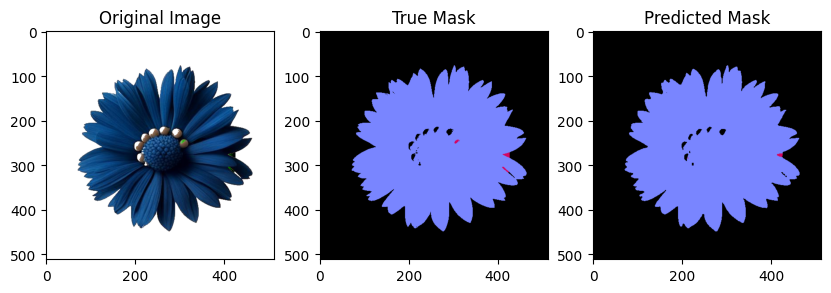

image243 IOU_apple: 0.3422222222222222
image243 IOU_flower: 0.9920395221637555
image243 IOU_back: 0.9962425903882456


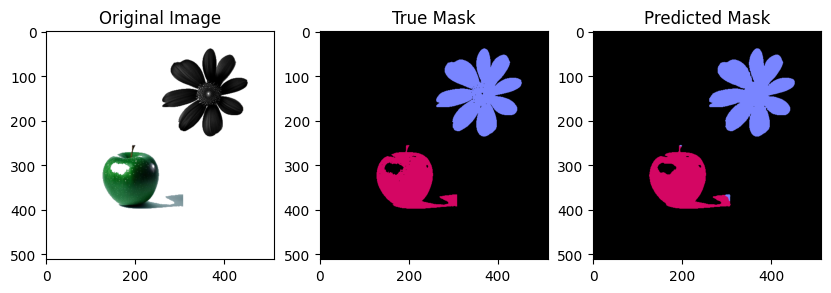

image244 IOU_apple: 0.9787328640237125
image244 IOU_flower: 0.9823875676948434
image244 IOU_back: 0.9979866125084439


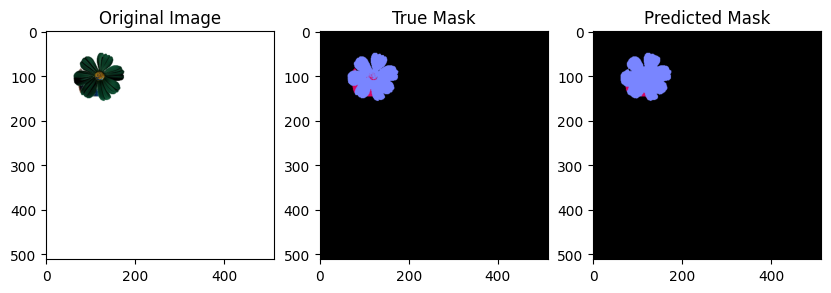

image245 IOU_apple: 0.3310104529616725
image245 IOU_flower: 0.9651218923485397
image245 IOU_back: 0.9995312580011108


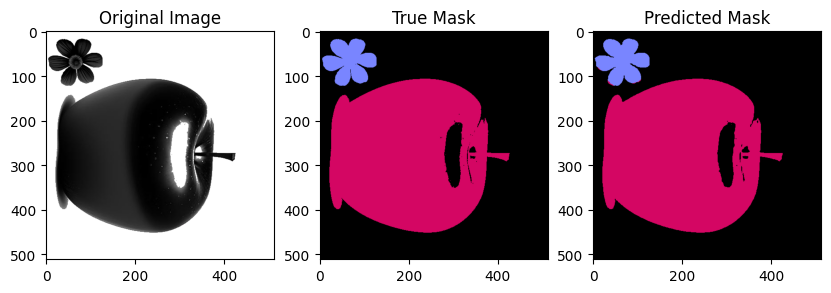

image246 IOU_apple: 0.9945944307480904
image246 IOU_flower: 0.9771414821944177
image246 IOU_back: 0.9962511413763391


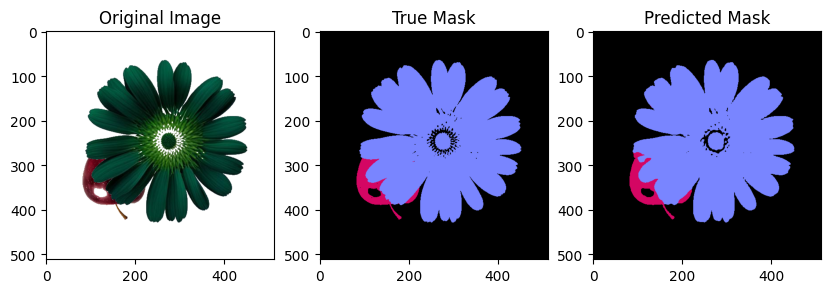

image247 IOU_apple: 0.8502095742333995
image247 IOU_flower: 0.9779293019917459
image247 IOU_back: 0.9914192541847998


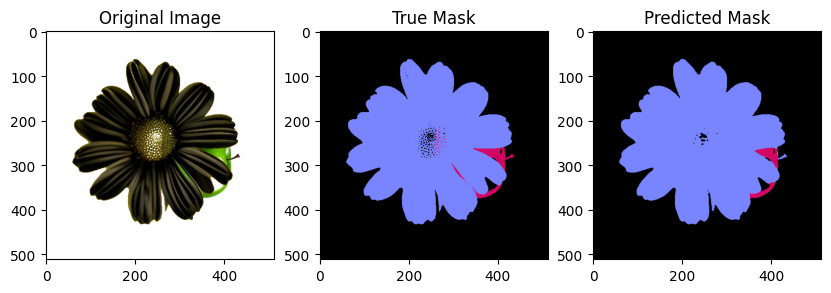

image248 IOU_apple: 0.6325891108499804
image248 IOU_flower: 0.9801695564925256
image248 IOU_back: 0.9942859127776716


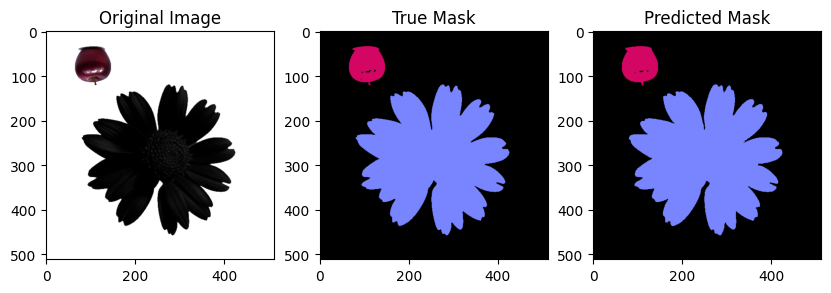

image249 IOU_apple: 0.984106686152722
image249 IOU_flower: 0.9944708182072047
image249 IOU_back: 0.9973966895377103


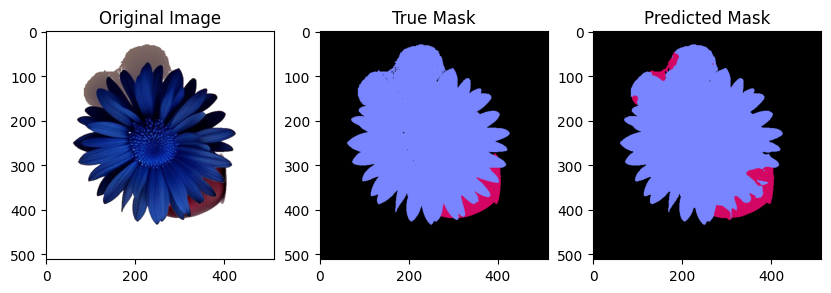

image250 IOU_apple: 0.5075930654481925
image250 IOU_flower: 0.957429667790286
image250 IOU_back: 0.9968867999100091


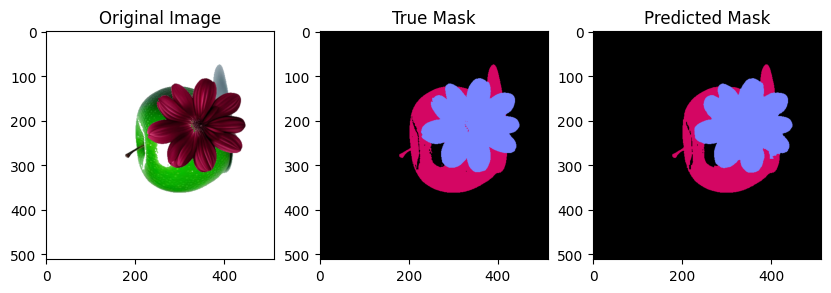

image251 IOU_apple: 0.9431287256323506
image251 IOU_flower: 0.9744332985930172
image251 IOU_back: 0.9982237263416709


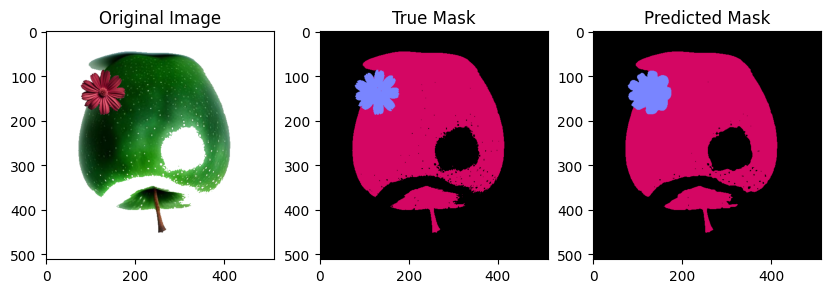

image252 IOU_apple: 0.9816292356185973
image252 IOU_flower: 0.9338214183175424
image252 IOU_back: 0.9934989088878633


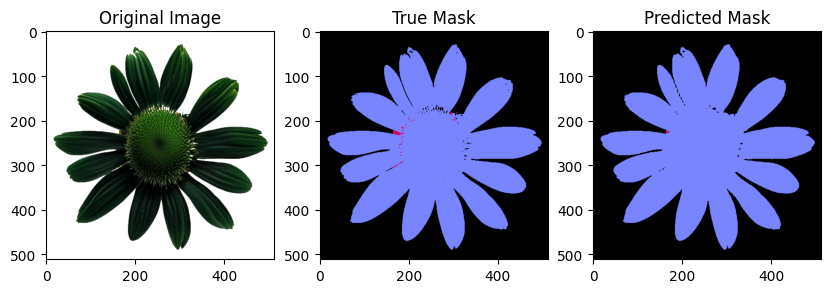

image253 IOU_apple: 0.08991825613079019
image253 IOU_flower: 0.98867348785891
image253 IOU_back: 0.9932963020879367


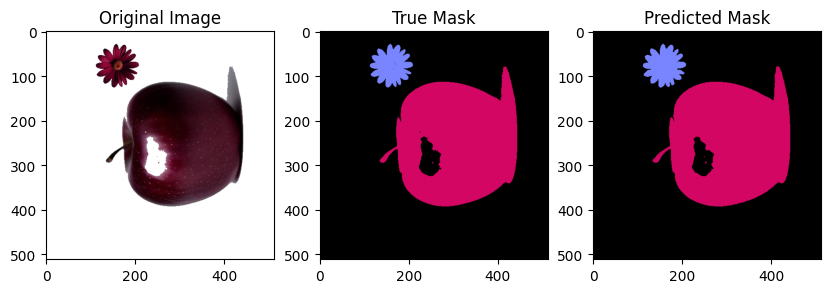

image254 IOU_apple: 0.9963476291487903
image254 IOU_flower: 0.9756057359485742
image254 IOU_back: 0.9980542437614514


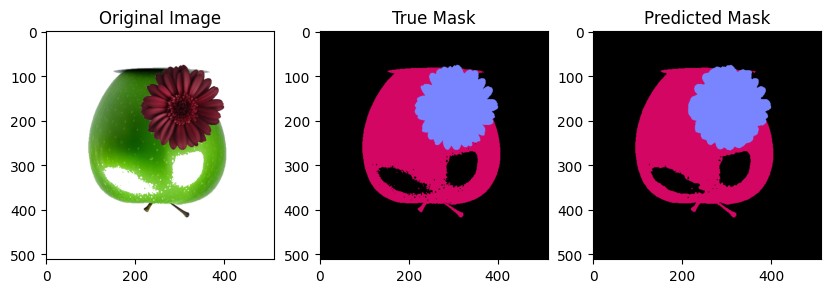

image255 IOU_apple: 0.9719371812188778
image255 IOU_flower: 0.9784976042450402
image255 IOU_back: 0.9949822231877454


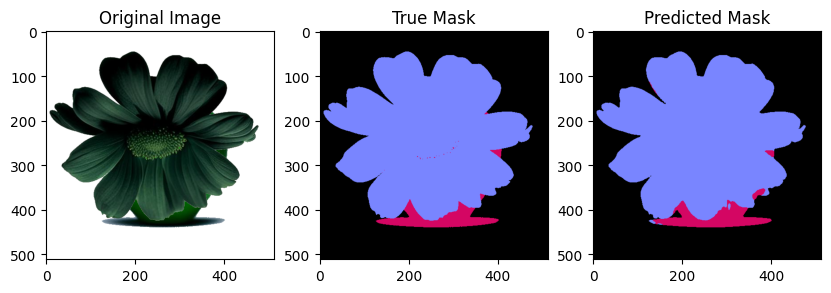

image256 IOU_apple: 0.8439897698209718
image256 IOU_flower: 0.9877287744506791
image256 IOU_back: 0.9978795980455425


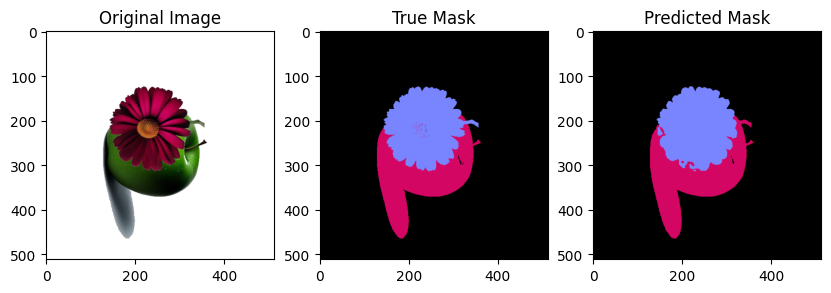

image257 IOU_apple: 0.9458717563800129
image257 IOU_flower: 0.951973556290103
image257 IOU_back: 0.9988018145283485


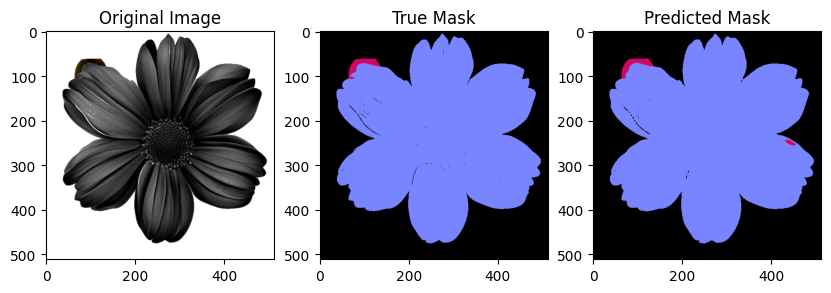

image258 IOU_apple: 0.7957153787299158
image258 IOU_flower: 0.9946661467436338
image258 IOU_back: 0.9955003050640635


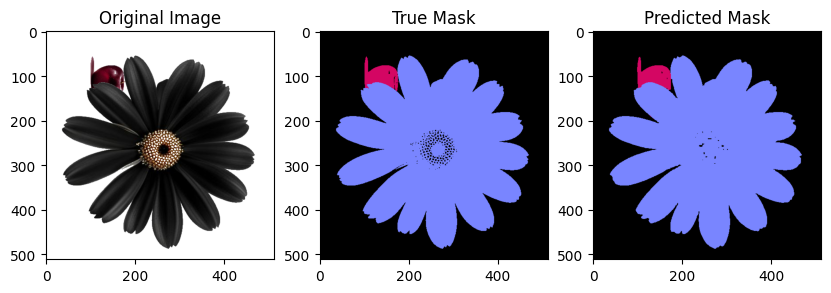

image259 IOU_apple: 0.9552517091361094
image259 IOU_flower: 0.9844401461422738
image259 IOU_back: 0.9871699941178506


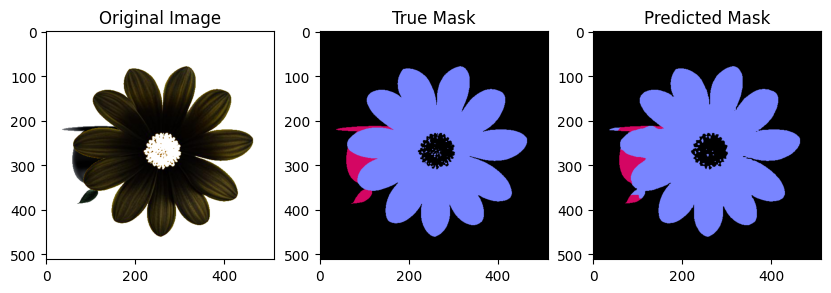

image260 IOU_apple: 0.804177545691906
image260 IOU_flower: 0.9837503167311146
image260 IOU_back: 0.9953327417923691


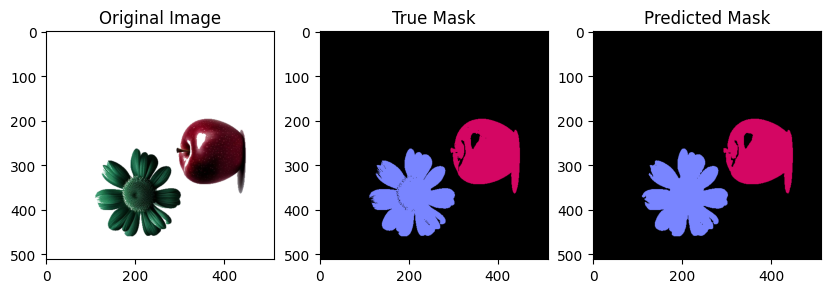

image261 IOU_apple: 0.9888086443574619
image261 IOU_flower: 0.9789482655757266
image261 IOU_back: 0.9968495181616012


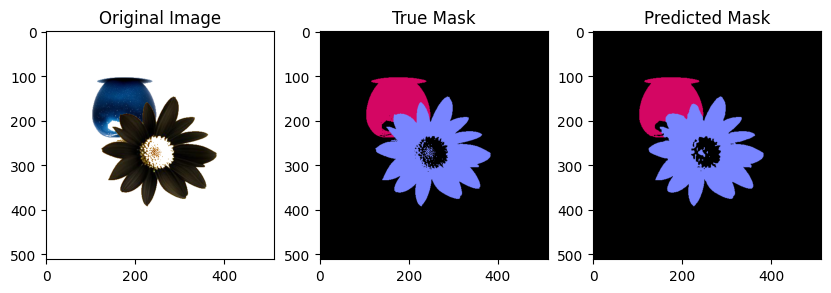

image262 IOU_apple: 0.9626531964226565
image262 IOU_flower: 0.9629335370511841
image262 IOU_back: 0.9951715339981619


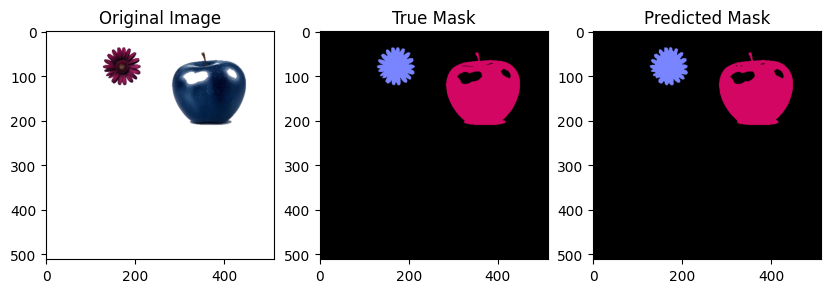

image263 IOU_apple: 0.9910905968226706
image263 IOU_flower: 0.967683296303777
image263 IOU_back: 0.998635338046859


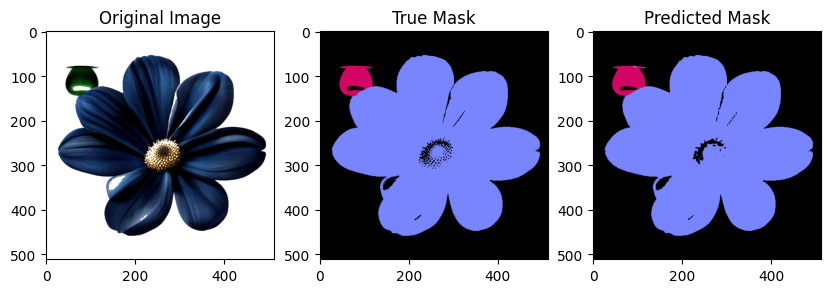

image264 IOU_apple: 0.9650631550658425
image264 IOU_flower: 0.988581771432438
image264 IOU_back: 0.9904383933111124


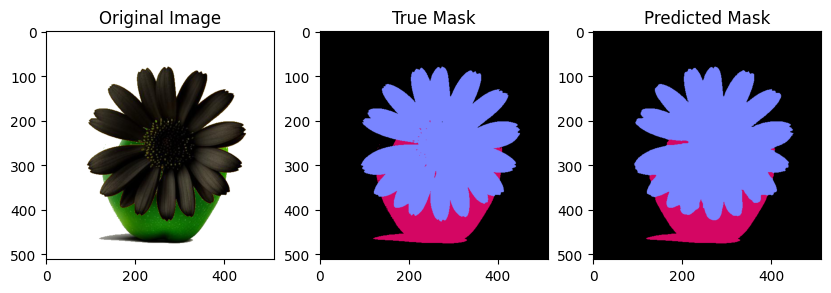

image265 IOU_apple: 0.9390369785657903
image265 IOU_flower: 0.9847042954199512
image265 IOU_back: 0.9974969313340875


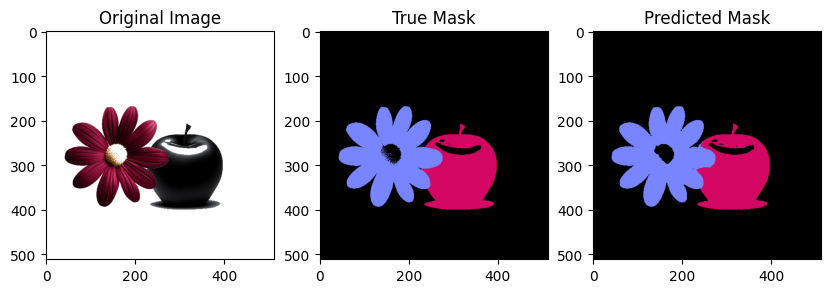

image266 IOU_apple: 0.9852829831535113
image266 IOU_flower: 0.9792657721203373
image266 IOU_back: 0.9971273887158907


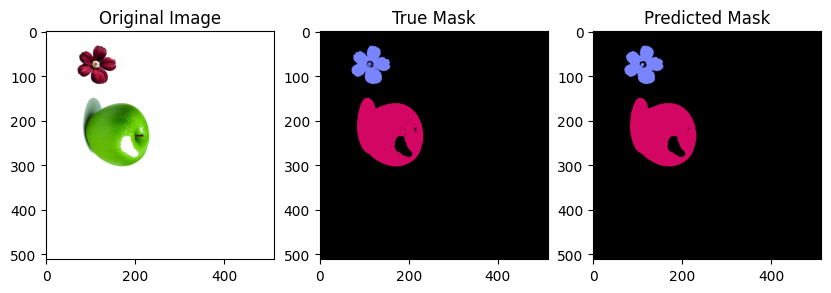

image267 IOU_apple: 0.9913022322243172
image267 IOU_flower: 0.966299416720674
image267 IOU_back: 0.9987612533299085


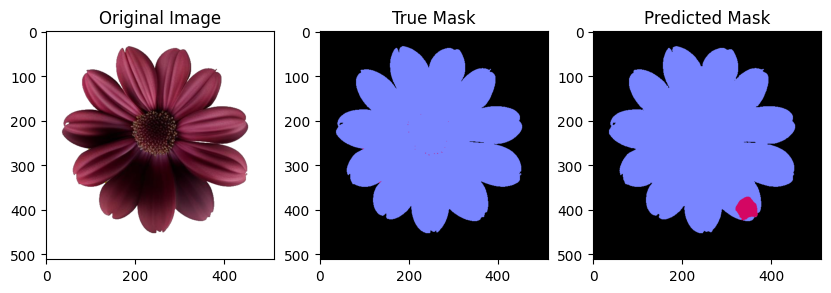

image268 IOU_apple: 1
image268 IOU_flower: 0.9809752618978895
image268 IOU_back: 0.9975260182715299


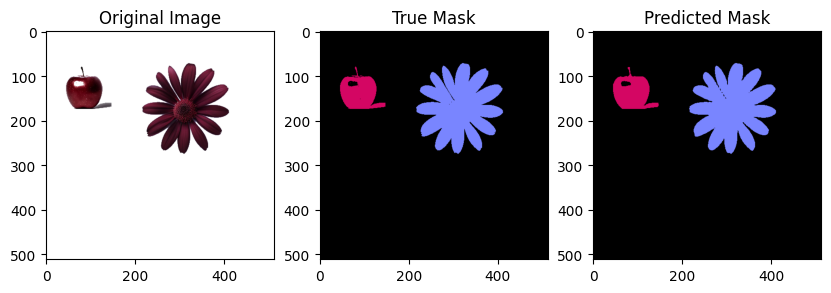

image269 IOU_apple: 0.9740686632578525
image269 IOU_flower: 0.9881060543487239
image269 IOU_back: 0.9981535871936243


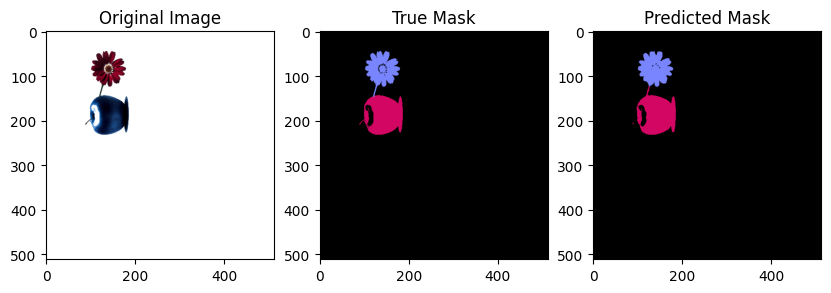

image270 IOU_apple: 0.9614637305699482
image270 IOU_flower: 0.929359305327388
image270 IOU_back: 0.9984256964409636


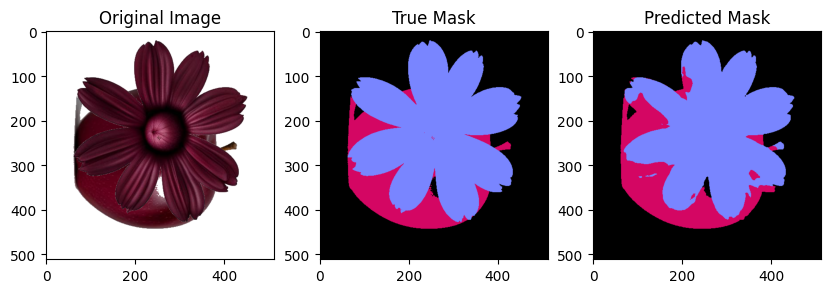

image271 IOU_apple: 0.7002099930002333
image271 IOU_flower: 0.9057272975298537
image271 IOU_back: 0.997712344435997


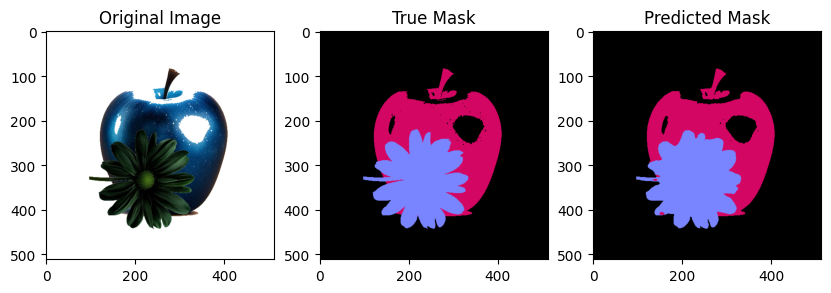

image272 IOU_apple: 0.9418924754399223
image272 IOU_flower: 0.9463868757012464
image272 IOU_back: 0.997082718062966


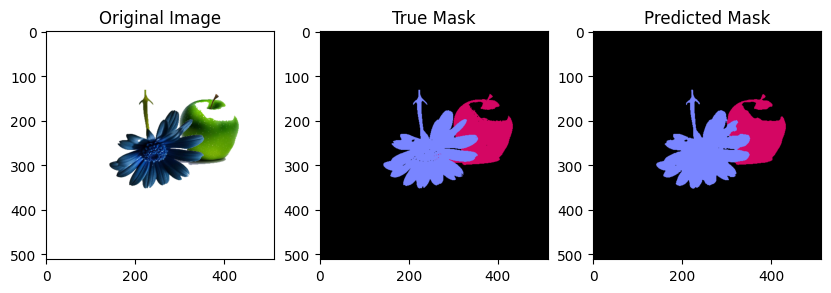

image273 IOU_apple: 0.9415629928158402
image273 IOU_flower: 0.9627370312573887
image273 IOU_back: 0.9978876965916879


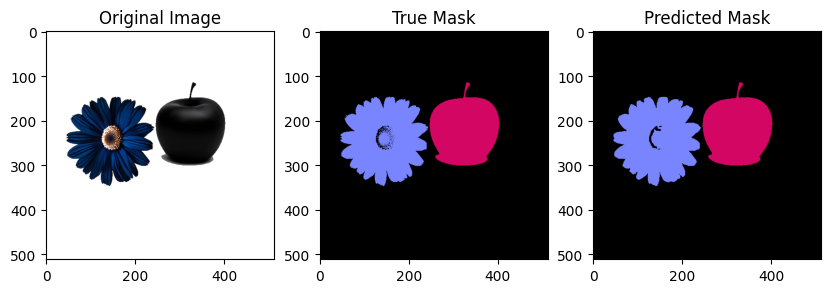

image274 IOU_apple: 0.997261092575071
image274 IOU_flower: 0.9757630813953488
image274 IOU_back: 0.9966459944719299


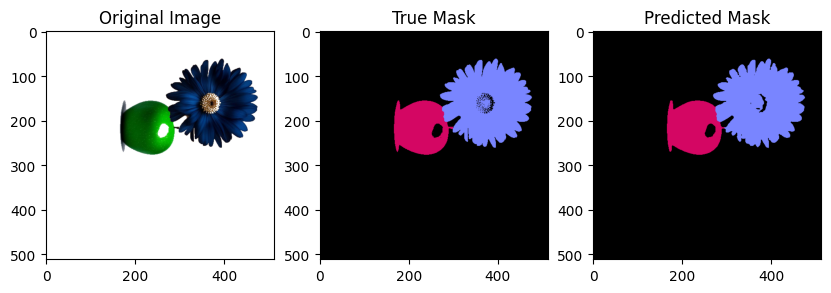

image275 IOU_apple: 0.9881929325071177
image275 IOU_flower: 0.9732683982683983
image275 IOU_back: 0.9964266843392052


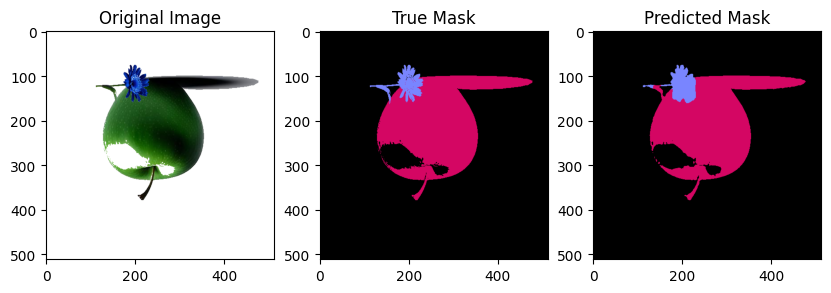

image276 IOU_apple: 0.9627293301873164
image276 IOU_flower: 0.7295042897998093
image276 IOU_back: 0.9966944194832108


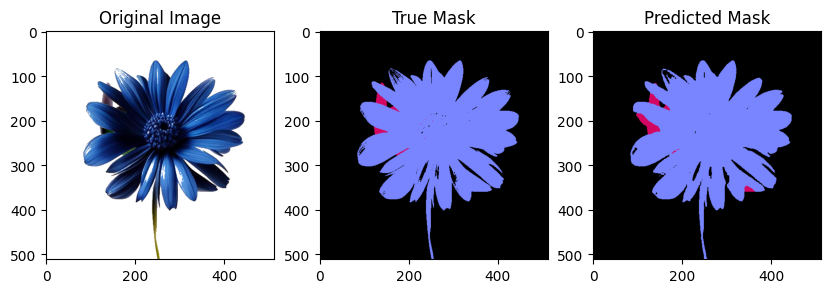

image277 IOU_apple: 0.38529259451061626
image277 IOU_flower: 0.968231449345122
image277 IOU_back: 0.9923456897583479


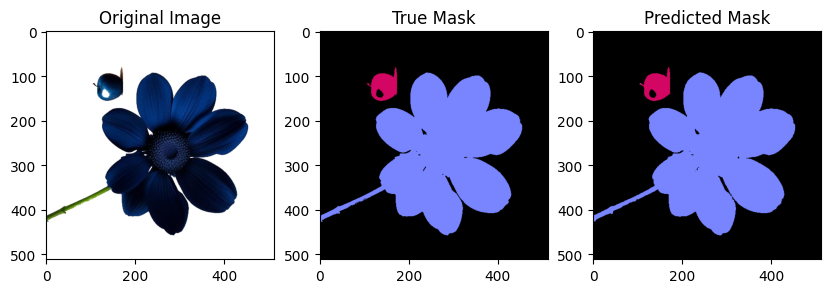

image278 IOU_apple: 0.9747759707932293
image278 IOU_flower: 0.9951220745084163
image278 IOU_back: 0.9974730962329185


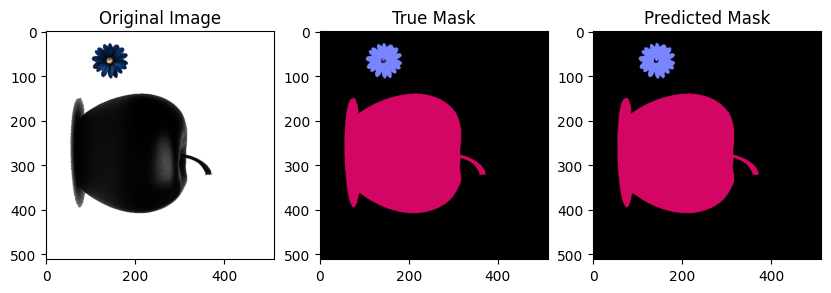

image279 IOU_apple: 0.9972204161248375
image279 IOU_flower: 0.9646739130434783
image279 IOU_back: 0.9983361742183327


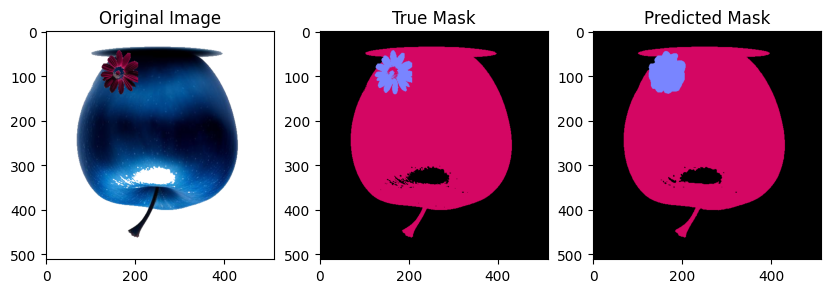

image280 IOU_apple: 0.9838880951461559
image280 IOU_flower: 0.8314459215493188
image280 IOU_back: 0.9957570488782779


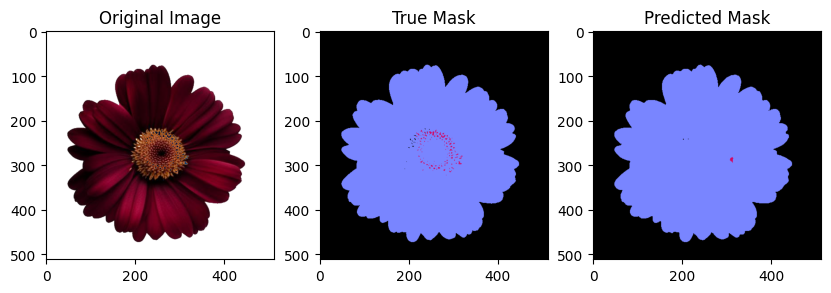

image281 IOU_apple: 0.011111111111111112
image281 IOU_flower: 0.9913061973253928
image281 IOU_back: 0.998188102990633


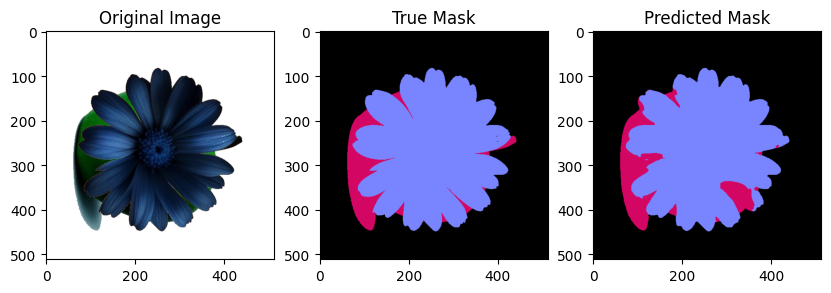

image282 IOU_apple: 0.6730648993372514
image282 IOU_flower: 0.939614046618092
image282 IOU_back: 0.9983222812077126


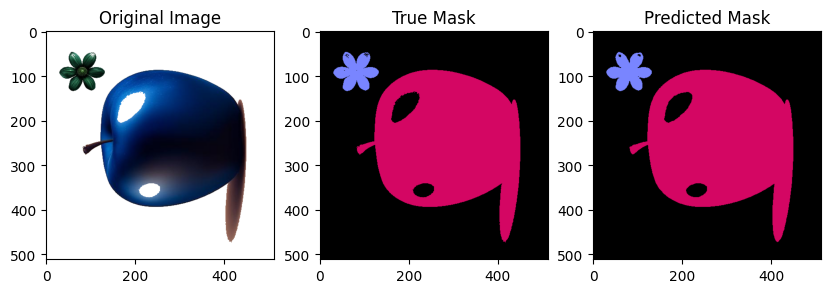

image283 IOU_apple: 0.997360389342572
image283 IOU_flower: 0.9680790423712712
image283 IOU_back: 0.997726376354314


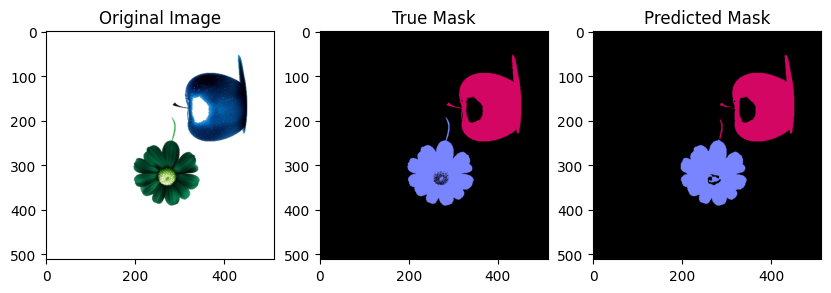

image284 IOU_apple: 0.9795906797437497
image284 IOU_flower: 0.9595791436372112
image284 IOU_back: 0.9969477646609327


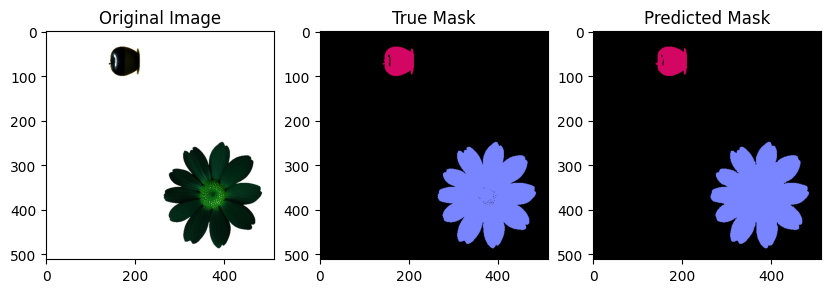

image285 IOU_apple: 0.9786039047873764
image285 IOU_flower: 0.992424928323525
image285 IOU_back: 0.9985328079219506


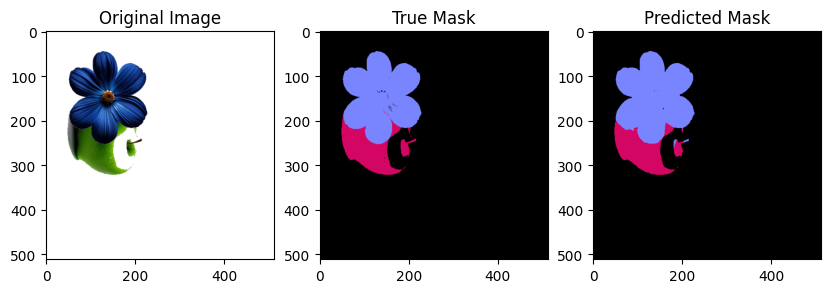

image286 IOU_apple: 0.9400529918304261
image286 IOU_flower: 0.979733206665875
image286 IOU_back: 0.998385367667972


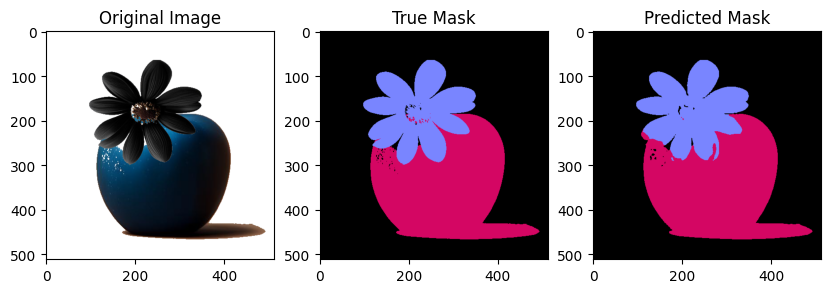

image287 IOU_apple: 0.9609620132197181
image287 IOU_flower: 0.9289683221630292
image287 IOU_back: 0.9962266633179051


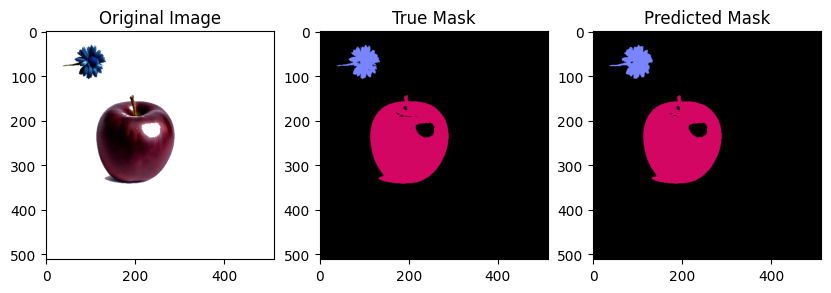

image288 IOU_apple: 0.9932909466786285
image288 IOU_flower: 0.9351720216093261
image288 IOU_back: 0.9982861305111616


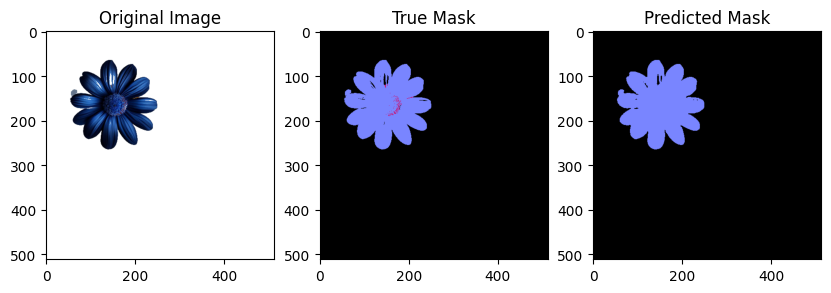

image289 IOU_apple: 1
image289 IOU_flower: 0.9751204171808447
image289 IOU_back: 0.9982647809496534


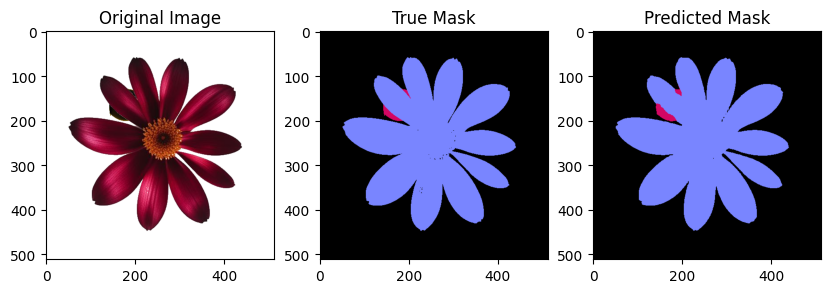

image290 IOU_apple: 0.5954500494559841
image290 IOU_flower: 0.990620988065237
image290 IOU_back: 0.9974246079274841


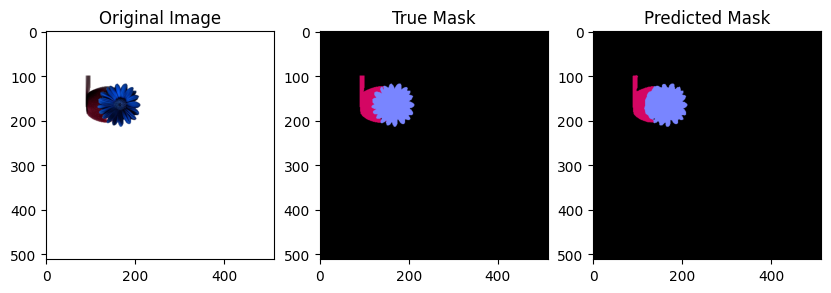

image291 IOU_apple: 0.9097370291400142
image291 IOU_flower: 0.9542040936533648
image291 IOU_back: 0.9995452370501307


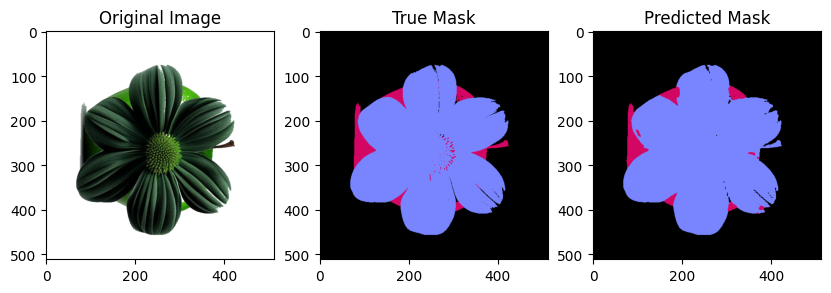

image292 IOU_apple: 0.6936390532544379
image292 IOU_flower: 0.9731889085334468
image292 IOU_back: 0.9967186461596886


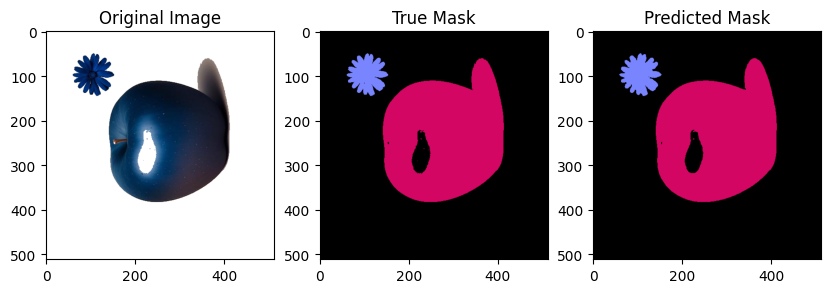

image293 IOU_apple: 0.9975061945487971
image293 IOU_flower: 0.9690776612759907
image293 IOU_back: 0.9983015255388796


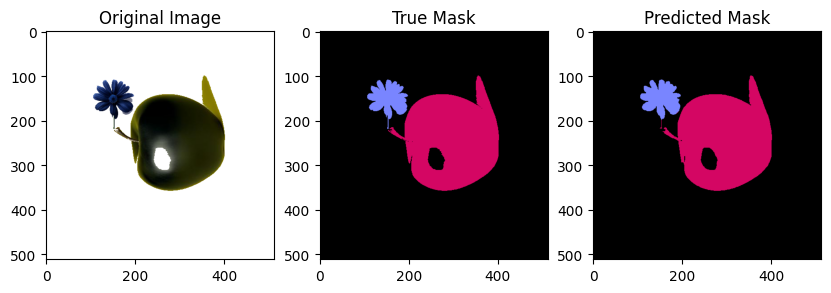

image294 IOU_apple: 0.9924827839983178
image294 IOU_flower: 0.9607580398162328
image294 IOU_back: 0.9980258598679651


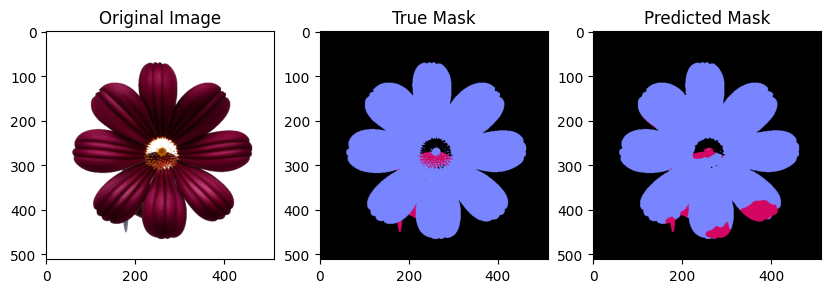

image295 IOU_apple: 0.11670020120724346
image295 IOU_flower: 0.9387411883182276
image295 IOU_back: 0.9970096172186979


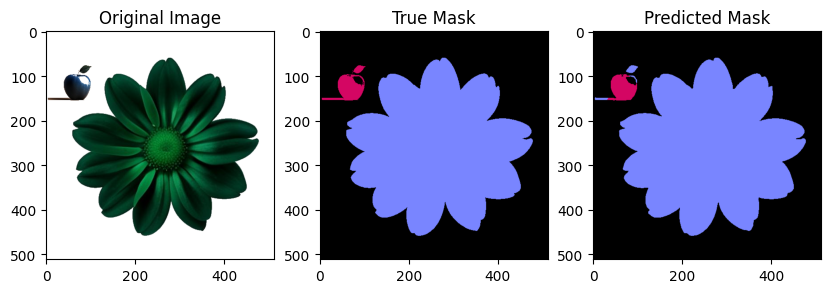

image296 IOU_apple: 0.8069137340392402
image296 IOU_flower: 0.9932189239332097
image296 IOU_back: 0.997611684979275


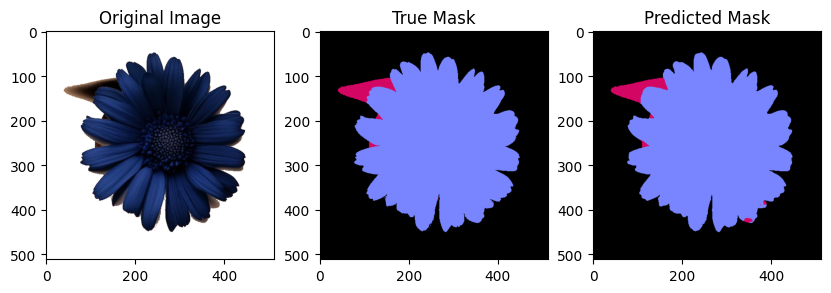

image297 IOU_apple: 0.8812466415905427
image297 IOU_flower: 0.9915083407180906
image297 IOU_back: 0.9965785341316754


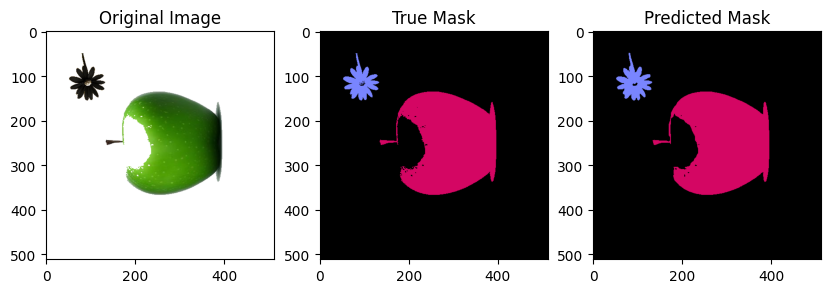

image298 IOU_apple: 0.9894728654030648
image298 IOU_flower: 0.953018372703412
image298 IOU_back: 0.9973451568399652


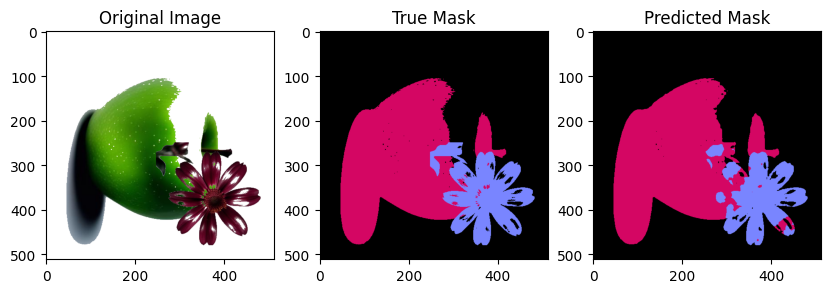

image299 IOU_apple: 0.9335298811246501
image299 IOU_flower: 0.8019181991122384
image299 IOU_back: 0.9929326315414696


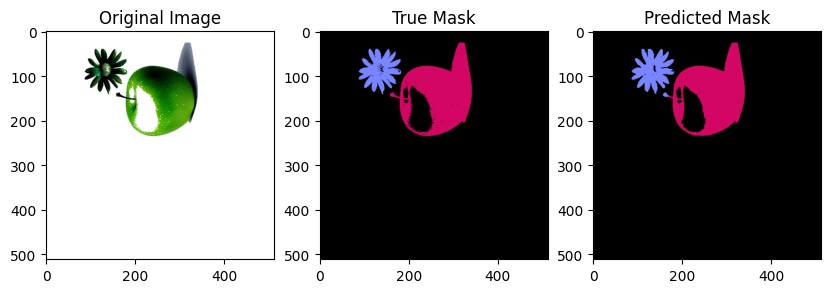

image300 IOU_apple: 0.9702898173682294
image300 IOU_flower: 0.9298650568181818
image300 IOU_back: 0.9966662887900811


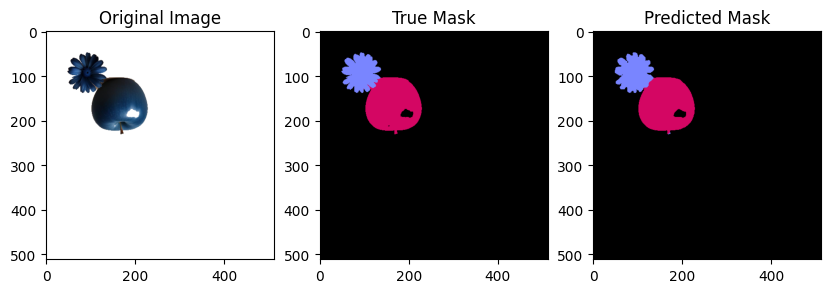

image301 IOU_apple: 0.9881118307780602
image301 IOU_flower: 0.9598644309668213
image301 IOU_back: 0.9991415642334782


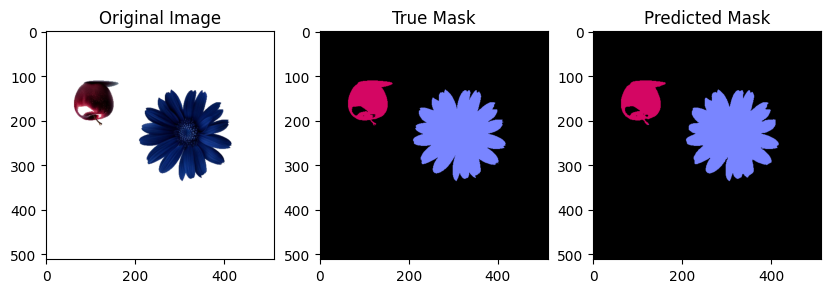

image302 IOU_apple: 0.9780593325092707
image302 IOU_flower: 0.9910562948537632
image302 IOU_back: 0.9983182236237025


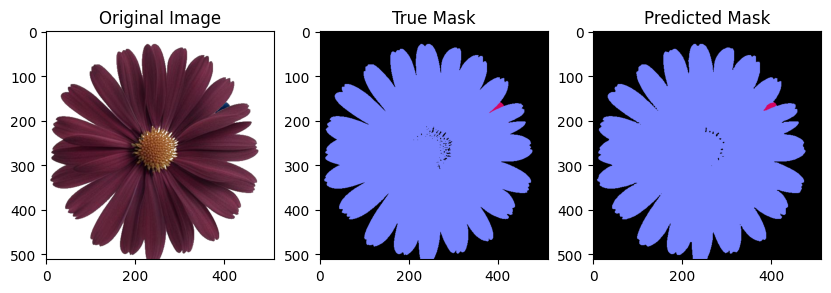

image303 IOU_apple: 0.5359477124183006
image303 IOU_flower: 0.9932840446537545
image303 IOU_back: 0.9913815789473684


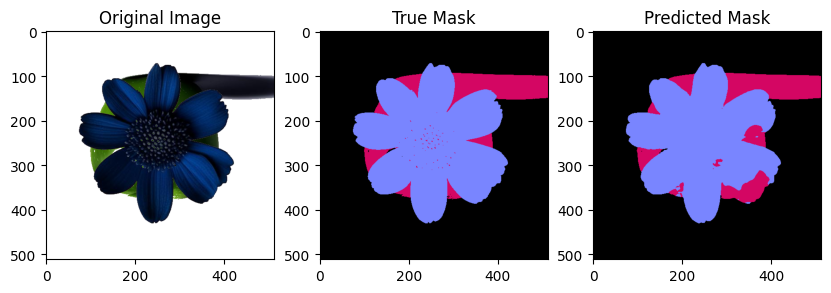

image304 IOU_apple: 0.7360638699924414
image304 IOU_flower: 0.9262064800714174
image304 IOU_back: 0.998416821564063


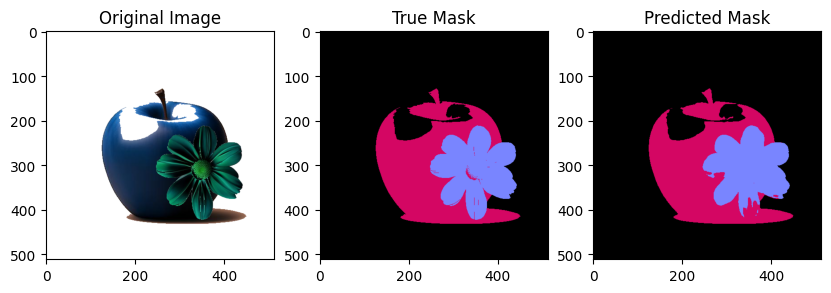

image305 IOU_apple: 0.9350652431791222
image305 IOU_flower: 0.904120443740095
image305 IOU_back: 0.9980609951195804


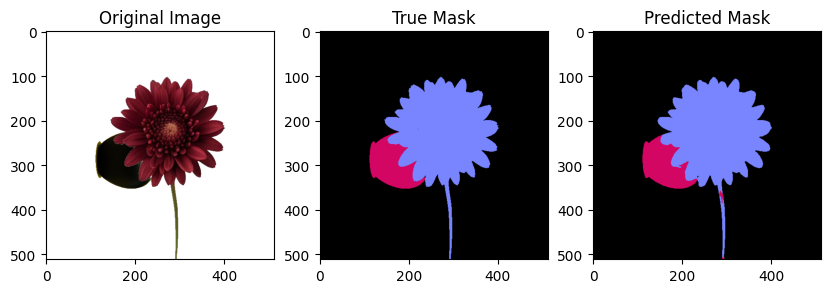

image306 IOU_apple: 0.9426413312876195
image306 IOU_flower: 0.9841082308244724
image306 IOU_back: 0.9986555067414028


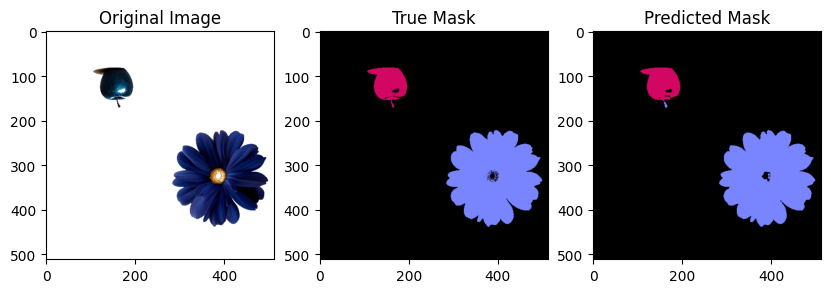

image307 IOU_apple: 0.9629396984924623
image307 IOU_flower: 0.9857379971721891
image307 IOU_back: 0.9976000887213042


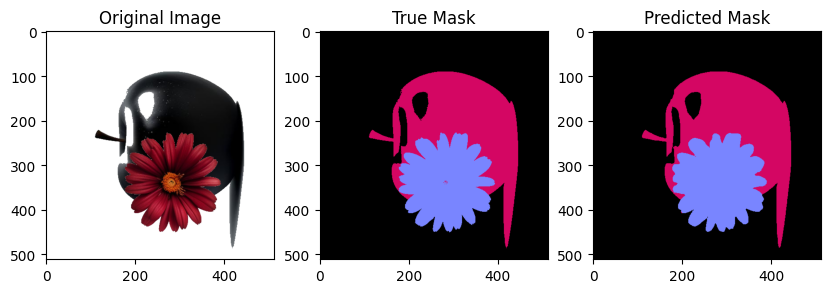

image308 IOU_apple: 0.9776238790889572
image308 IOU_flower: 0.9715473522821088
image308 IOU_back: 0.9979990984949263


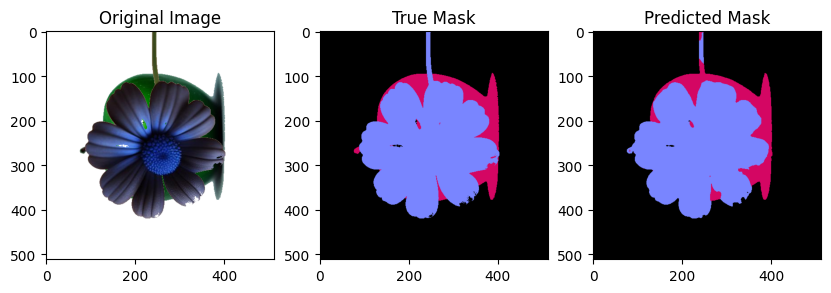

image309 IOU_apple: 0.8253239740820735
image309 IOU_flower: 0.9599555895635474
image309 IOU_back: 0.9980543262627805


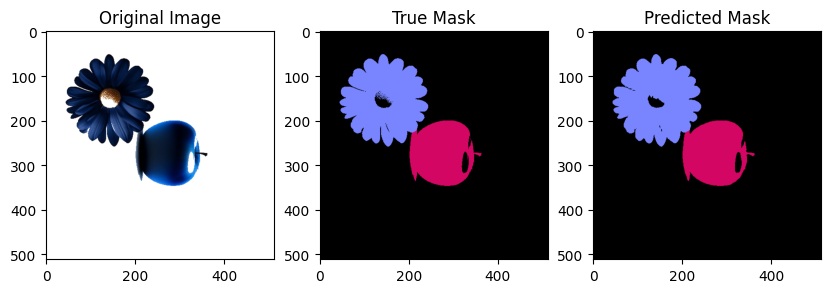

image310 IOU_apple: 0.990364277320799
image310 IOU_flower: 0.9837775202780996
image310 IOU_back: 0.997249144942553


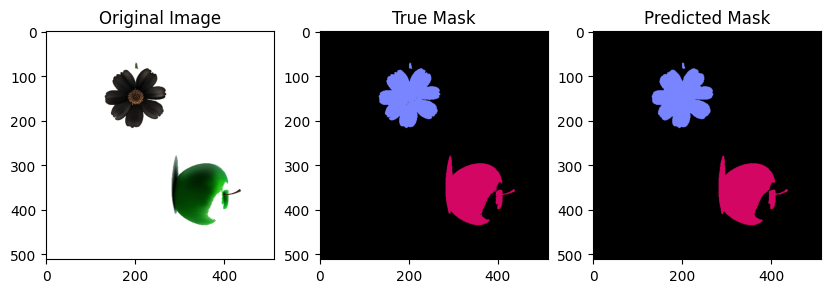

image311 IOU_apple: 0.9877021688902139
image311 IOU_flower: 0.9878499302191939
image311 IOU_back: 0.9986785387086832


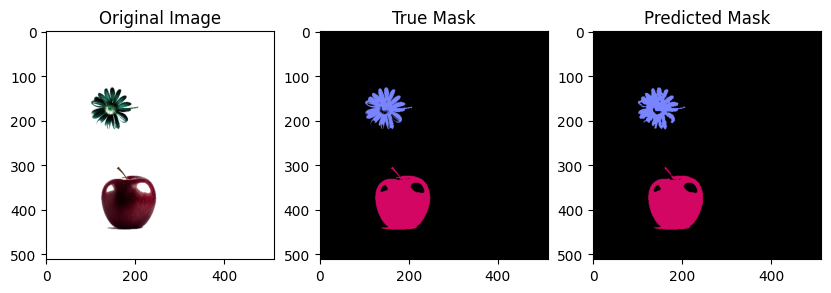

image312 IOU_apple: 0.9879764645689435
image312 IOU_flower: 0.8941932969602494
image312 IOU_back: 0.9972191617642874


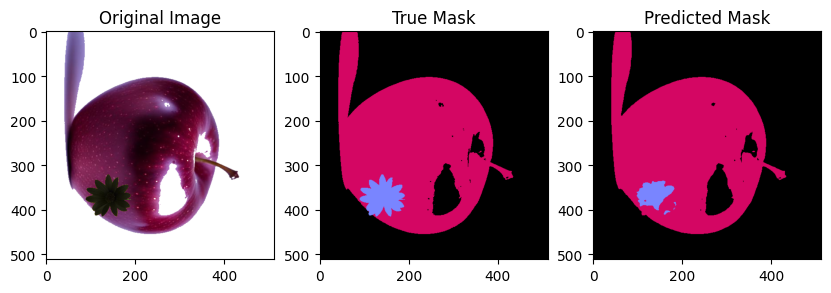

image313 IOU_apple: 0.9662286339540862
image313 IOU_flower: 0.5529021558872305
image313 IOU_back: 0.9970513798573521


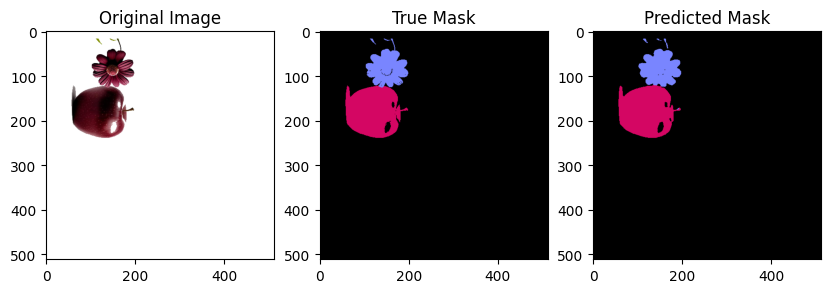

image314 IOU_apple: 0.9809035080339867
image314 IOU_flower: 0.9499325691166555
image314 IOU_back: 0.9983332720565707


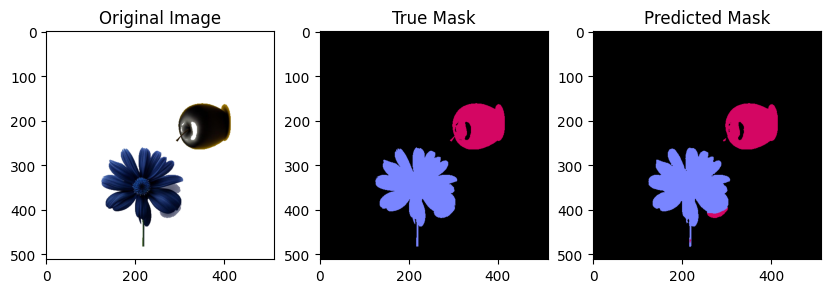

image315 IOU_apple: 0.9464548396587231
image315 IOU_flower: 0.967821662224376
image315 IOU_back: 0.9983111674055309


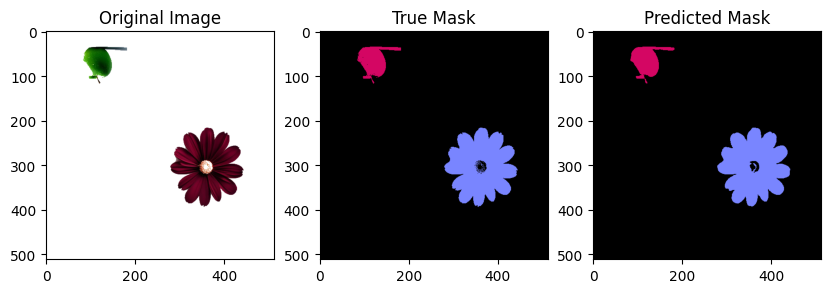

image316 IOU_apple: 0.9685517970401691
image316 IOU_flower: 0.9809599575709361
image316 IOU_back: 0.9980081922469508


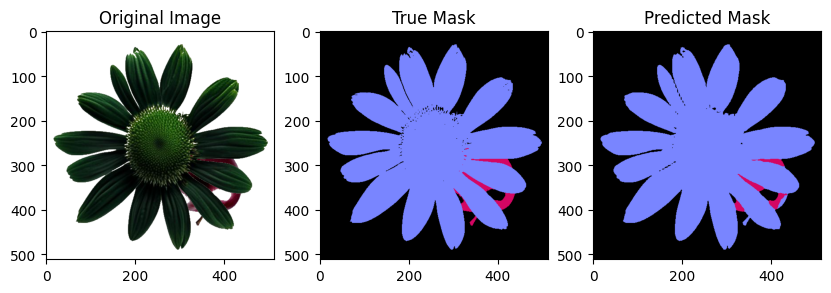

image317 IOU_apple: 0.6627865961199294
image317 IOU_flower: 0.9827281615011234
image317 IOU_back: 0.99209726443769


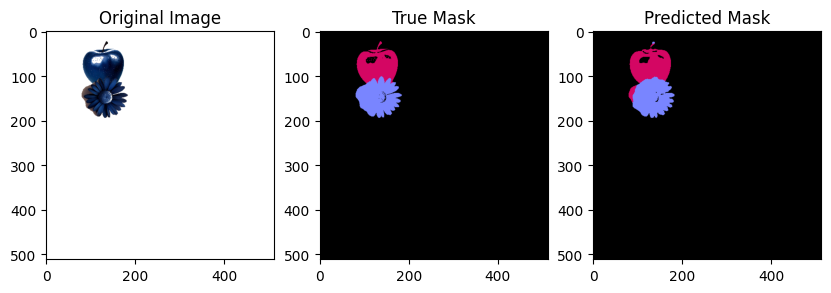

image318 IOU_apple: 0.871965811965812
image318 IOU_flower: 0.8994523881959233
image318 IOU_back: 0.9983242563887725


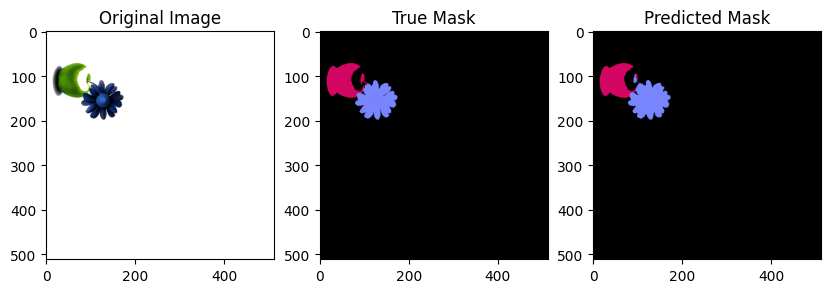

image319 IOU_apple: 0.9466487334678323
image319 IOU_flower: 0.949600709849157
image319 IOU_back: 0.9989462926137489


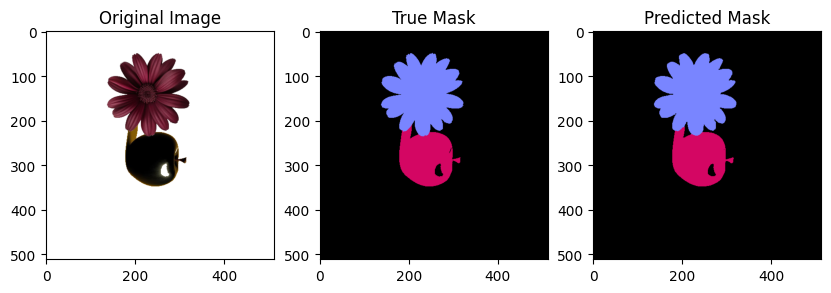

image320 IOU_apple: 0.9860910114166265
image320 IOU_flower: 0.9890736548842068
image320 IOU_back: 0.9986525700245268


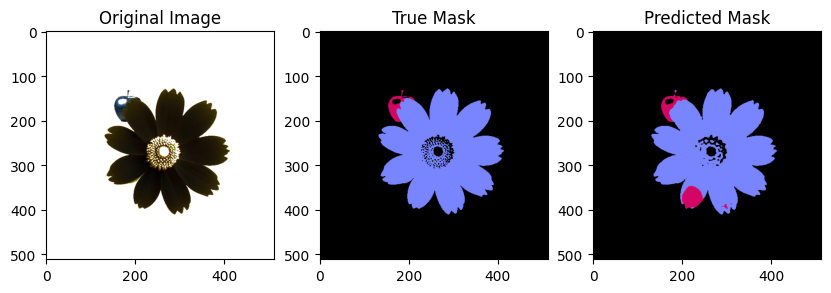

image321 IOU_apple: 0.3300570703868104
image321 IOU_flower: 0.9312397164273091
image321 IOU_back: 0.9932373810562254


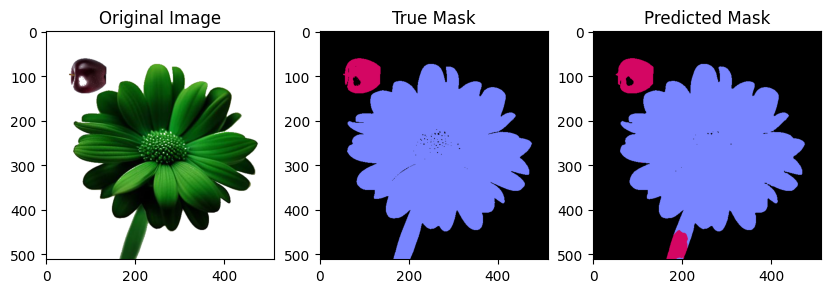

image322 IOU_apple: 0.6857497585873914
image322 IOU_flower: 0.9753609600600037
image322 IOU_back: 0.996290604631445


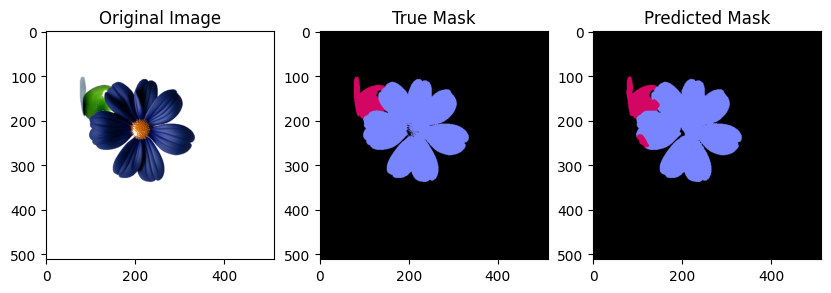

image323 IOU_apple: 0.8216057735678846
image323 IOU_flower: 0.970718901453958
image323 IOU_back: 0.9983313702394975


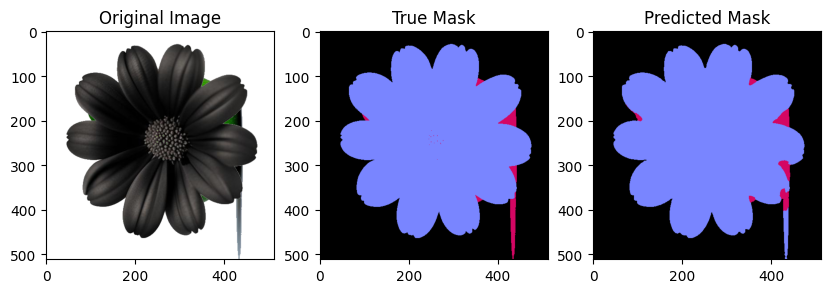

image324 IOU_apple: 0.47040252565114443
image324 IOU_flower: 0.9831813967861558
image324 IOU_back: 0.9980933932262075


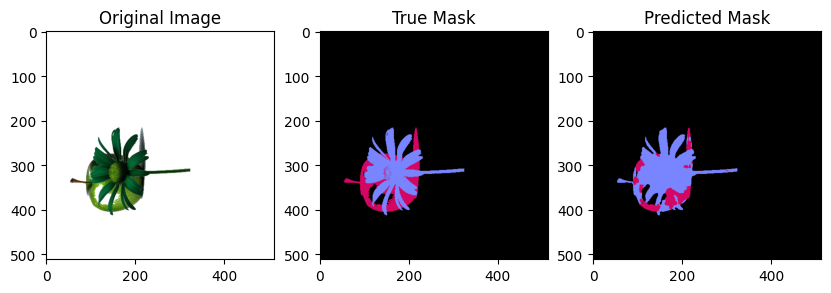

image325 IOU_apple: 0.36636085626911313
image325 IOU_flower: 0.7403266331658291
image325 IOU_back: 0.9981233507613132


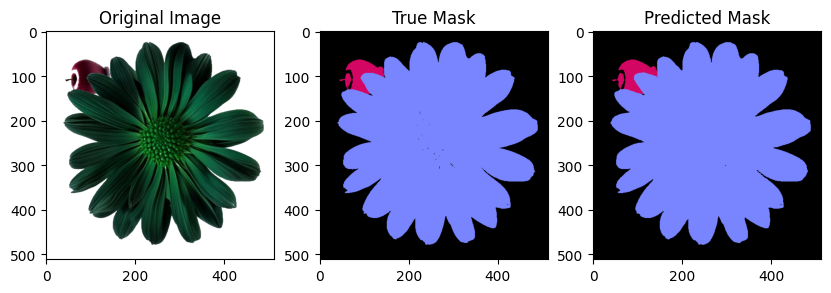

image326 IOU_apple: 0.9503871522798968
image326 IOU_flower: 0.9962275332258927
image326 IOU_back: 0.995657424563261


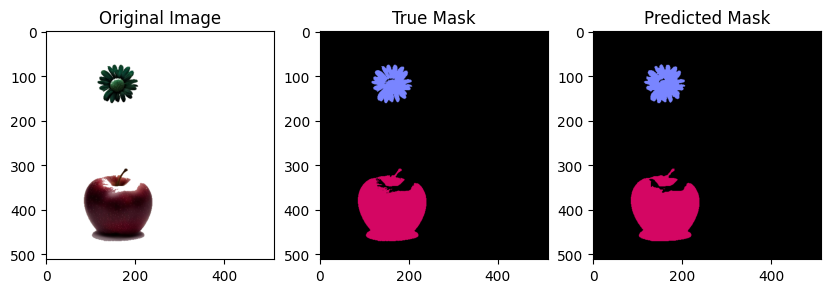

image327 IOU_apple: 0.9870040648079235
image327 IOU_flower: 0.9613499245852187
image327 IOU_back: 0.9981985363107525


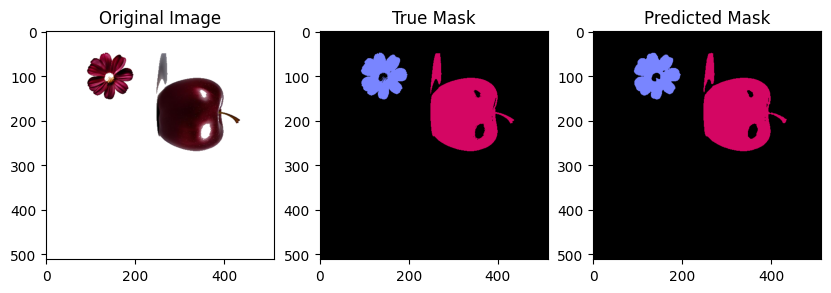

image328 IOU_apple: 0.9892891038098252
image328 IOU_flower: 0.9752292322430546
image328 IOU_back: 0.9982069935829244


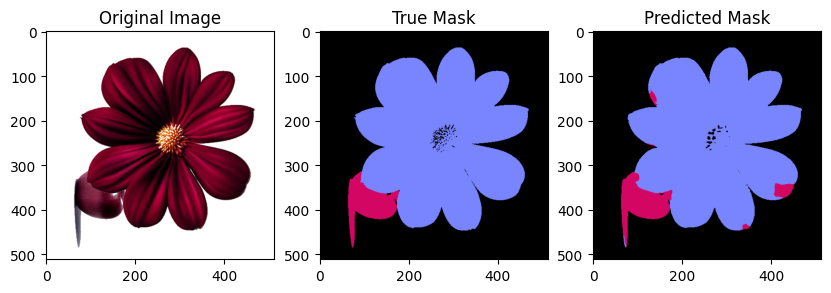

image329 IOU_apple: 0.7935821345941052
image329 IOU_flower: 0.9748484457629305
image329 IOU_back: 0.994169812737662


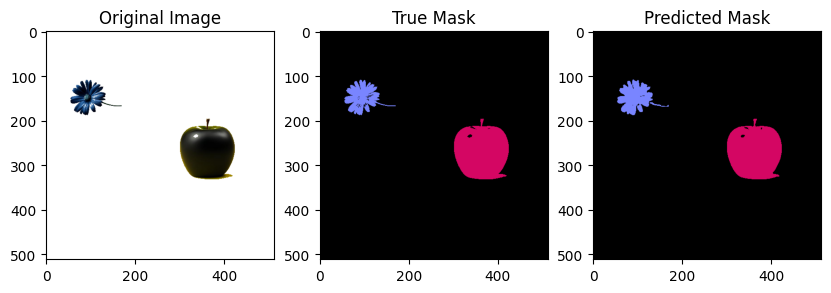

image330 IOU_apple: 0.9920107577914887
image330 IOU_flower: 0.9137152365105776
image330 IOU_back: 0.998111971484259


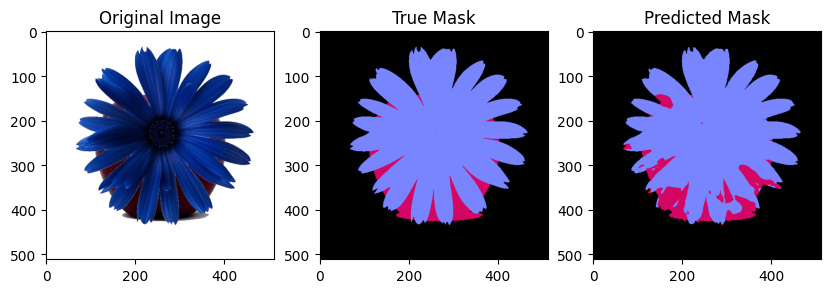

image331 IOU_apple: 0.4071716062934504
image331 IOU_flower: 0.9150770172396205
image331 IOU_back: 0.9967153904721154


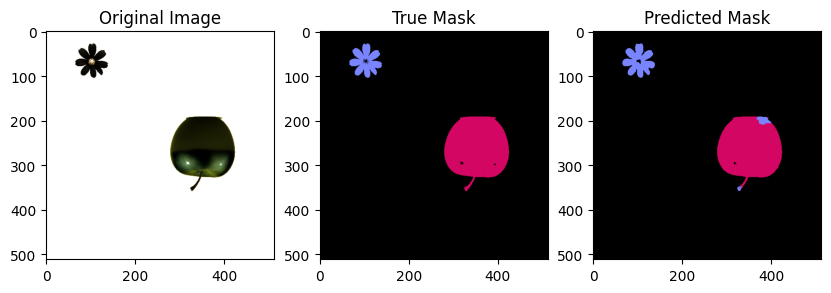

image332 IOU_apple: 0.9673983787941542
image332 IOU_flower: 0.8361355751267681
image332 IOU_back: 0.9990297114733522

 MIOU_apple: 0.84812081289847

 MIOU_flower: 0.9452620346107337

 MIOU_back: 0.9969840828188482

 MIOU for all classes: 0.9301223101093505


In [61]:
arr_apple, arr_flower, arr_back = [], [], []

IOU_sum_apple = 0
IOU_sum_flower = 0
IOU_sum_back = 0

def claculate_IOU(true_mask, pred_mask, color):
    TP = 0 
    FP = 0
    FN = 0
    for k in range(true_mask.shape[0]):
        for l in range(true_mask.shape[1]):
            if (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) == color): 
                TP+=1
            elif (list(true_mask[k, l]) != color) and (list(pred_mask[k, l]) == color): 
                FP+=1
            elif (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) != color): 
                FN+=1

    if TP+FP+FN == 0: IOU = 1
    else: IOU = TP/(TP+FP+FN) 
    if IOU == 0: IOU = 1
    return IOU
    
for i in range(NUM_TEST_IMAGES):
    img = cv2.imread(test_images[i])
    true_mask = cv2.imread(mask_color[i])
    pred_mask = cv2.imread(test_pred[i])

    IOU_apple = claculate_IOU(true_mask, pred_mask, [99, 6, 212])
    IOU_flower = claculate_IOU(true_mask, pred_mask, [255, 133, 121])
    IOU_back = claculate_IOU(true_mask, pred_mask, [0, 0, 0])
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    true_mask = cv2.cvtColor(true_mask, cv2.COLOR_BGR2RGB)
    pred_mask = cv2.cvtColor(pred_mask, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))
    axs[0].imshow(img)
    axs[0].set_title('Original Image')
    axs[1].imshow(true_mask)
    axs[1].set_title('True Mask')
    axs[2].imshow(pred_mask)
    axs[2].set_title('Predicted Mask')
    plt.show()
    
    print(f"image{i} IOU_apple: {IOU_apple}")
    print(f"image{i} IOU_flower: {IOU_flower}")
    print(f"image{i} IOU_back: {IOU_back}")

    arr_apple.append(IOU_apple)
    arr_flower.append(IOU_flower)
    arr_back.append(IOU_back)
    IOU_sum_apple += IOU_apple
    IOU_sum_flower += IOU_flower
    IOU_sum_back += IOU_back

MIOU_apple_train = IOU_sum_apple / NUM_TEST_IMAGES
MIOU_flower_train = IOU_sum_flower / NUM_TEST_IMAGES
MIOU_back_train = IOU_sum_back / NUM_TEST_IMAGES
print(f"\n MIOU_apple: {MIOU_apple_train}")
print(f"\n MIOU_flower: {MIOU_flower_train}")
print(f"\n MIOU_back: {MIOU_back_train}")
print(f"\n MIOU for all classes: {(MIOU_apple_train+MIOU_flower_train+MIOU_back_train)/3}")

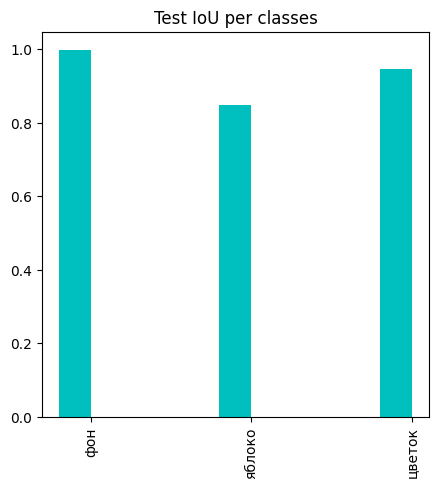

IOU фон: 0.9969840828188482, IOU яблоко: 0.84812081289847, IOU цветок: 0.9452620346107337


In [64]:
suma = 0
sumf = 0
sumb = 0
for i in range(333):
    suma += arr_apple[i]
    sumf += arr_flower[i]
    sumb += arr_back[i]


values = [sumb/333, suma/333, sumf/333]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (5, 5))
plt.title('Test IoU per classes')
plt.bar(x_axis-0.1, values, width=0.2, color='c')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.show()

print(f"IOU фон: {sumb/333}, IOU яблоко: {suma/333}, IOU цветок: {sumf/333}")

In [69]:
oimg = sorted(glob(os.path.join(DATA_DIR, "img_test/*")))
mtrue = sorted(glob(os.path.join(DATA_DIR, "mask_true/*")))
mpred = sorted(glob(os.path.join(DATA_DIR, "mask_predict/*")))

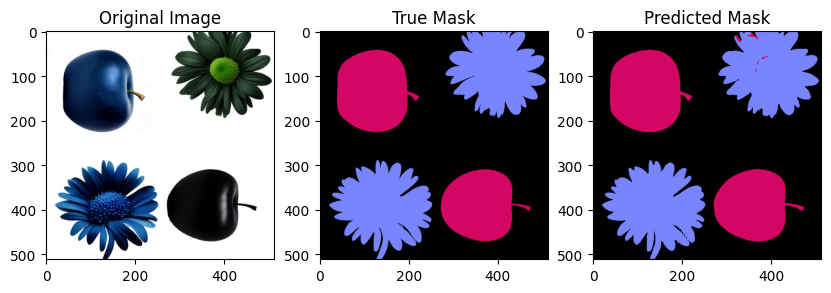

image0 IOU_apple: 0.9727398573101906
image0 IOU_flower: 0.9534068466096116
image0 IOU_back: 0.989309093726194


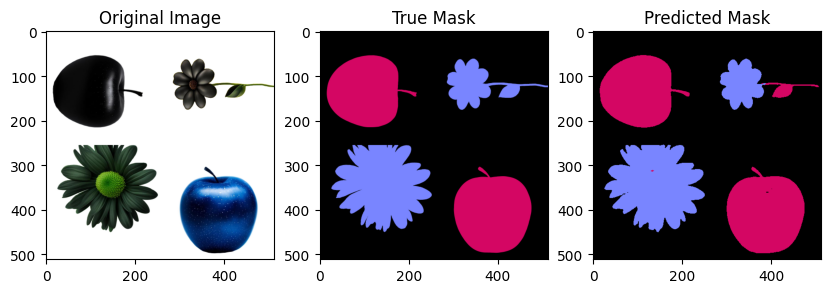

image1 IOU_apple: 0.9458096384541945
image1 IOU_flower: 0.9261332851724761
image1 IOU_back: 0.9909858963773935


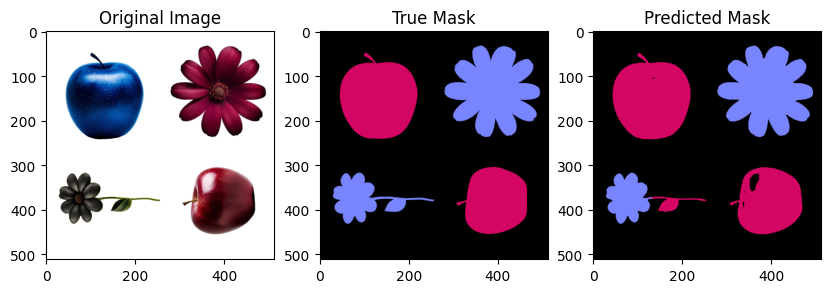

image2 IOU_apple: 0.9242038360116297
image2 IOU_flower: 0.9367429699589136
image2 IOU_back: 0.9851541244929575


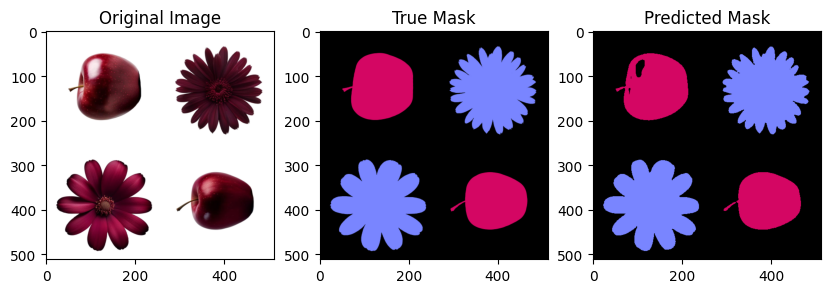

image3 IOU_apple: 0.9457913789432056
image3 IOU_flower: 0.9639646333308567
image3 IOU_back: 0.9856197888030472


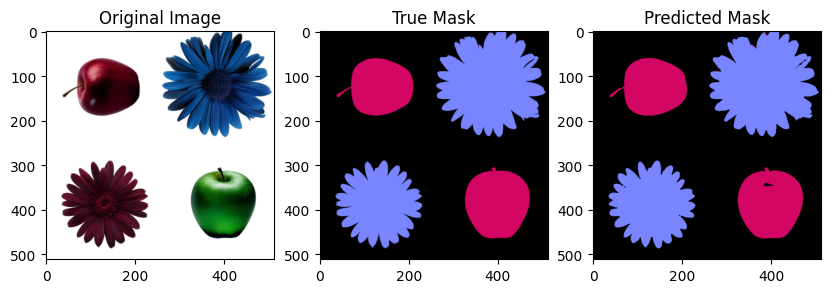

image4 IOU_apple: 0.9674126423243031
image4 IOU_flower: 0.9630946334856949
image4 IOU_back: 0.9887628828346495


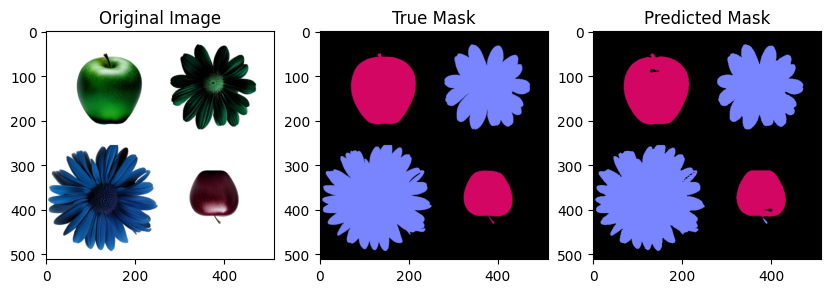

image5 IOU_apple: 0.963837959272411
image5 IOU_flower: 0.9671666433032724
image5 IOU_back: 0.9898582736215513


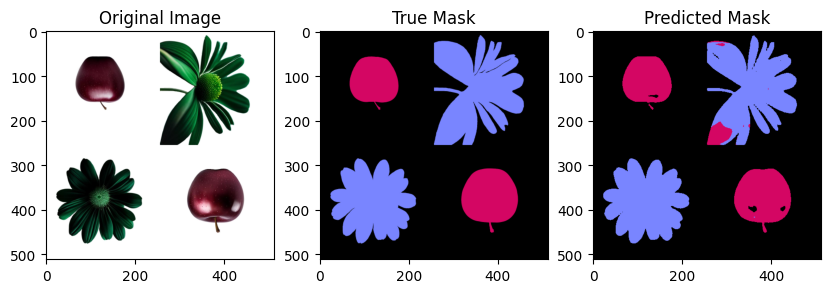

image6 IOU_apple: 0.8640336678536743
image6 IOU_flower: 0.9250581678480602
image6 IOU_back: 0.9861837939637305


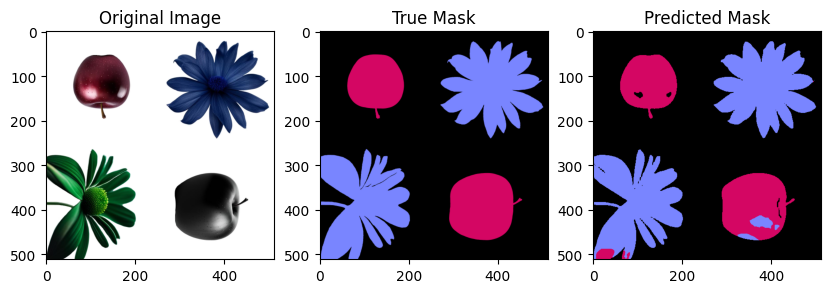

image7 IOU_apple: 0.882060054372728
image7 IOU_flower: 0.9173094025386046
image7 IOU_back: 0.9835713449607866


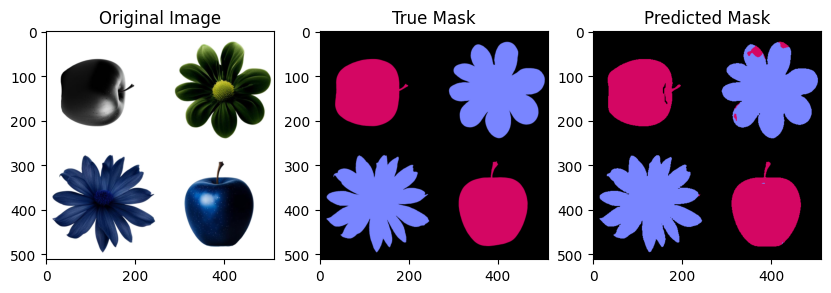

image8 IOU_apple: 0.9425767488676396
image8 IOU_flower: 0.9501033816920422
image8 IOU_back: 0.9893841730972915


IndexError: list index out of range

In [70]:
arr_apple, arr_flower, arr_back = [], [], []

IOU_sum_apple = 0
IOU_sum_flower = 0
IOU_sum_back = 0

def claculate_IOU(true_mask, pred_mask, color):
    TP = 0 
    FP = 0
    FN = 0
    for k in range(true_mask.shape[0]):
        for l in range(true_mask.shape[1]):
            if (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) == color): 
                TP+=1
            elif (list(true_mask[k, l]) != color) and (list(pred_mask[k, l]) == color): 
                FP+=1
            elif (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) != color): 
                FN+=1

    if TP+FP+FN == 0: IOU = 1
    else: IOU = TP/(TP+FP+FN) 
    if IOU == 0: IOU = 1
    return IOU
    
for i in range(len(oimg)):
    img = cv2.imread(oimg[i])
    true_mask = cv2.imread(mtrue[i])
    pred_mask = cv2.imread(mpred[i])

    IOU_apple = claculate_IOU(true_mask, pred_mask, [99, 6, 212])
    IOU_flower = claculate_IOU(true_mask, pred_mask, [255, 133, 121])
    IOU_back = claculate_IOU(true_mask, pred_mask, [0, 0, 0])
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    true_mask = cv2.cvtColor(true_mask, cv2.COLOR_BGR2RGB)
    pred_mask = cv2.cvtColor(pred_mask, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))
    axs[0].imshow(img)
    axs[0].set_title('Original Image')
    axs[1].imshow(true_mask)
    axs[1].set_title('True Mask')
    axs[2].imshow(pred_mask)
    axs[2].set_title('Predicted Mask')
    plt.show()
    
    print(f"image{i} IOU_apple: {IOU_apple}")
    print(f"image{i} IOU_flower: {IOU_flower}")
    print(f"image{i} IOU_back: {IOU_back}")

    arr_apple.append(IOU_apple)
    arr_flower.append(IOU_flower)
    arr_back.append(IOU_back)
    IOU_sum_apple += IOU_apple
    IOU_sum_flower += IOU_flower
    IOU_sum_back += IOU_back

MIOU_apple_train = IOU_sum_apple / NUM_TEST_IMAGES
MIOU_flower_train = IOU_sum_flower / NUM_TEST_IMAGES
MIOU_back_train = IOU_sum_back / NUM_TEST_IMAGES
print(f"\n MIOU_apple: {MIOU_apple_train}")
print(f"\n MIOU_flower: {MIOU_flower_train}")
print(f"\n MIOU_back: {MIOU_back_train}")
print(f"\n MIOU for all classes: {(MIOU_apple_train+MIOU_flower_train+MIOU_back_train)/3}")

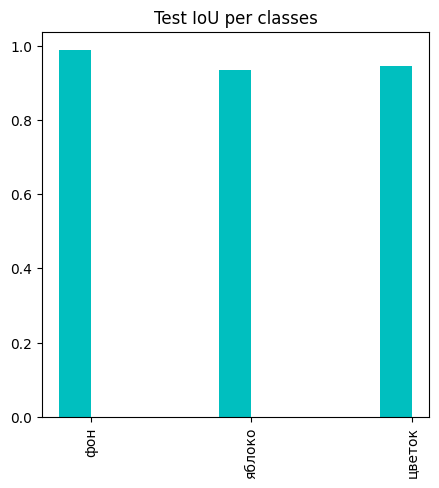

IOU фон: 0.9876477079864002, IOU яблоко: 0.9342739759344418, IOU цветок: 0.944775551548837


In [74]:
suma = 0
sumf = 0
sumb = 0
for i in range(9):
    suma += arr_apple[i]
    sumf += arr_flower[i]
    sumb += arr_back[i]


values = [sumb/9, suma/9, sumf/9]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (5, 5))
plt.title('Test IoU per classes')
plt.bar(x_axis-0.1, values, width=0.2, color='c')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.show()

print(f"IOU фон: {sumb/9}, IOU яблоко: {suma/9}, IOU цветок: {sumf/9}")